In [202]:
import platform
import sys

import numpy             as np
import pandas            as pd
import matplotlib.pyplot as plt
%matplotlib inline
plt.rcParams.update({
    'font.size'     : 16,
    'axes.grid'     : True,
    'grid.linestyle': '--'
})

import statsmodels.api  as sm
import tensorflow       as tf
import tensorflow.keras as keras

In [ ]:
df = pd.read_csv("dataTransaksi_PeDaS_2024_Train.csv")
df


,trx_code,trx_id,rek_code,rek,creationdate,type,amount,balance
0,50261,100085,1922,2526,2022-02-07 16:41:44+07:00,5,-100000.0,37.14
1,50260,100001,1922,2526,2022-02-07 16:02:58+07:00,5,-100000.0,100037.14
2,154447,775749,2346,9437,2022-03-07 08:53:06+07:00,5,-1000000.0,1679999.69
3,50285,564858,2346,9437,2022-03-03 18:41:16+07:00,1,100000.0,2609999.69
4,154240,565293,2212,5908,2022-03-03 20:22:31+07:00,1,100000.0,1200526.93
...,...,...,...,...,...,...,...,...
16610,508325,370774016,19084,15442,2024-10-16 15:35:53+07:00,5,-100000.0,55181758.78
16611,135885,370674113,14301,2673,2024-10-16 01:39:43+07:00,5,-100000.0,6400000.00
16612,506917,370676531,14301,2673,2024-10-16 02:56:55+07:00,5,-100000.0,5900000.00
16613,109215,370872339,3799,7665,2024-10-16 23:04:11+07:00,5,-100000.0,171557.59


In [204]:
df['rek'].unique()

array([ 2526,  9437,  5908,  7665,   825,  7639, 13082, 13945,  1207,
        8538,  6240,  6672,  6228,  9175,  8562, 11071,  2109,   541,
       15414, 15169, 11745, 10694, 11920, 15442, 11284,  2864, 10957,
       15923,  9210,  2673,  7977,  7354,  7638,  1734,  6376])

In [206]:
def prepare_time_series(df: pd.DataFrame) -> Dict[int, pd.DataFrame]:
    df['creationdate'] = pd.to_datetime(df['creationdate'])

    df = df.sort_values('creationdate')
    time_series_dict = {}

    for rek in df['rek'].unique():
        rek_data = df[df['rek'] == rek].copy()

        resampled_data = rek_data.set_index('creationdate').resample('W').agg({'balance': 'mean'})
        resampled_data['balance'] = resampled_data['balance'].ffill().bfill()
        time_series_dict[rek] = resampled_data

    return time_series_dict


In [207]:
time_series_dict = prepare_time_series(df)
for rek, series in time_series_dict.items():
    print(f"Rekening {rek}:\n{series}\n")

Rekening 9437:
                                balance
creationdate                           
2022-01-30 00:00:00+07:00  2.128000e+05
2022-02-06 00:00:00+07:00  1.700504e+05
2022-02-13 00:00:00+07:00  1.700504e+05
2022-02-20 00:00:00+07:00  2.356575e+06
2022-02-27 00:00:00+07:00  1.706767e+06
...                                 ...
2024-09-15 00:00:00+07:00  8.802176e+05
2024-09-22 00:00:00+07:00  5.398926e+05
2024-09-29 00:00:00+07:00  5.010176e+05
2024-10-06 00:00:00+07:00  1.421169e+06
2024-10-13 00:00:00+07:00  1.171219e+06

[142 rows x 1 columns]

Rekening 2526:
                                balance
creationdate                           
2022-01-30 00:00:00+07:00  2.000000e+05
2022-02-06 00:00:00+07:00  2.000279e+05
2022-02-13 00:00:00+07:00  5.003714e+04
2022-02-20 00:00:00+07:00  5.003714e+04
2022-02-27 00:00:00+07:00  5.003714e+04
...                                 ...
2024-09-29 00:00:00+07:00  1.900420e+06
2024-10-06 00:00:00+07:00  2.071150e+06
2024-10-13 00:00:00+07:00

Rekening 9437:



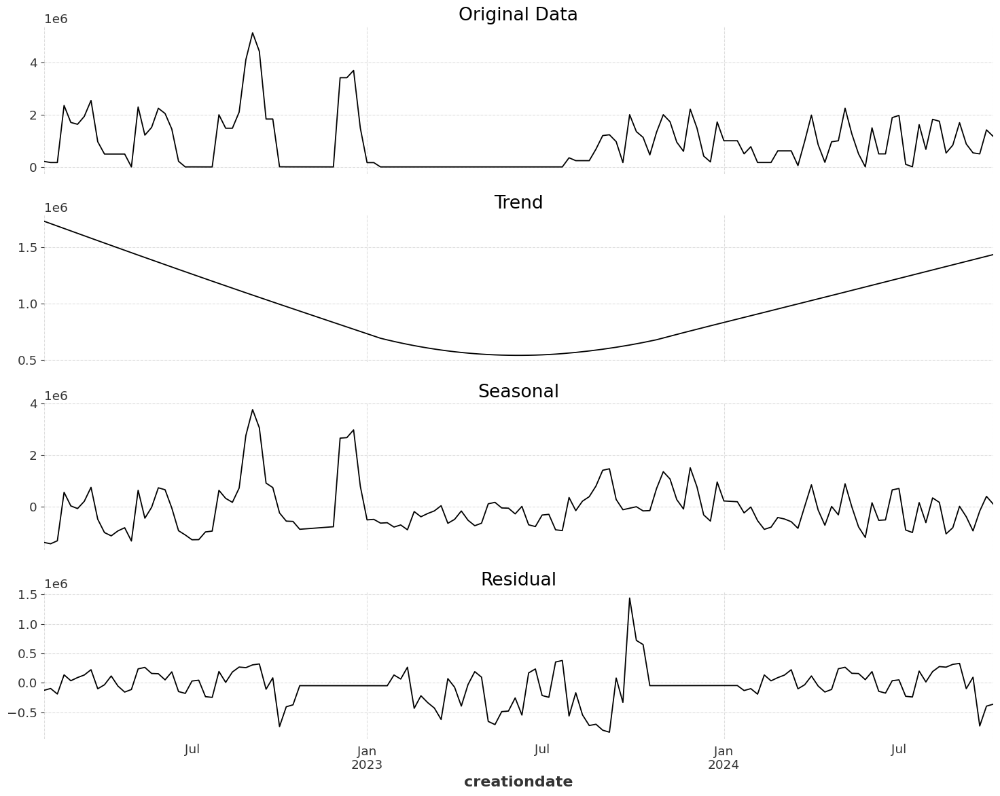

Rekening 2526:



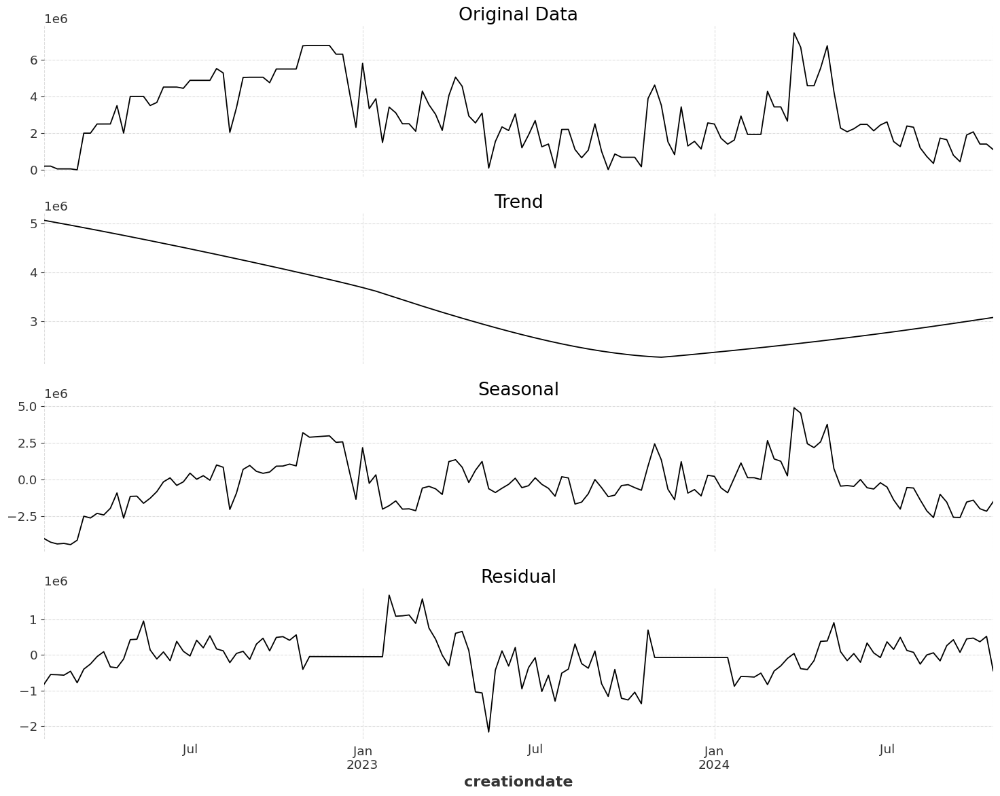

Rekening 5908:



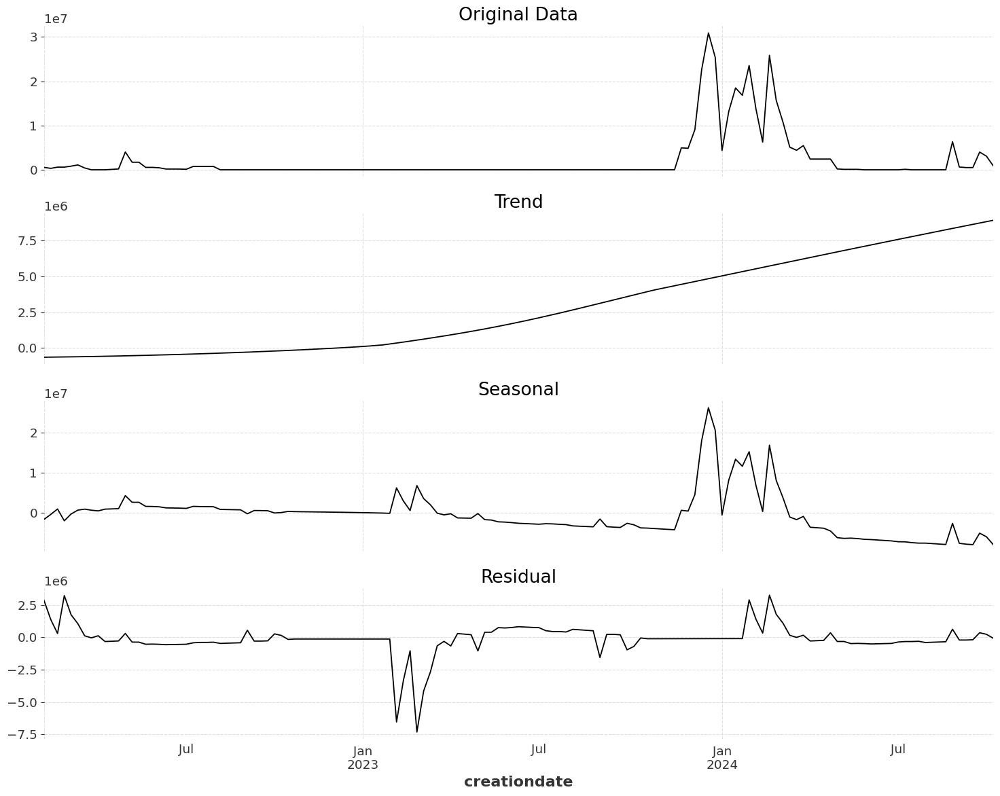

Rekening 7665:



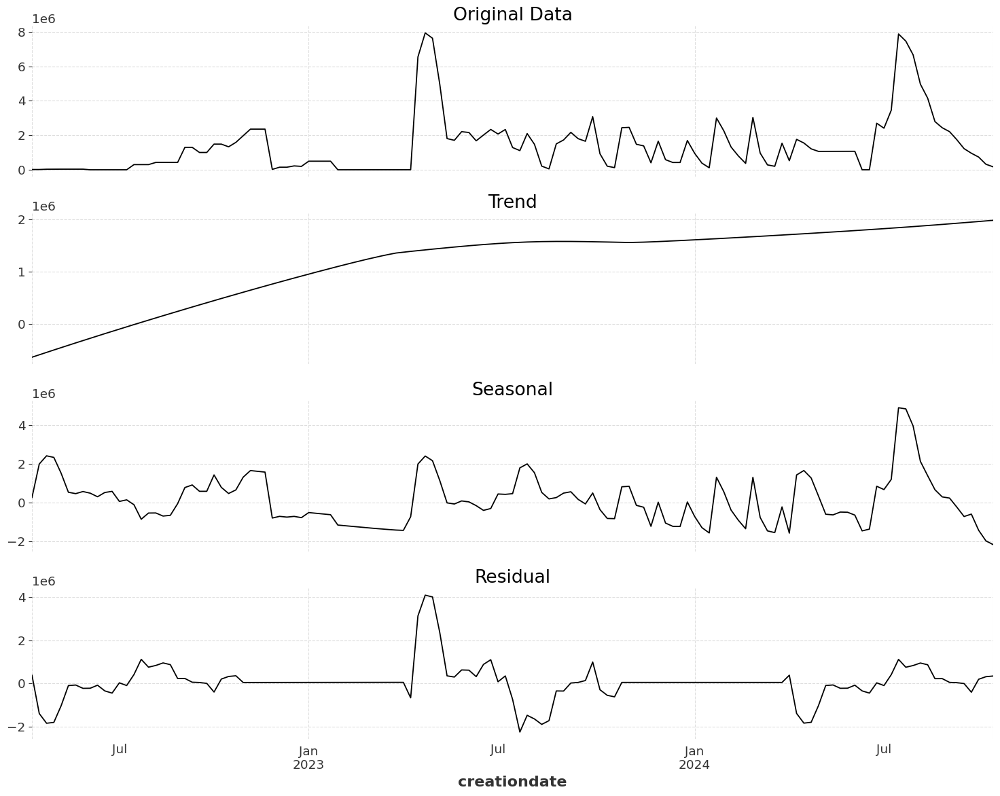

Rekening 1207:



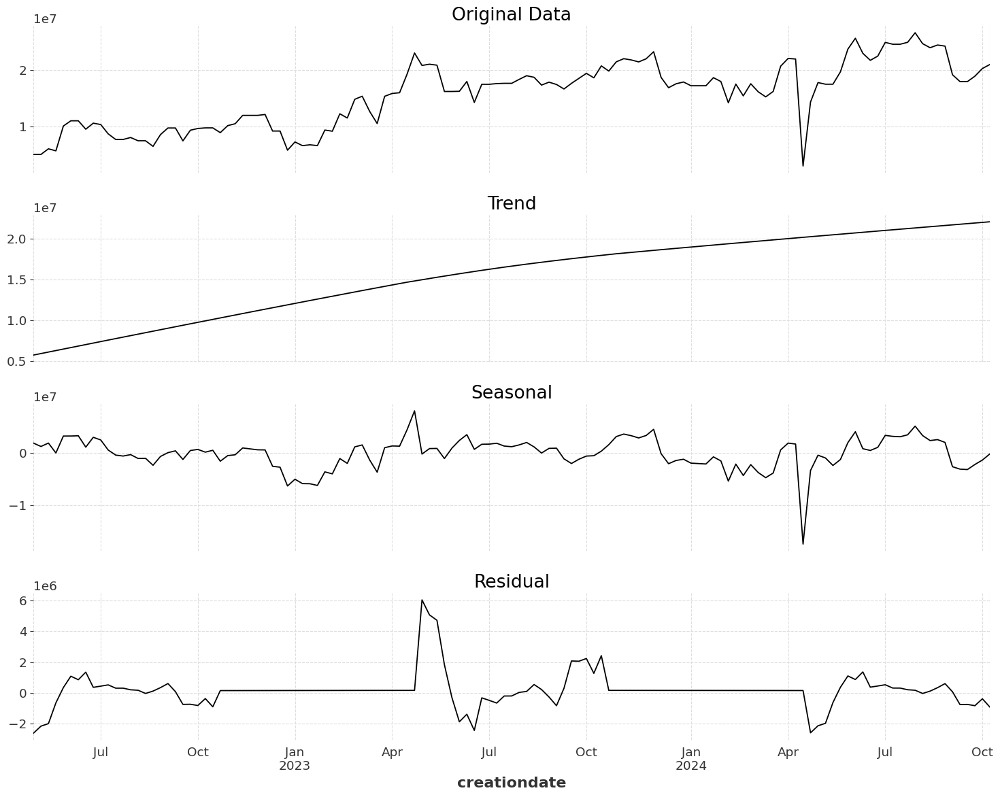

Rekening 15923:



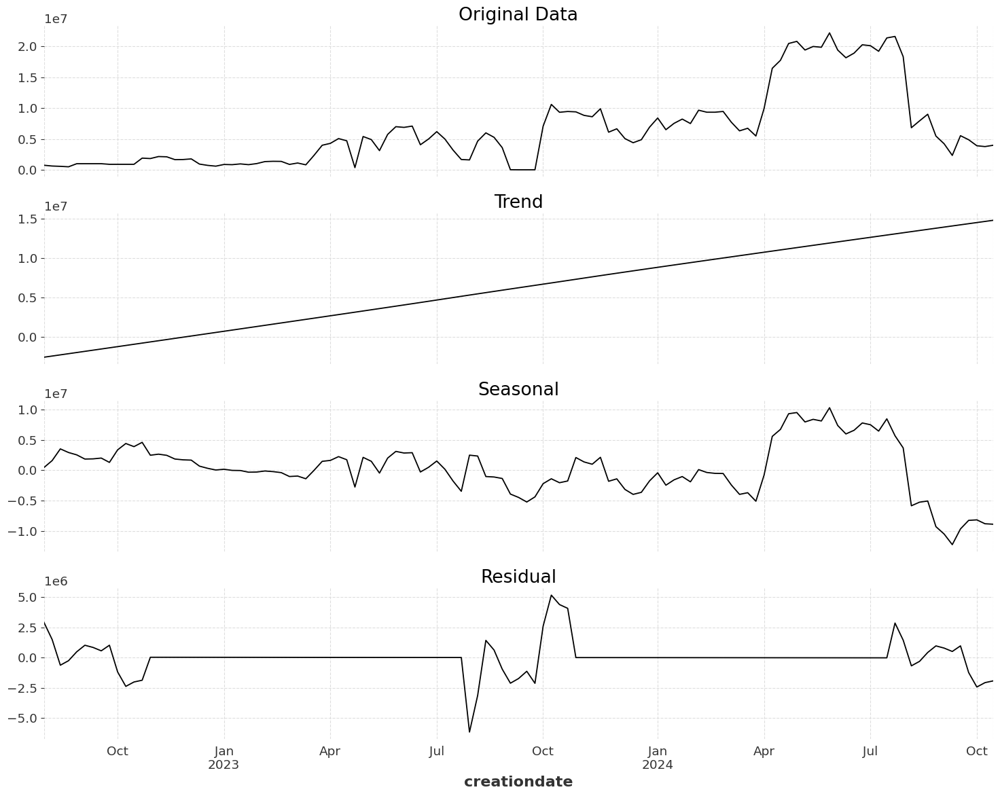

Rekening 825:



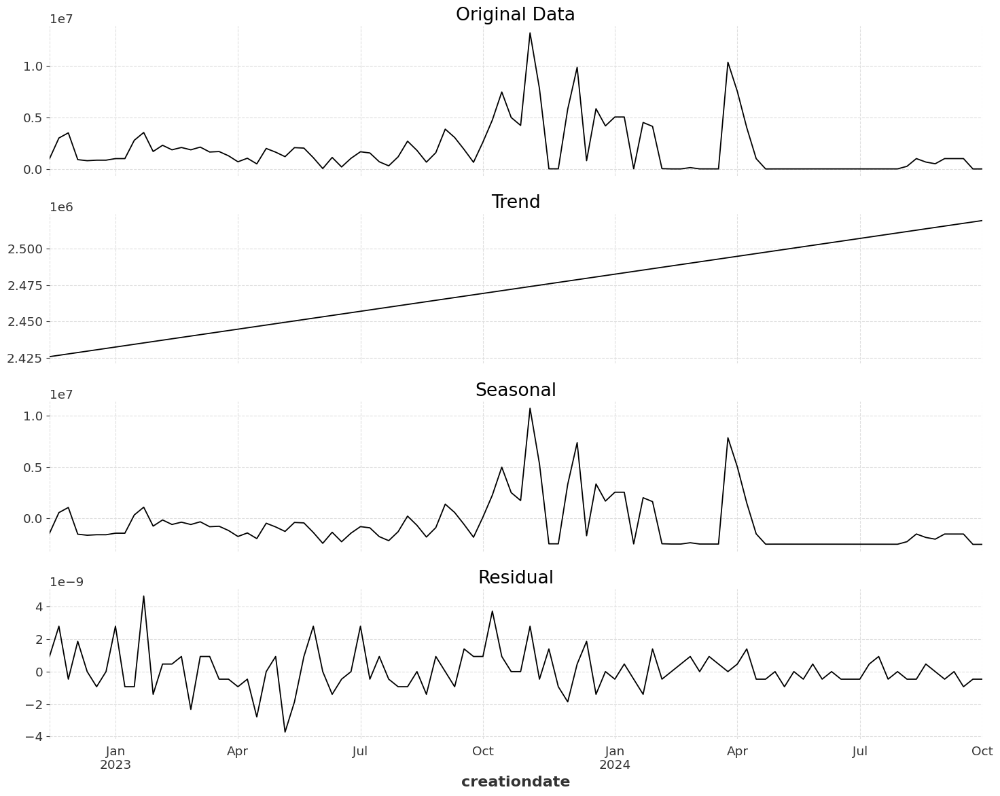

Rekening 15169:



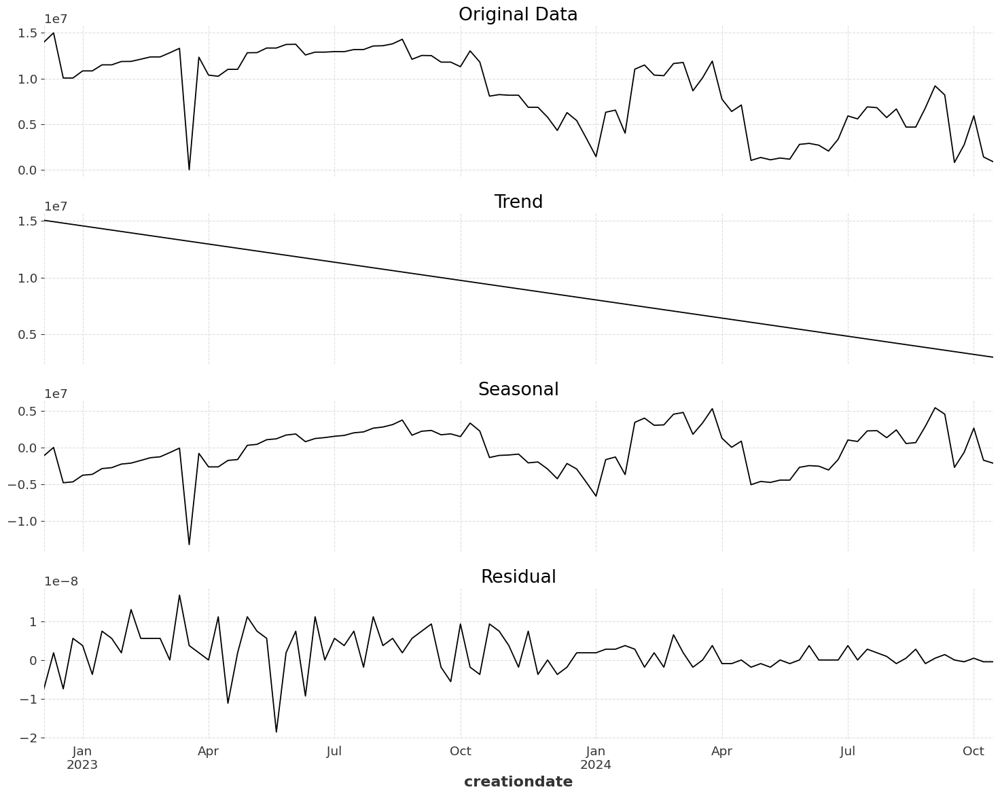

Rekening 9210:



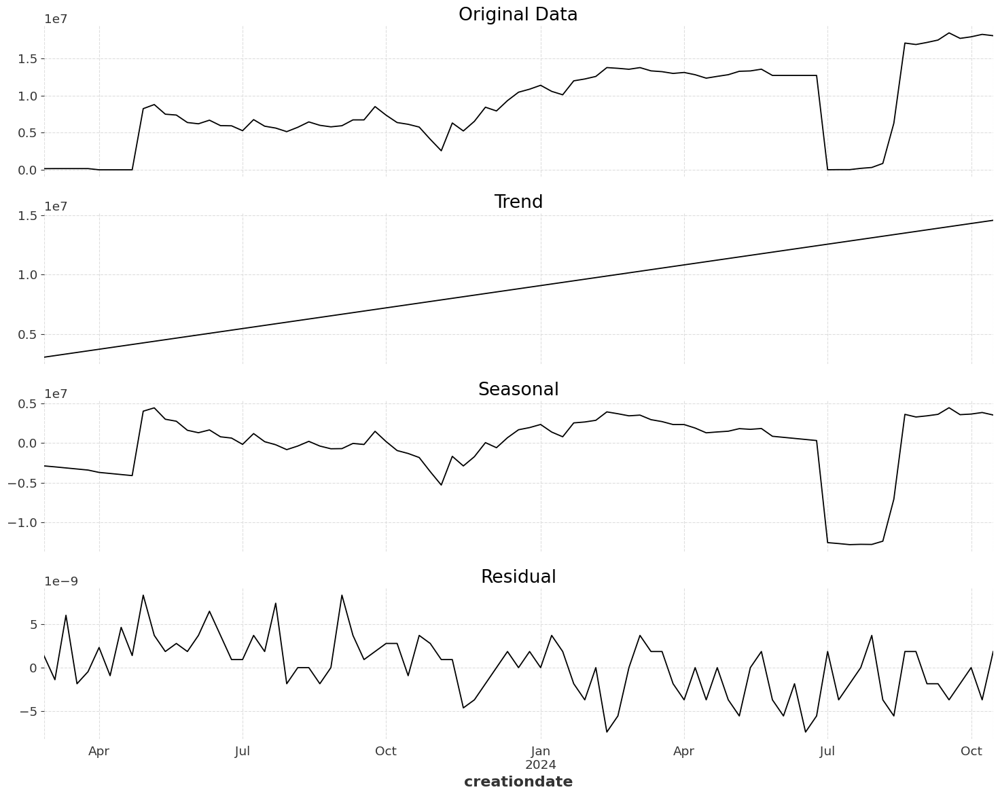

Rekening 6240:



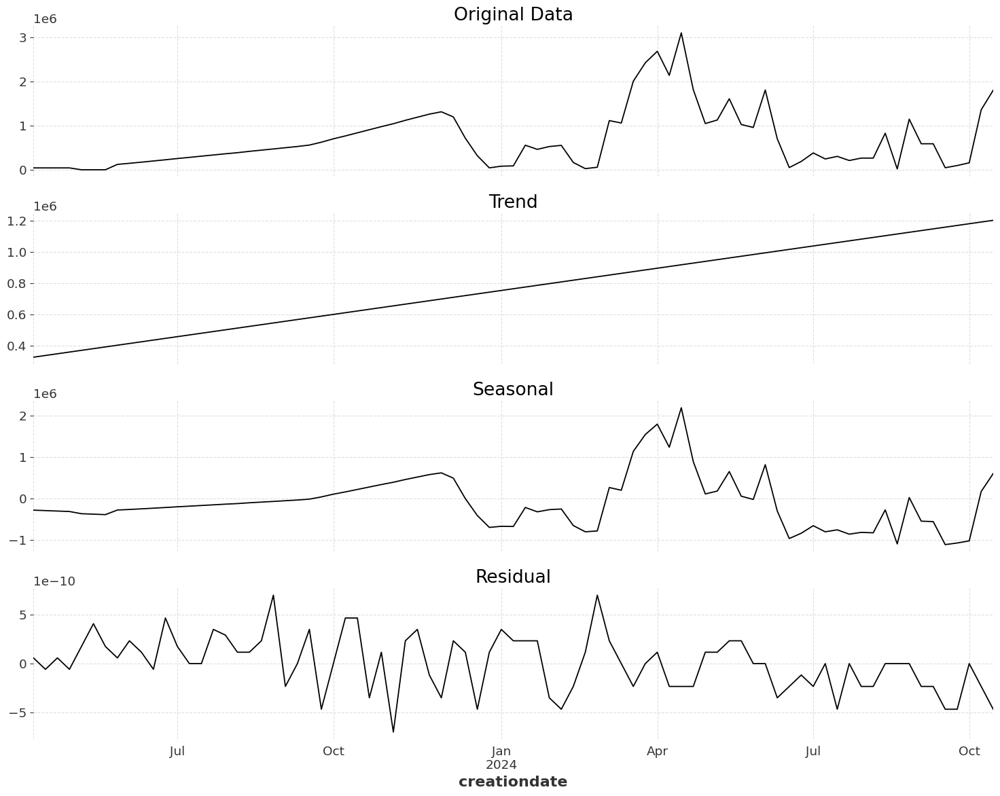

Rekening 6228:



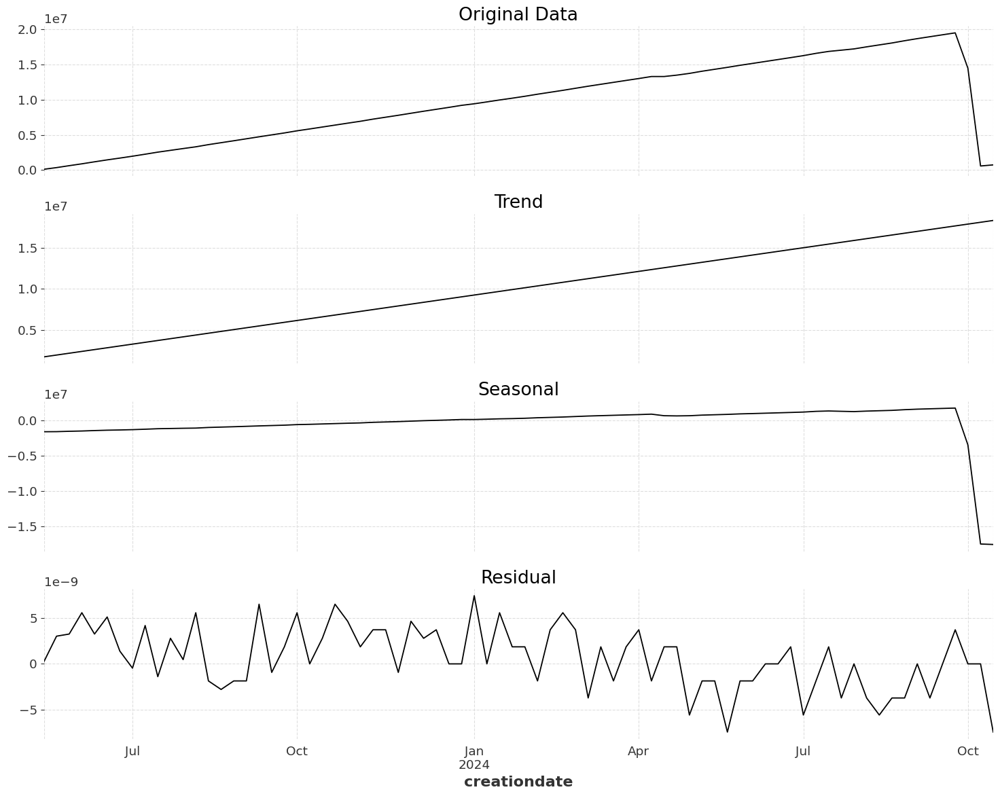

Rekening 7639:



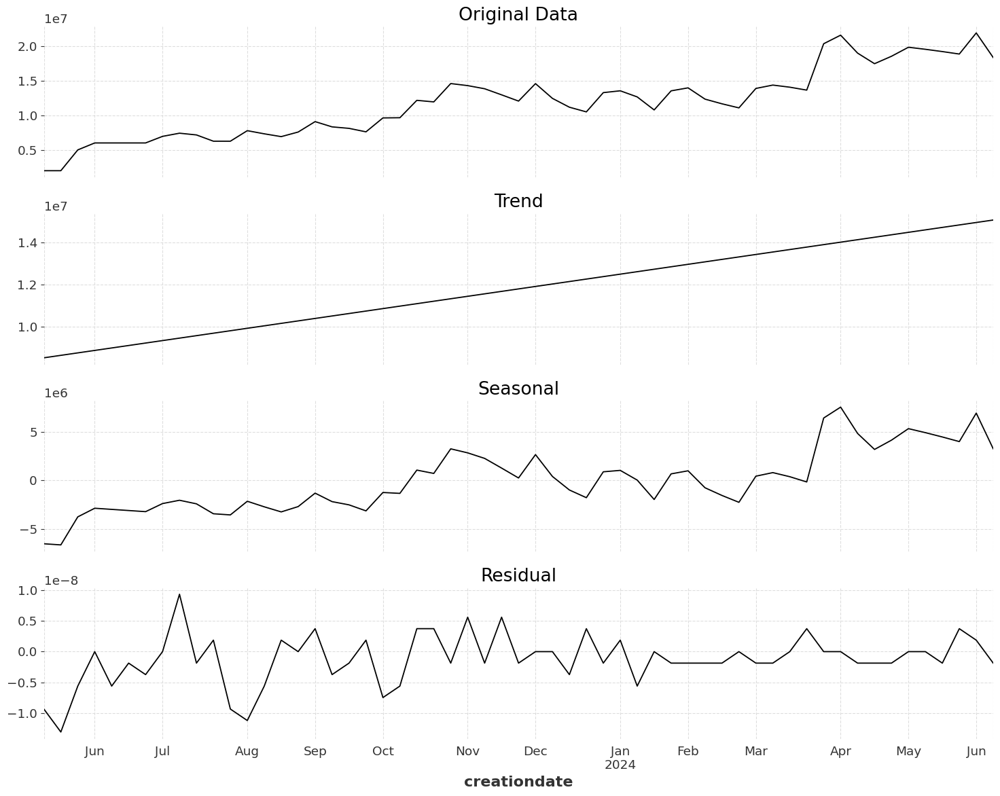

Rekening 7977:



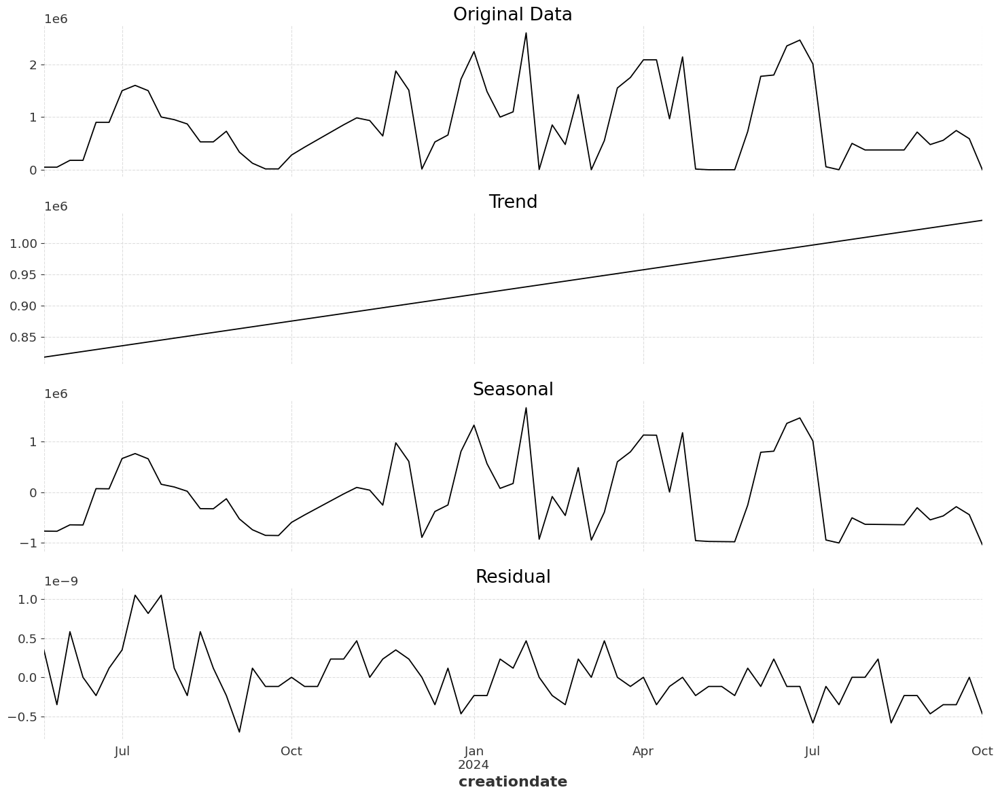

Rekening 15414:



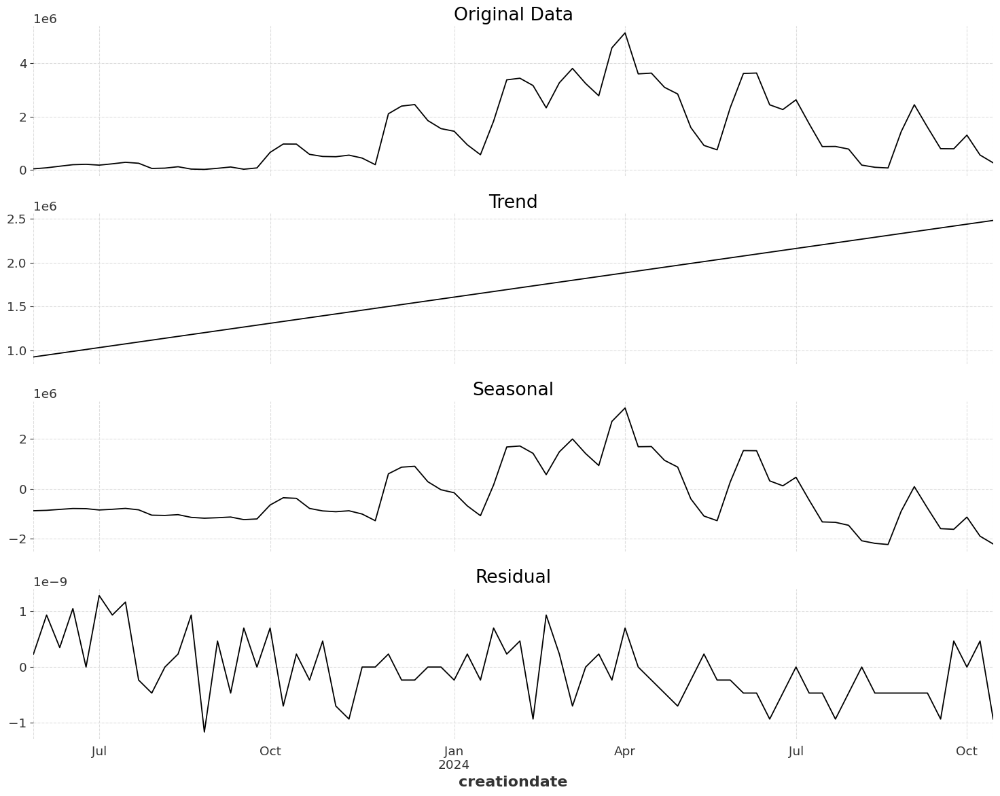

Rekening 13082:



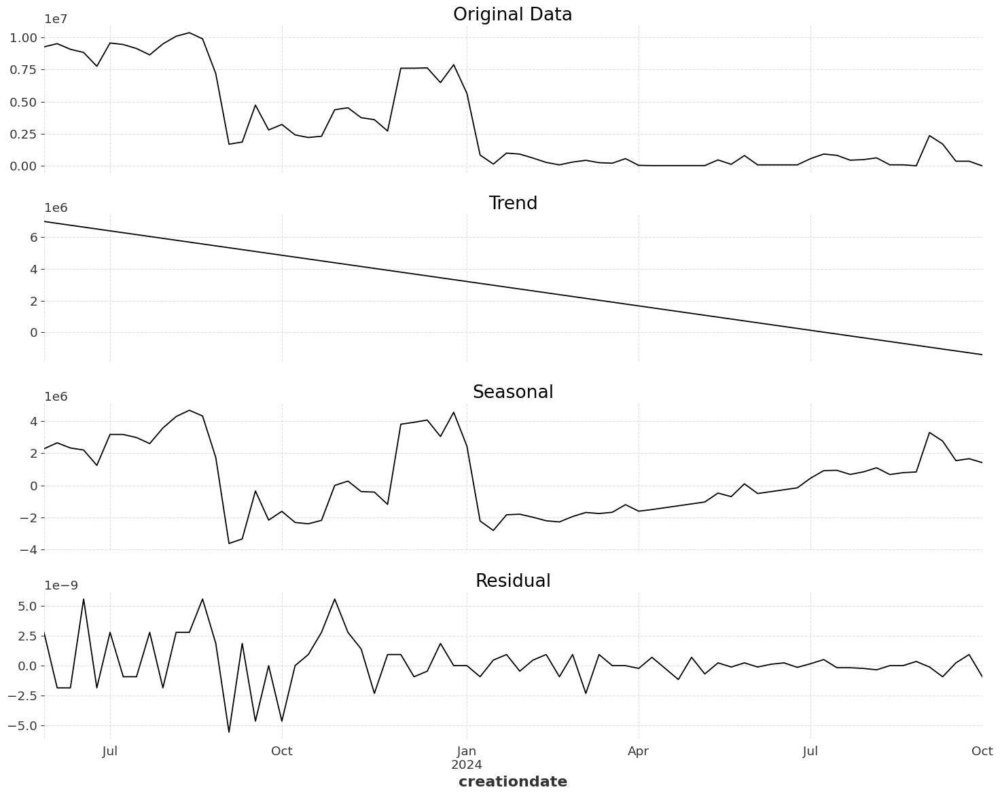

Rekening 8562:



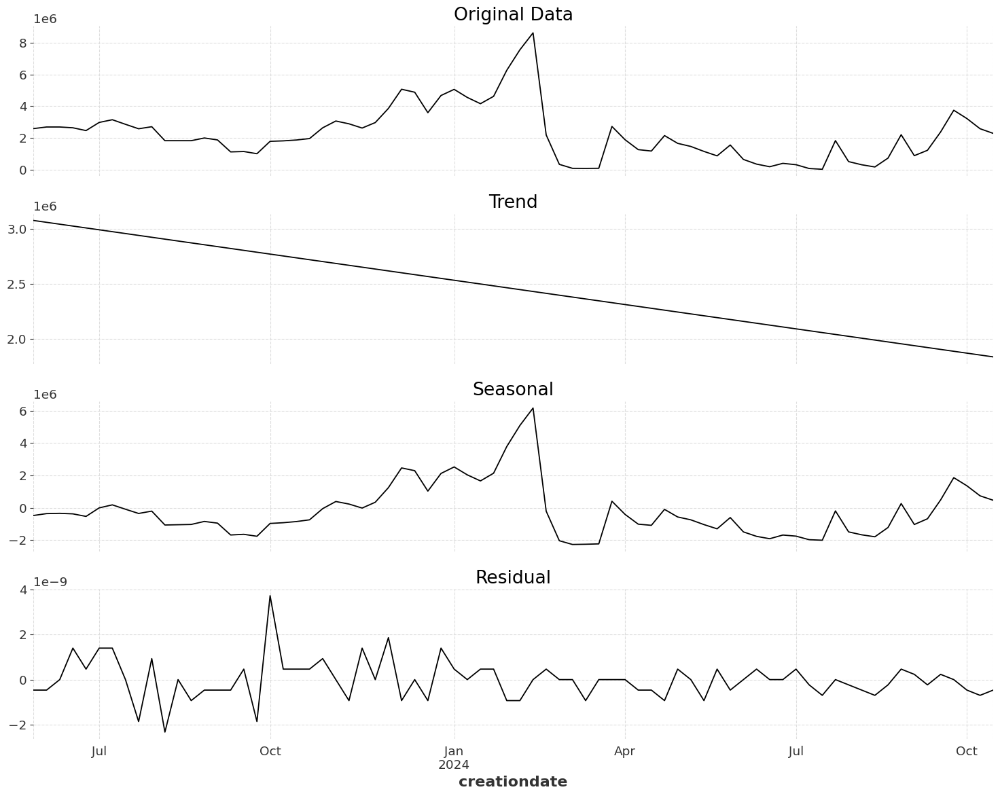

Rekening 8538:



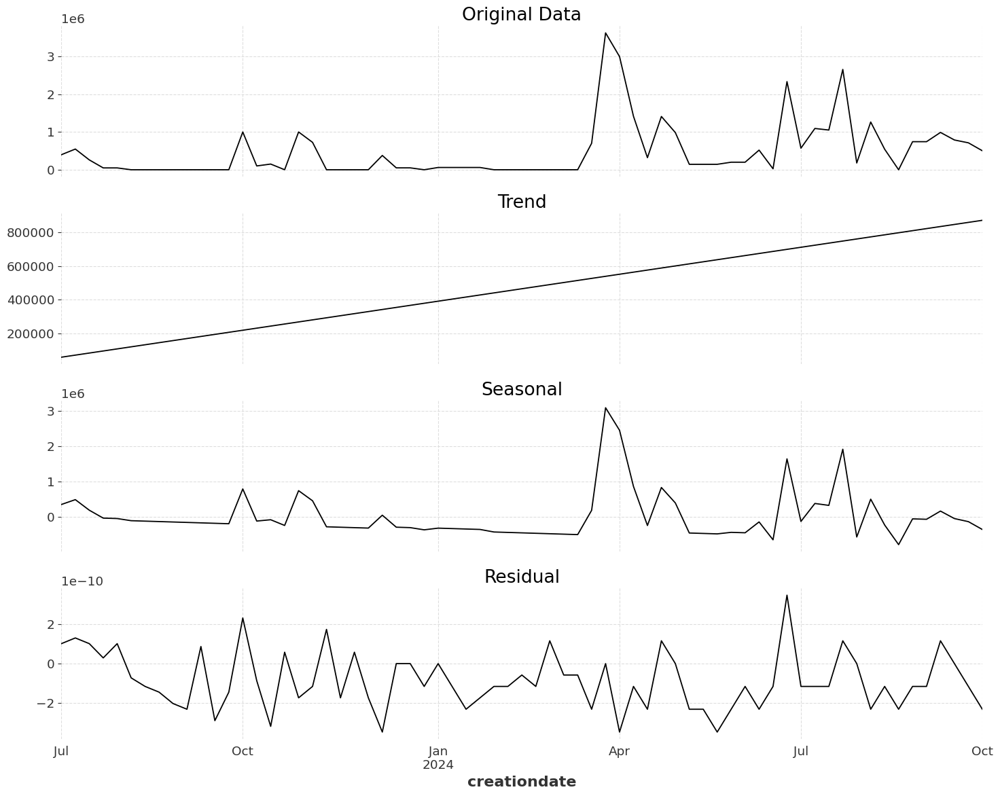

Rekening 10957:



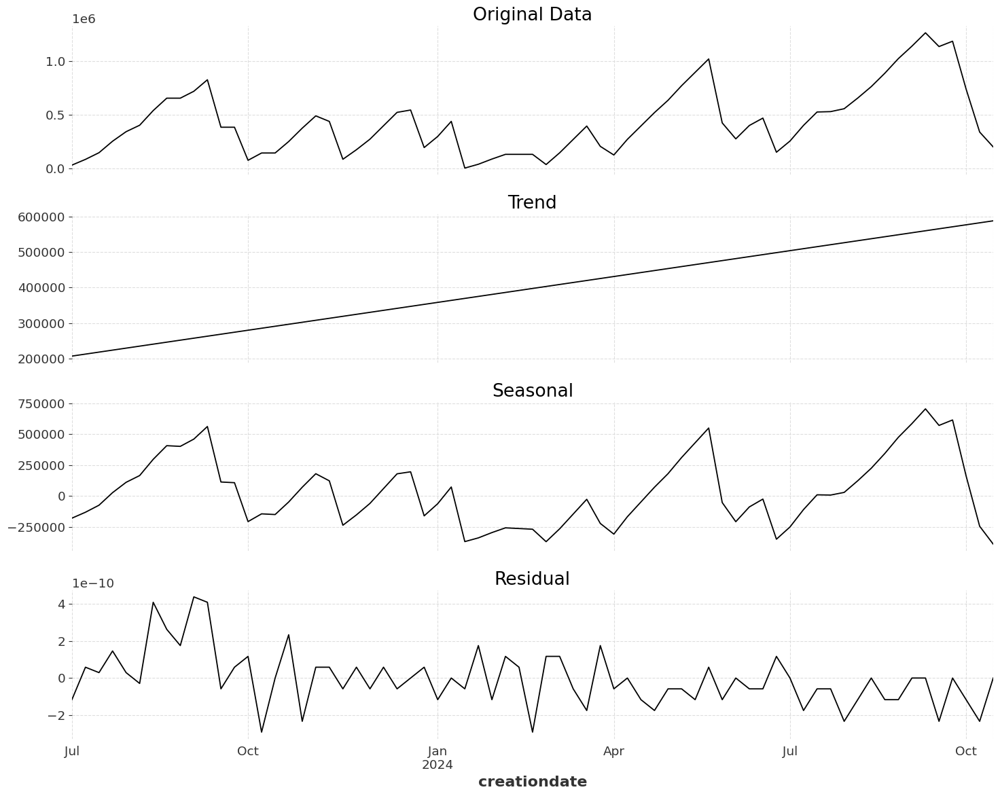

Rekening 6672:



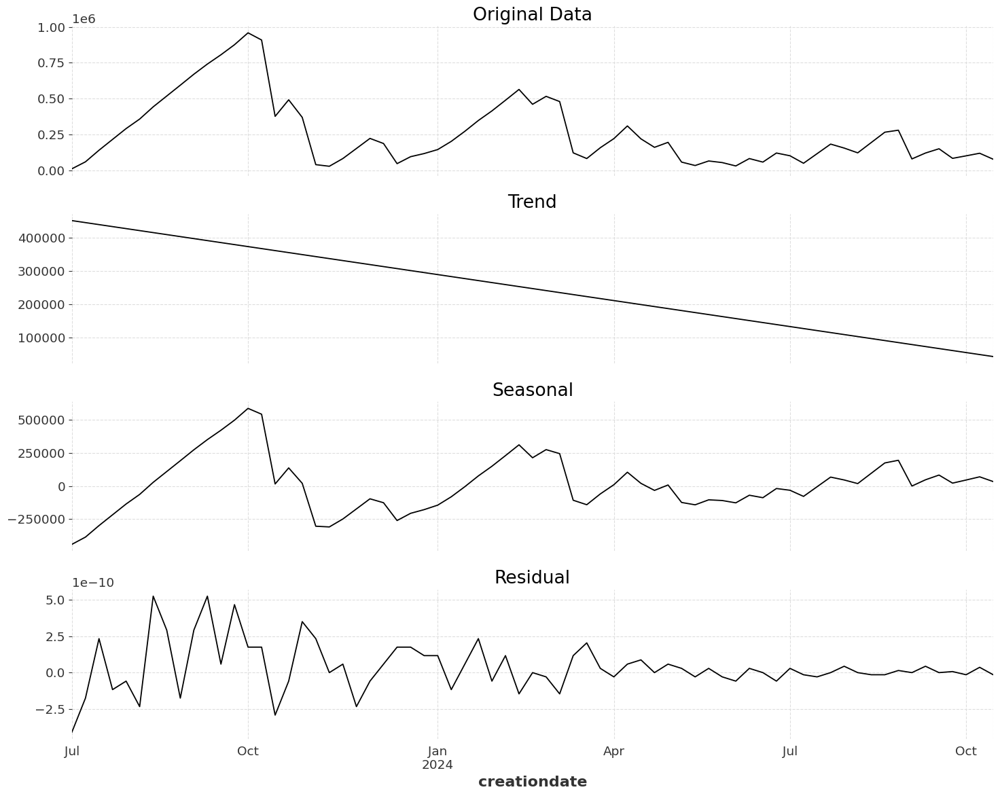

Rekening 7638:



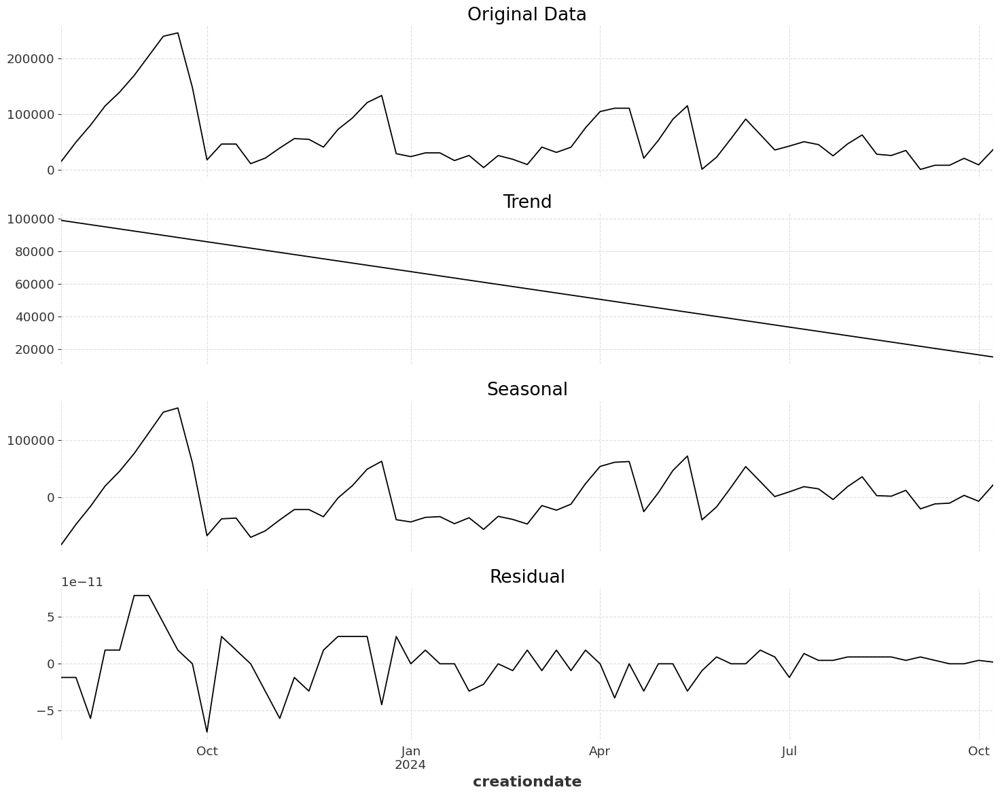

Rekening 7354:



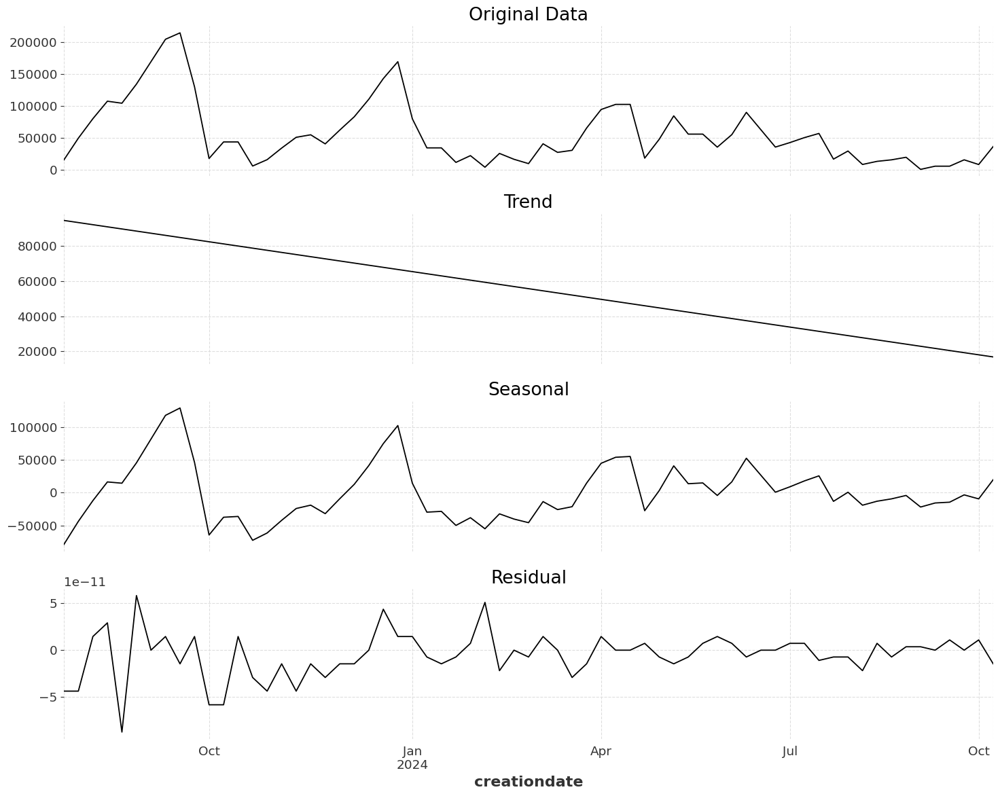

Rekening 6376:



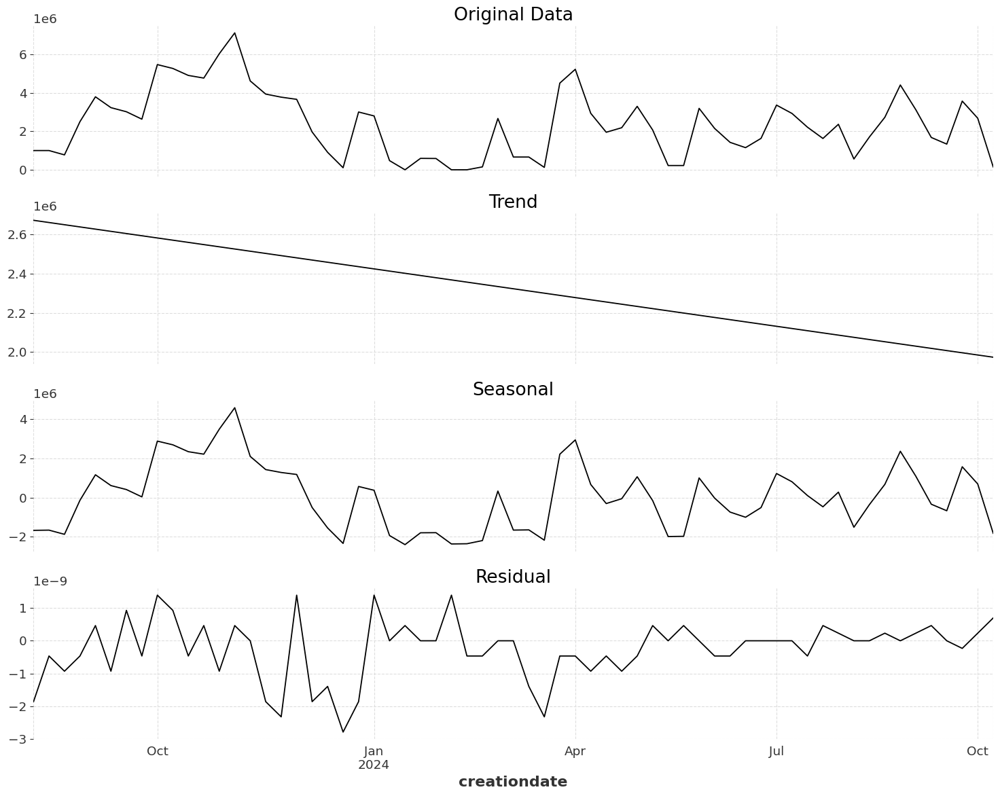

Rekening 11745:



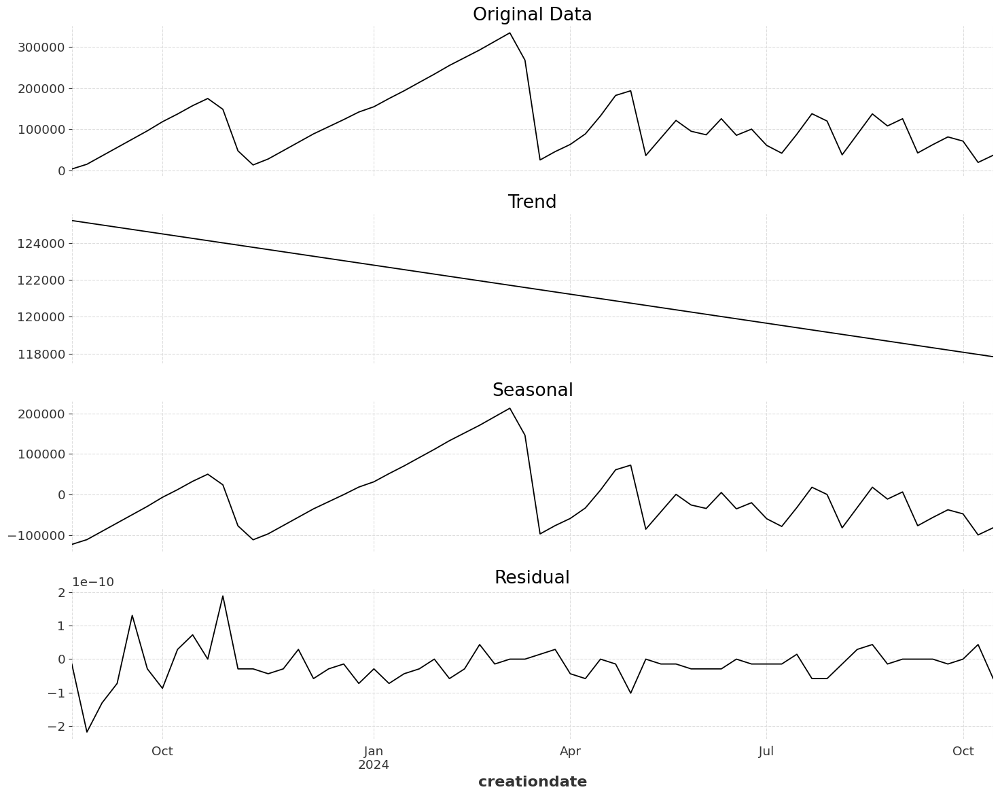

Rekening 1734:



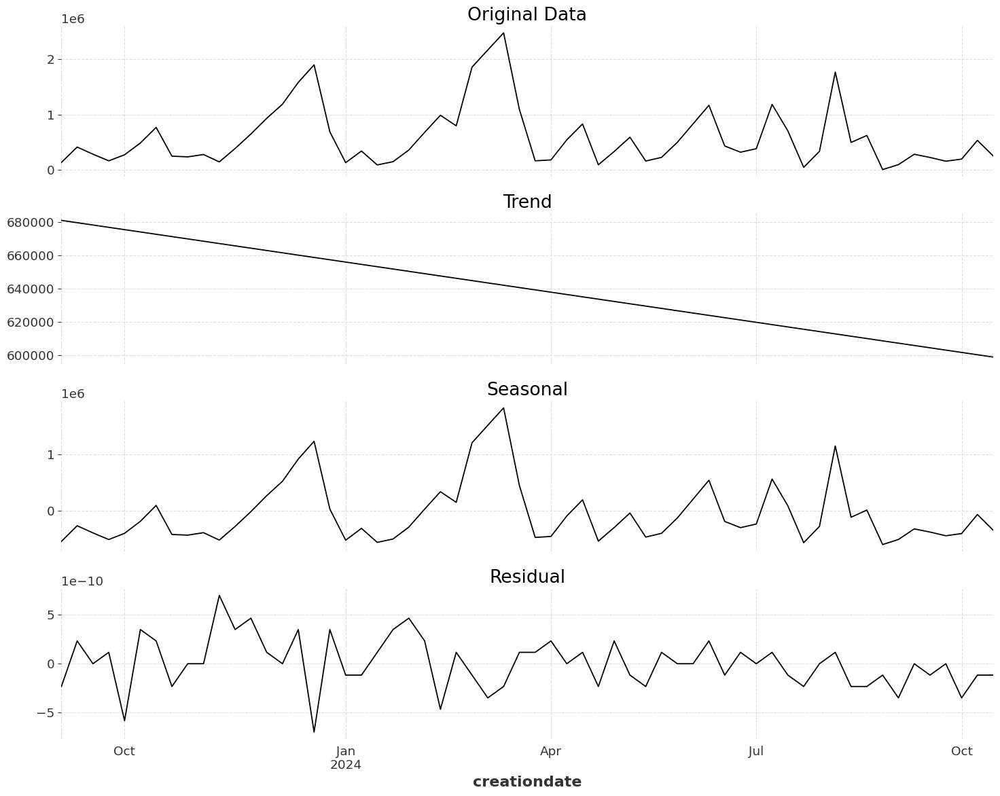

Rekening 11284:



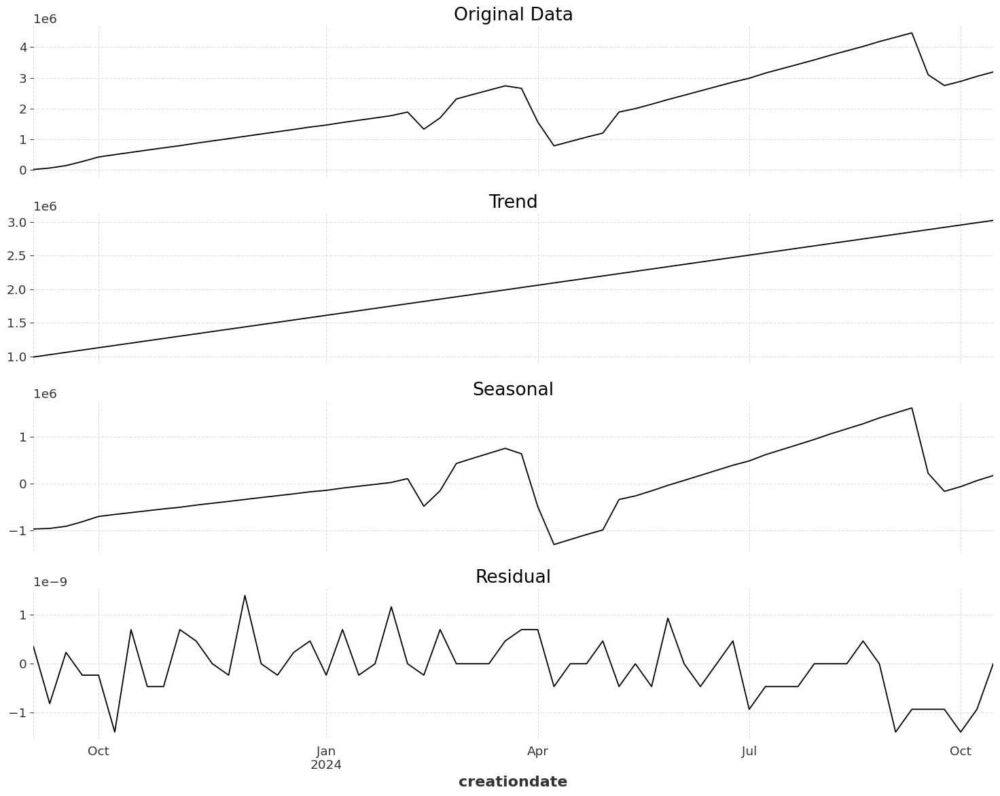

Rekening 541:



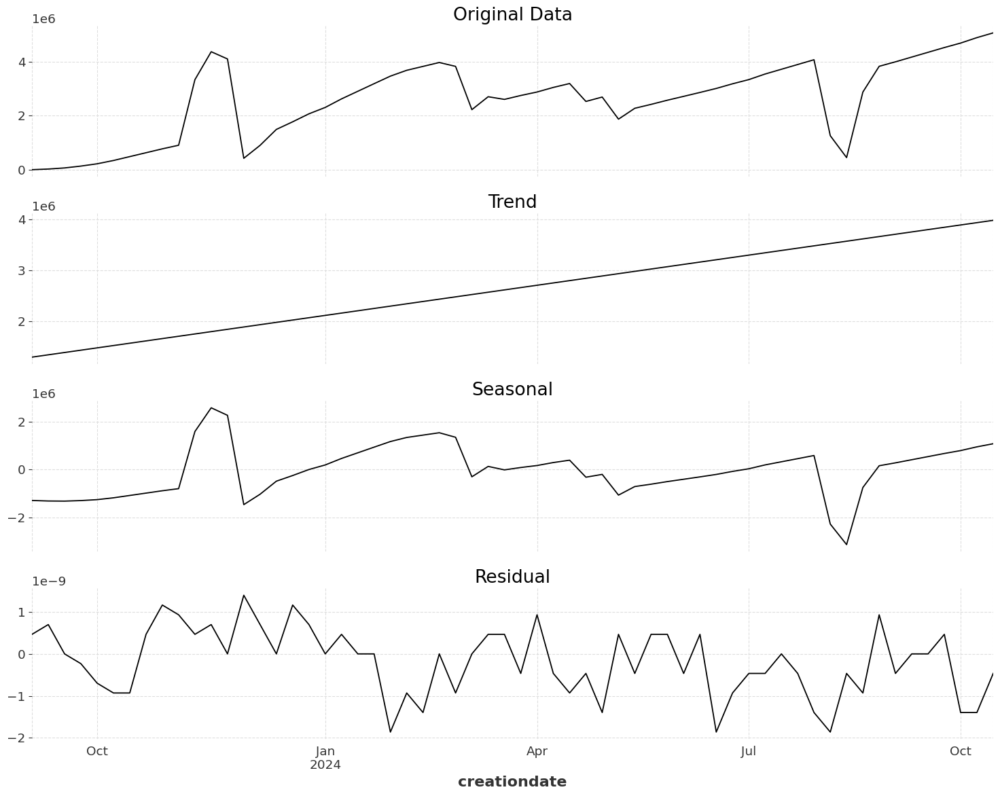

Rekening 11920:



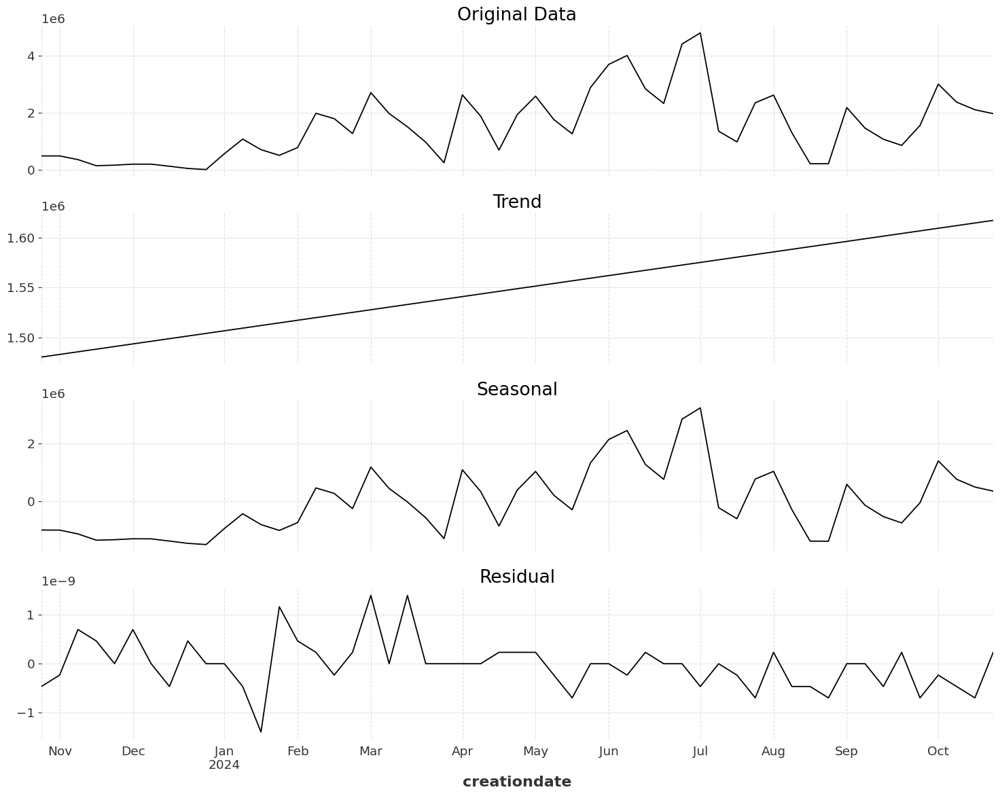

Rekening 2864:



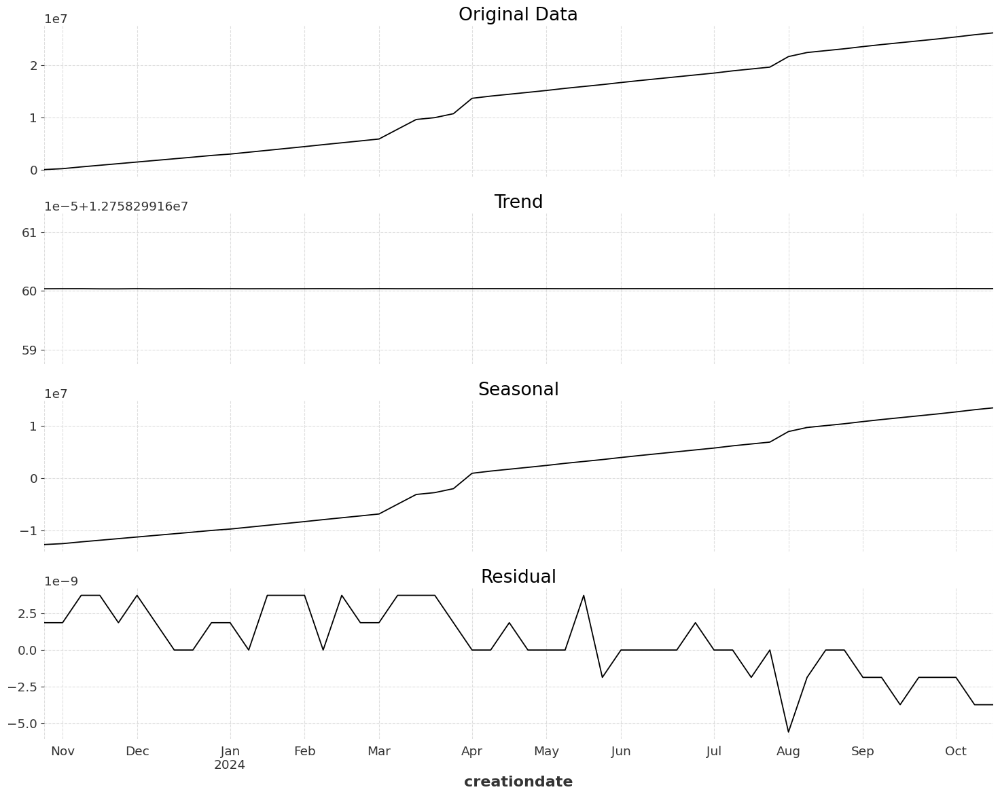

Rekening 9175:



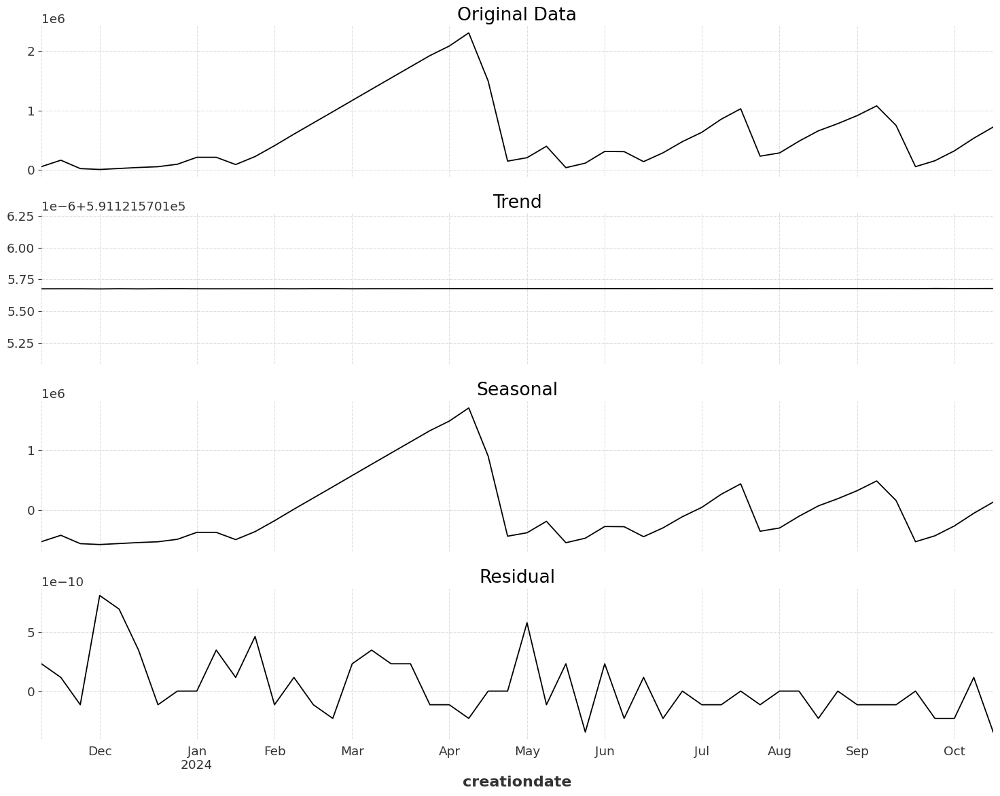

Rekening 2109:



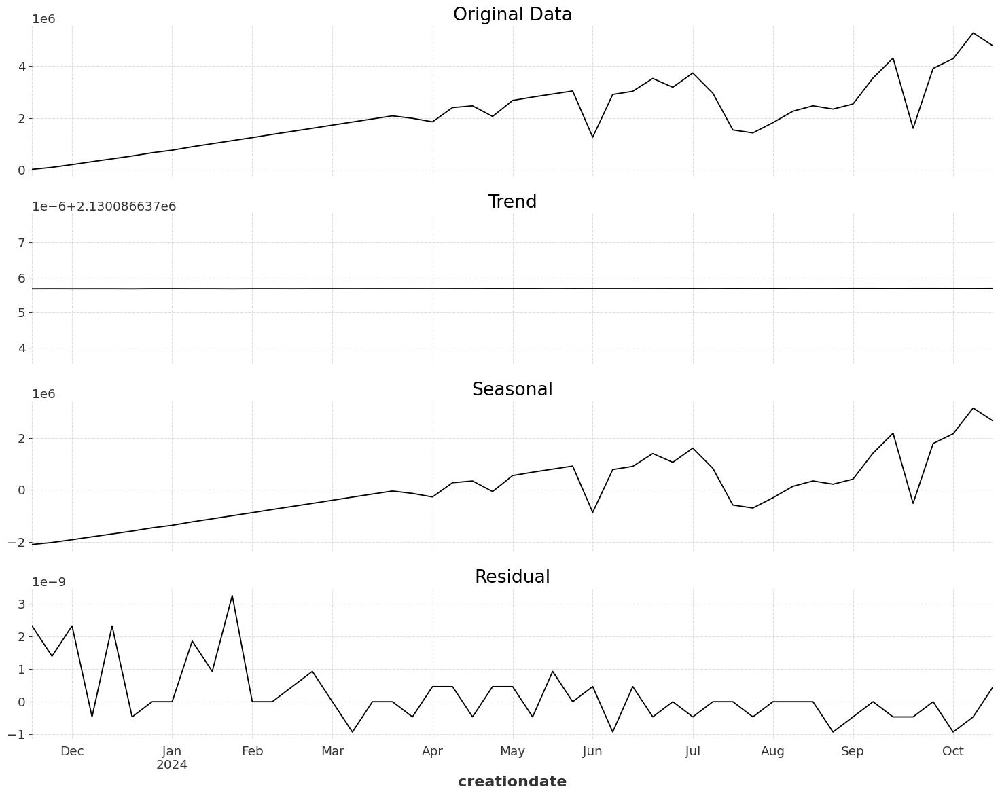

Rekening 10694:



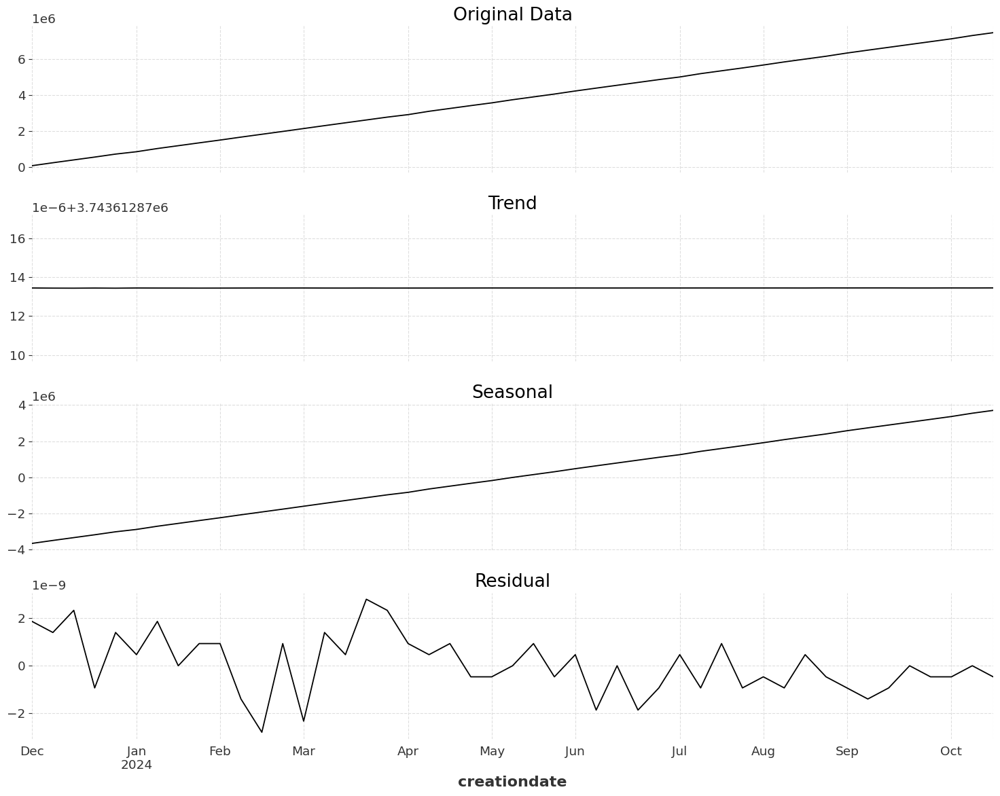

Rekening 15442:



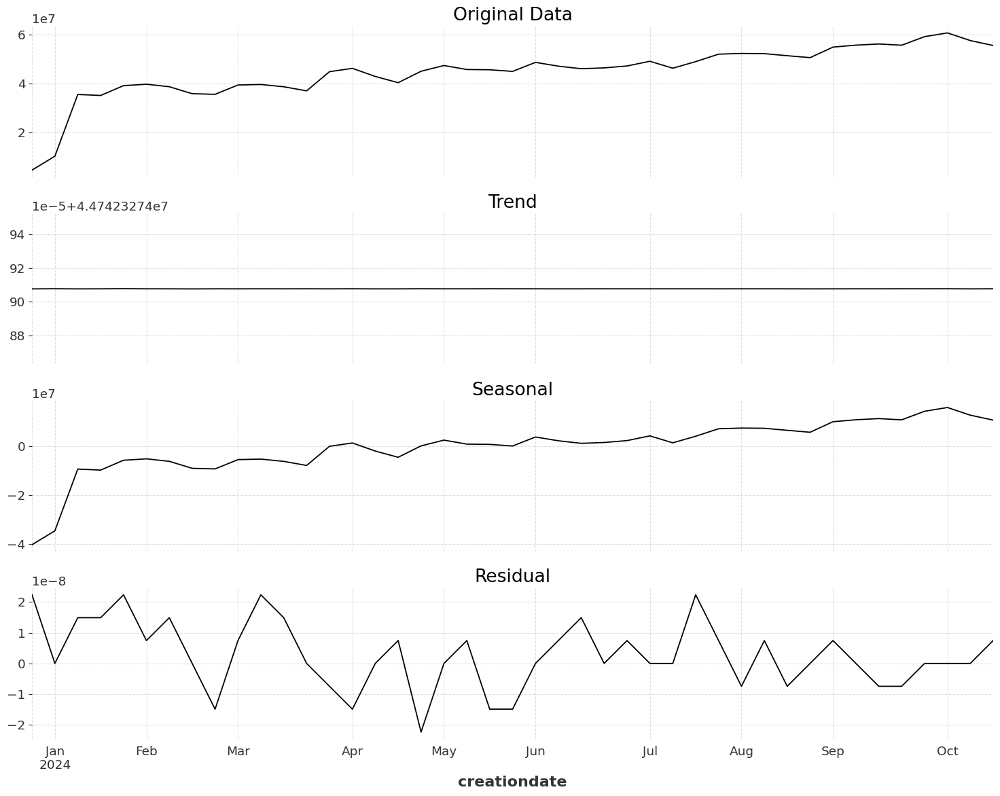

Rekening 13945:



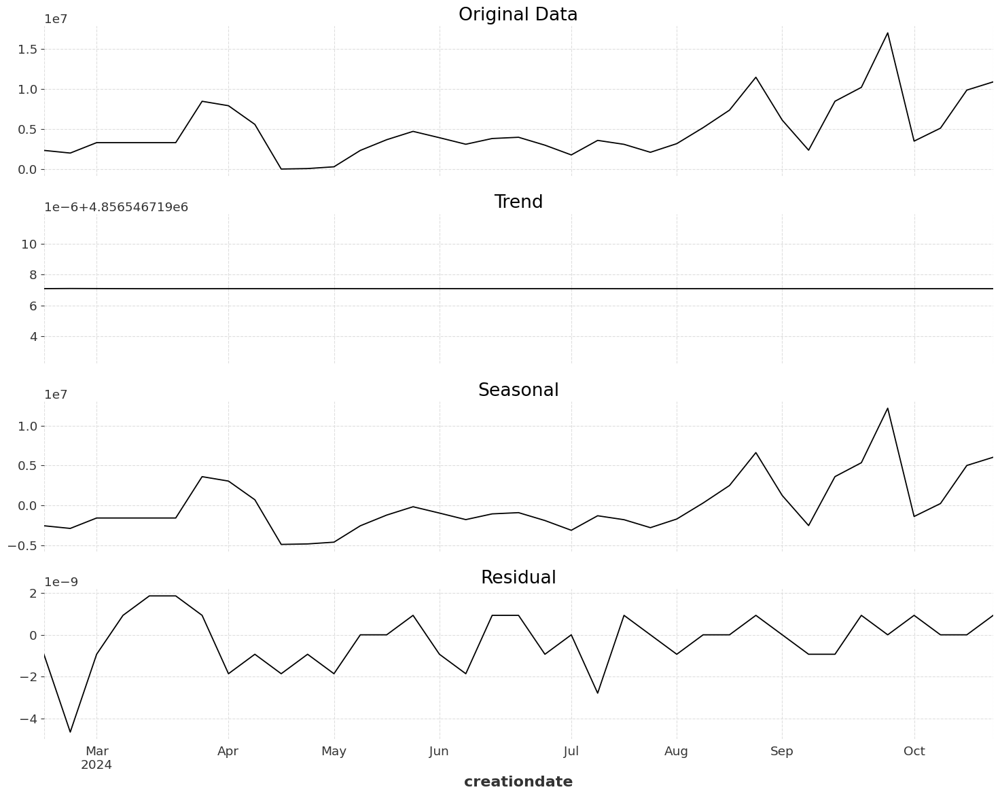

Rekening 11071:



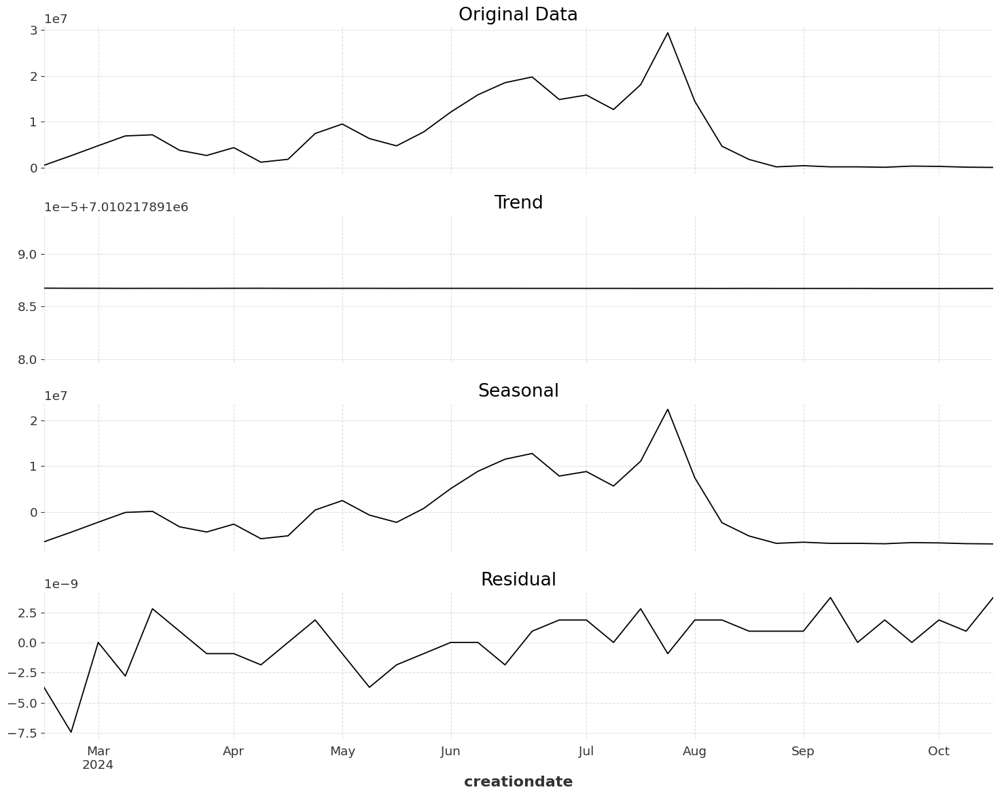

Rekening 2673:



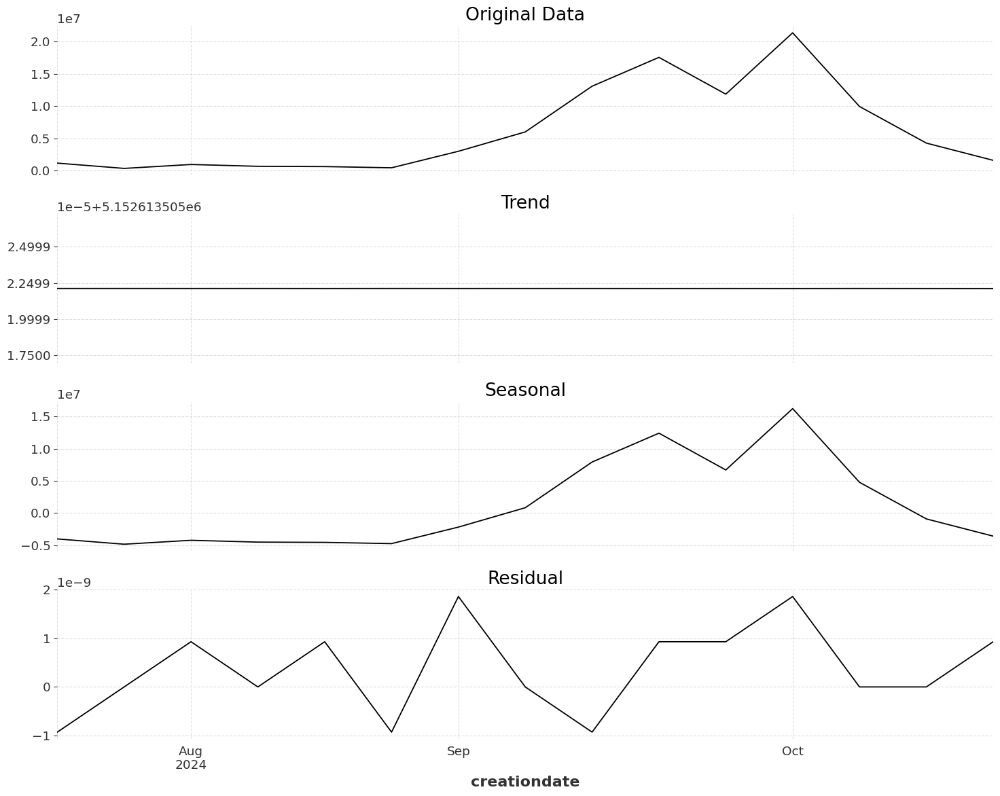

In [209]:
time_series_dict = prepare_time_series(df)

for rek, series in time_series_dict.items():
    print(f"Rekening {rek}:\n")
    stl = sm.tsa.STL(series["balance"]).fit()

    fig, ax = plt.subplots(4, 1, figsize=(15, 12), sharex=True)

    series["balance"].plot(ax=ax[0], c='black')
    ax[0].set_title("Original Data")

    stl.trend.plot(ax=ax[1], c='black')
    ax[1].set_title("Trend")

    stl.seasonal.plot(ax=ax[2], c='black')
    ax[2].set_title("Seasonal")

    stl.resid.plot(ax=ax[3], c='black')
    ax[3].set_title("Residual")

    plt.tight_layout()

    plt.show()

In [251]:
scale = np.zeros(20000, dtype=int)
min_val = np.zeros(20000, dtype=int)
for rek, df in time_series_dict.items():
  print(f"Rekening {rek}:\n")
  min_val[rek], max_val = np.min(df["balance"].values), np.max(df["balance"].values)
  scale[rek] = max_val - min_val[rek]
  df["y"] = (df["balance"].values - min_val[rek]) / scale[rek]

  print(scale[rek])
  display(df)





Rekening 9437:

5144486


,balance,y
creationdate,,
2022-01-30 00:00:00+07:00,2.128000e+05,0.041139
2022-02-06 00:00:00+07:00,1.700504e+05,0.032829
2022-02-13 00:00:00+07:00,1.700504e+05,0.032829
2022-02-20 00:00:00+07:00,2.356575e+06,0.457852
2022-02-27 00:00:00+07:00,1.706767e+06,0.331541
...,...,...
2024-09-15 00:00:00+07:00,8.802176e+05,0.170874
2024-09-22 00:00:00+07:00,5.398926e+05,0.104720
2024-09-29 00:00:00+07:00,5.010176e+05,0.097164


Rekening 2526:

7476313


,balance,y
creationdate,,
2022-01-30 00:00:00+07:00,2.000000e+05,0.026741
2022-02-06 00:00:00+07:00,2.000279e+05,0.026745
2022-02-13 00:00:00+07:00,5.003714e+04,0.006682
2022-02-20 00:00:00+07:00,5.003714e+04,0.006682
2022-02-27 00:00:00+07:00,5.003714e+04,0.006682
...,...,...
2024-09-29 00:00:00+07:00,1.900420e+06,0.254182
2024-10-06 00:00:00+07:00,2.071150e+06,0.277018
2024-10-13 00:00:00+07:00,1.405064e+06,0.187925


Rekening 5908:

30915696


,balance,y
creationdate,,
2022-02-06 00:00:00+07:00,5.500000e+05,0.017788
2022-02-13 00:00:00+07:00,3.250000e+05,0.010510
2022-02-20 00:00:00+07:00,6.000000e+05,0.019405
2022-02-27 00:00:00+07:00,6.000000e+05,0.019405
2022-03-06 00:00:00+07:00,8.204479e+05,0.026536
...,...,...
2024-09-15 00:00:00+07:00,5.017772e+05,0.016228
2024-09-22 00:00:00+07:00,5.017772e+05,0.016228
2024-09-29 00:00:00+07:00,4.001777e+06,0.129439


Rekening 7665:

7935384


,balance,y
creationdate,,
2022-04-10 00:00:00+07:00,1.666733e+04,0.001974
2022-04-17 00:00:00+07:00,1.666733e+04,0.001974
2022-04-24 00:00:00+07:00,3.300033e+04,0.004033
2022-05-01 00:00:00+07:00,3.705604e+04,0.004544
2022-05-08 00:00:00+07:00,3.705604e+04,0.004544
...,...,...
2024-09-22 00:00:00+07:00,1.226703e+06,0.154460
2024-09-29 00:00:00+07:00,9.604526e+05,0.120908
2024-10-06 00:00:00+07:00,7.377949e+05,0.092849


Rekening 1207:

23728694


,balance,y
creationdate,,
2022-05-01 00:00:00+07:00,5.001069e+06,0.086805
2022-05-08 00:00:00+07:00,5.001069e+06,0.086805
2022-05-15 00:00:00+07:00,6.001900e+06,0.128983
2022-05-22 00:00:00+07:00,5.640654e+06,0.113759
2022-05-29 00:00:00+07:00,1.006015e+07,0.300011
...,...,...
2024-09-15 00:00:00+07:00,1.797191e+07,0.633436
2024-09-22 00:00:00+07:00,1.797191e+07,0.633436
2024-09-29 00:00:00+07:00,1.893586e+07,0.674060


Rekening 15923:

22176732


,balance,y
creationdate,,
2022-07-31 00:00:00+07:00,7.362430e+05,0.033134
2022-08-07 00:00:00+07:00,6.113237e+05,0.027501
2022-08-14 00:00:00+07:00,5.613507e+05,0.025248
2022-08-21 00:00:00+07:00,4.863507e+05,0.021866
2022-08-28 00:00:00+07:00,9.863507e+05,0.044412
...,...,...
2024-09-22 00:00:00+07:00,5.524763e+06,0.249060
2024-09-29 00:00:00+07:00,4.868097e+06,0.219449
2024-10-06 00:00:00+07:00,3.895594e+06,0.175597


Rekening 825:

13197722


,balance,y
creationdate,,
2022-11-13 00:00:00+07:00,987675.000,7.476101e-02
2022-11-20 00:00:00+07:00,3000350.000,2.272627e-01
2022-11-27 00:00:00+07:00,3500350.000,2.651480e-01
2022-12-04 00:00:00+07:00,902689.324,6.832159e-02
2022-12-11 00:00:00+07:00,801548.500,6.065808e-02
...,...,...
2024-09-08 00:00:00+07:00,1004932.030,7.606858e-02
2024-09-15 00:00:00+07:00,1004932.030,7.606858e-02
2024-09-22 00:00:00+07:00,1004932.030,7.606858e-02


Rekening 15169:

14990265


,balance,y
creationdate,,
2022-12-04 00:00:00+07:00,1.397740e+07,0.932316
2022-12-11 00:00:00+07:00,1.499200e+07,1.000000
2022-12-18 00:00:00+07:00,1.005000e+07,0.670319
2022-12-25 00:00:00+07:00,1.005000e+07,0.670319
2023-01-01 00:00:00+07:00,1.082903e+07,0.722289
...,...,...
2024-09-22 00:00:00+07:00,8.022363e+05,0.053401
2024-09-29 00:00:00+07:00,2.736570e+06,0.182441
2024-10-06 00:00:00+07:00,5.913307e+06,0.394361


Rekening 9210:

18480761


,balance,y
creationdate,,
2023-02-26 00:00:00+07:00,1.523333e+05,0.008174
2023-03-05 00:00:00+07:00,1.628016e+05,0.008740
2023-03-12 00:00:00+07:00,1.628016e+05,0.008740
2023-03-19 00:00:00+07:00,1.628016e+05,0.008740
2023-03-26 00:00:00+07:00,1.628016e+05,0.008740
...,...,...
2024-09-22 00:00:00+07:00,1.848204e+07,1.000000
2024-09-29 00:00:00+07:00,1.774079e+07,0.959891
2024-10-06 00:00:00+07:00,1.795187e+07,0.971312


Rekening 6240:

3101477


,balance,y
creationdate,,
2023-04-09 00:00:00+07:00,4.347100e+04,1.354161e-02
2023-04-16 00:00:00+07:00,4.347100e+04,1.354161e-02
2023-04-23 00:00:00+07:00,4.347100e+04,1.354161e-02
2023-04-30 00:00:00+07:00,4.347100e+04,1.354161e-02
2023-05-07 00:00:00+07:00,1.472823e+03,2.654649e-07
...,...,...
2024-09-22 00:00:00+07:00,4.710876e+04,1.471452e-02
2024-09-29 00:00:00+07:00,9.715876e+04,3.085200e-02
2024-10-06 00:00:00+07:00,1.589517e+05,5.077572e-02


Rekening 6228:

19344992


,balance,y
creationdate,,
2023-05-14 00:00:00+07:00,1.172820e+05,0.000000
2023-05-21 00:00:00+07:00,3.518460e+05,0.012125
2023-05-28 00:00:00+07:00,6.255040e+05,0.026272
2023-06-04 00:00:00+07:00,8.878518e+05,0.039833
2023-06-11 00:00:00+07:00,1.173489e+06,0.054598
...,...,...
2024-09-22 00:00:00+07:00,1.918862e+07,0.985854
2024-09-29 00:00:00+07:00,1.946227e+07,1.000000
2024-10-06 00:00:00+07:00,1.444918e+07,0.740858


Rekening 7639:

19868740


,balance,y
creationdate,,
2023-05-14 00:00:00+07:00,2.000000e+06,0.000000
2023-05-21 00:00:00+07:00,2.000000e+06,0.000000
2023-05-28 00:00:00+07:00,5.000000e+06,0.150991
2023-06-04 00:00:00+07:00,6.002989e+06,0.201472
2023-06-11 00:00:00+07:00,6.002989e+06,0.201472
2023-06-18 00:00:00+07:00,6.002989e+06,0.201472
2023-06-25 00:00:00+07:00,6.002989e+06,0.201472
2023-07-02 00:00:00+07:00,6.951198e+06,0.249195
2023-07-09 00:00:00+07:00,7.408741e+06,0.272224


Rekening 7977:

2595733


,balance,y
creationdate,,
2023-05-21 00:00:00+07:00,50000.000000,0.018708
2023-05-28 00:00:00+07:00,50000.000000,0.018708
2023-06-04 00:00:00+07:00,180035.730000,0.068804
2023-06-11 00:00:00+07:00,180035.730000,0.068804
2023-06-18 00:00:00+07:00,900054.970000,0.346189
...,...,...
2024-09-08 00:00:00+07:00,479051.296667,0.183999
2024-09-15 00:00:00+07:00,560098.915714,0.215222
2024-09-22 00:00:00+07:00,745259.630000,0.286555


Rekening 15414:

5111412


,balance,y
creationdate,,
2023-05-28 00:00:00+07:00,4.492700e+04,0.004272
2023-06-04 00:00:00+07:00,8.271135e+04,0.011664
2023-06-11 00:00:00+07:00,1.421587e+05,0.023294
2023-06-18 00:00:00+07:00,1.991527e+05,0.034444
2023-06-25 00:00:00+07:00,2.143144e+05,0.037411
...,...,...
2024-09-22 00:00:00+07:00,7.988983e+05,0.151779
2024-09-29 00:00:00+07:00,7.941595e+05,0.150852
2024-10-06 00:00:00+07:00,1.304519e+06,0.250699


Rekening 13082:

10369972


,balance,y
creationdate,,
2023-05-28 00:00:00+07:00,9.267191e+06,8.933150e-01
2023-06-04 00:00:00+07:00,9.521020e+06,9.177922e-01
2023-06-11 00:00:00+07:00,9.081172e+06,8.753767e-01
2023-06-18 00:00:00+07:00,8.835187e+06,8.516558e-01
2023-06-25 00:00:00+07:00,7.758505e+06,7.478290e-01
...,...,...
2024-09-08 00:00:00+07:00,2.360610e+06,2.272976e-01
2024-09-15 00:00:00+07:00,1.702683e+06,1.638522e-01
2024-09-22 00:00:00+07:00,3.664985e+05,3.500092e-02


Rekening 8562:

8554365


,balance,y
creationdate,,
2023-05-28 00:00:00+07:00,2.600000e+06,0.298191
2023-06-04 00:00:00+07:00,2.700835e+06,0.309979
2023-06-11 00:00:00+07:00,2.700835e+06,0.309979
2023-06-18 00:00:00+07:00,2.651113e+06,0.304166
2023-06-25 00:00:00+07:00,2.476113e+06,0.283709
...,...,...
2024-09-22 00:00:00+07:00,2.389701e+06,0.273608
2024-09-29 00:00:00+07:00,3.751546e+06,0.432806
2024-10-06 00:00:00+07:00,3.230317e+06,0.371875


Rekening 8538:

3626853


,balance,y
creationdate,,
2023-07-02 00:00:00+07:00,400024.876000,0.110008
2023-07-09 00:00:00+07:00,550055.280000,0.151374
2023-07-16 00:00:00+07:00,262555.280000,0.072104
2023-07-23 00:00:00+07:00,50388.613333,0.013606
2023-07-30 00:00:00+07:00,50388.613333,0.013606
...,...,...
2024-09-08 00:00:00+07:00,745040.892632,0.205136
2024-09-15 00:00:00+07:00,990292.840000,0.272757
2024-09-22 00:00:00+07:00,790142.840000,0.217571


Rekening 10957:

1264532


,balance,y
creationdate,,
2023-07-02 00:00:00+07:00,2.892998e+04,0.021833
2023-07-09 00:00:00+07:00,8.250438e+04,0.064200
2023-07-16 00:00:00+07:00,1.450074e+05,0.113628
2023-07-23 00:00:00+07:00,2.521554e+05,0.198361
2023-07-30 00:00:00+07:00,3.414454e+05,0.268973
...,...,...
2024-09-22 00:00:00+07:00,1.137285e+06,0.898328
2024-09-29 00:00:00+07:00,1.187018e+06,0.937657
2024-10-06 00:00:00+07:00,7.395481e+05,0.583795


Rekening 6672:

947845


,balance,y
creationdate,,
2023-07-02 00:00:00+07:00,10800.000000,0.000000
2023-07-09 00:00:00+07:00,59326.500000,0.051197
2023-07-16 00:00:00+07:00,140169.000000,0.136488
2023-07-23 00:00:00+07:00,215622.000000,0.216092
2023-07-30 00:00:00+07:00,291075.000000,0.295697
...,...,...
2024-09-22 00:00:00+07:00,150387.890000,0.147269
2024-09-29 00:00:00+07:00,83595.890000,0.076801
2024-10-06 00:00:00+07:00,101032.157273,0.095197


Rekening 7638:

244148


,balance,y
creationdate,,
2023-07-23 00:00:00+07:00,15641.428571,0.059912
2023-07-30 00:00:00+07:00,49728.000000,0.199527
2023-08-06 00:00:00+07:00,80110.411000,0.323969
2023-08-13 00:00:00+07:00,114387.650000,0.464364
2023-08-20 00:00:00+07:00,139217.650000,0.566065
...,...,...
2024-09-15 00:00:00+07:00,8463.700000,0.030513
2024-09-22 00:00:00+07:00,8463.700000,0.030513
2024-09-29 00:00:00+07:00,20878.700000,0.081363


Rekening 7354:

212949


,balance,y
creationdate,,
2023-07-23 00:00:00+07:00,15641.428571,0.068648
2023-07-30 00:00:00+07:00,49713.428571,0.228648
2023-08-06 00:00:00+07:00,80076.387000,0.371232
2023-08-13 00:00:00+07:00,107360.420000,0.499356
2023-08-20 00:00:00+07:00,104217.620000,0.484598
...,...,...
2024-09-15 00:00:00+07:00,5989.640000,0.023323
2024-09-22 00:00:00+07:00,5989.640000,0.023323
2024-09-29 00:00:00+07:00,15921.640000,0.069963


Rekening 6376:

7108746


,balance,y
creationdate,,
2023-08-06 00:00:00+07:00,1.000000e+06,0.140525
2023-08-13 00:00:00+07:00,1.000000e+06,0.140525
2023-08-20 00:00:00+07:00,7.750000e+05,0.108874
2023-08-27 00:00:00+07:00,2.500000e+06,0.351532
2023-09-03 00:00:00+07:00,3.791145e+06,0.533160
...,...,...
2024-09-15 00:00:00+07:00,1.679094e+06,0.236054
2024-09-22 00:00:00+07:00,1.334427e+06,0.187569
2024-09-29 00:00:00+07:00,3.567761e+06,0.501736


Rekening 11745:

331401


,balance,y
creationdate,,
2023-08-20 00:00:00+07:00,2903.000000,0.000000
2023-08-27 00:00:00+07:00,14515.000000,0.035039
2023-09-03 00:00:00+07:00,34850.479000,0.096401
2023-09-10 00:00:00+07:00,55184.580000,0.157759
2023-09-17 00:00:00+07:00,75505.580000,0.219078
...,...,...
2024-09-22 00:00:00+07:00,62194.660000,0.178912
2024-09-29 00:00:00+07:00,81010.660000,0.235689
2024-10-06 00:00:00+07:00,70848.630909,0.205025


Rekening 1734:

2469145


,balance,y
creationdate,,
2023-09-03 00:00:00+07:00,1.346956e+05,5.193645e-02
2023-09-10 00:00:00+07:00,4.129400e+05,1.646250e-01
2023-09-17 00:00:00+07:00,2.839106e+05,1.123683e-01
2023-09-24 00:00:00+07:00,1.642310e+05,6.389823e-02
2023-10-01 00:00:00+07:00,2.734423e+05,1.081287e-01
2023-10-08 00:00:00+07:00,4.858078e+05,1.941364e-01
2023-10-15 00:00:00+07:00,7.680688e+05,3.084516e-01
2023-10-22 00:00:00+07:00,2.489043e+05,9.819080e-02
2023-10-29 00:00:00+07:00,2.356528e+05,9.282396e-02


Rekening 11284:

4448513


,balance,y
creationdate,,
2023-09-03 00:00:00+07:00,1.610900e+04,0.000000
2023-09-10 00:00:00+07:00,6.305100e+04,0.010552
2023-09-17 00:00:00+07:00,1.420873e+05,0.028319
2023-09-24 00:00:00+07:00,2.742030e+05,0.058018
2023-10-01 00:00:00+07:00,4.214746e+05,0.091124
2023-10-08 00:00:00+07:00,4.991293e+05,0.108580
2023-10-15 00:00:00+07:00,5.731193e+05,0.125213
2023-10-22 00:00:00+07:00,6.471093e+05,0.141845
2023-10-29 00:00:00+07:00,7.210993e+05,0.158478


Rekening 541:

5049239


,balance,y
creationdate,,
2023-09-03 00:00:00+07:00,6.715000e+03,0.000000
2023-09-10 00:00:00+07:00,3.072500e+04,0.004755
2023-09-17 00:00:00+07:00,7.120829e+04,0.012773
2023-09-24 00:00:00+07:00,1.392460e+05,0.026248
2023-10-01 00:00:00+07:00,2.241669e+05,0.043066
2023-10-08 00:00:00+07:00,3.454510e+05,0.067087
2023-10-15 00:00:00+07:00,4.889300e+05,0.095503
2023-10-22 00:00:00+07:00,6.324090e+05,0.123918
2023-10-29 00:00:00+07:00,7.758880e+05,0.152334


Rekening 11920:

4789460


,balance,y
creationdate,,
2023-10-29 00:00:00+07:00,4.901970e+05,9.974026e-02
2023-11-05 00:00:00+07:00,4.904191e+05,9.978664e-02
2023-11-12 00:00:00+07:00,3.614931e+05,7.286795e-02
2023-11-19 00:00:00+07:00,1.474931e+05,2.818651e-02
2023-11-26 00:00:00+07:00,1.664931e+05,3.215355e-02
2023-12-03 00:00:00+07:00,2.017450e+05,3.951386e-02
2023-12-10 00:00:00+07:00,2.017450e+05,3.951386e-02
2023-12-17 00:00:00+07:00,1.283957e+05,2.419911e-02
2023-12-24 00:00:00+07:00,5.224566e+04,8.299612e-03


Rekening 2864:

26088589


,balance,y
creationdate,,
2023-10-29 00:00:00+07:00,5.888667e+04,2.555396e-08
2023-11-05 00:00:00+07:00,2.385336e+05,6.886059e-03
2023-11-12 00:00:00+07:00,5.742037e+05,1.975261e-02
2023-11-19 00:00:00+07:00,8.833587e+05,3.160281e-02
2023-11-26 00:00:00+07:00,1.192514e+06,4.345301e-02
2023-12-03 00:00:00+07:00,1.503300e+06,5.536574e-02
2023-12-10 00:00:00+07:00,1.813931e+06,6.727252e-02
2023-12-17 00:00:00+07:00,2.123086e+06,7.912272e-02
2023-12-24 00:00:00+07:00,2.432241e+06,9.097292e-02


Rekening 9175:

2299449


,balance,y
creationdate,,
2023-11-12 00:00:00+07:00,5.677400e+04,2.101286e-02
2023-11-19 00:00:00+07:00,1.641134e+05,6.769334e-02
2023-11-26 00:00:00+07:00,2.341800e+04,6.506776e-03
2023-12-03 00:00:00+07:00,8.456551e+03,2.396226e-07
2023-12-10 00:00:00+07:00,2.525924e+04,7.307507e-03
2023-12-17 00:00:00+07:00,4.196824e+04,1.457403e-02
2023-12-24 00:00:00+07:00,5.509674e+04,2.028344e-02
2023-12-31 00:00:00+07:00,9.671549e+04,3.838289e-02
2024-01-07 00:00:00+07:00,2.133663e+05,8.911280e-02


Rekening 2109:

5258237


,balance,y
creationdate,,
2023-11-19 00:00:00+07:00,2.247067e+04,1.267852e-07
2023-11-26 00:00:00+07:00,1.011180e+05,1.495710e-02
2023-12-03 00:00:00+07:00,2.079589e+05,3.527587e-02
2023-12-10 00:00:00+07:00,3.203874e+05,5.665728e-02
2023-12-17 00:00:00+07:00,4.299319e+05,7.749021e-02
2023-12-24 00:00:00+07:00,5.394764e+05,9.832314e-02
2023-12-31 00:00:00+07:00,6.637673e+05,1.219605e-01
2024-01-07 00:00:00+07:00,7.622243e+05,1.406849e-01
2024-01-14 00:00:00+07:00,8.951274e+05,1.659601e-01


Rekening 10694:

7365703


,balance,y
creationdate,,
2023-12-03 00:00:00+07:00,8.366779e+04,1.073773e-07
2023-12-10 00:00:00+07:00,2.469110e+05,2.216272e-02
2023-12-17 00:00:00+07:00,4.040190e+05,4.349238e-02
2023-12-24 00:00:00+07:00,5.611270e+05,6.482205e-02
2023-12-31 00:00:00+07:00,7.266515e+05,8.729438e-02
2024-01-07 00:00:00+07:00,8.571213e+05,1.050075e-01
2024-01-14 00:00:00+07:00,1.034133e+06,1.290394e-01
2024-01-21 00:00:00+07:00,1.191241e+06,1.503691e-01
2024-01-28 00:00:00+07:00,1.348349e+06,1.716987e-01


Rekening 15442:

56122850


,balance,y
creationdate,,
2023-12-31 00:00:00+07:00,4.539238e+06,8.909027e-09
2024-01-07 00:00:00+07:00,1.023506e+07,1.014885e-01
2024-01-14 00:00:00+07:00,3.547828e+07,5.512736e-01
2024-01-21 00:00:00+07:00,3.507085e+07,5.440140e-01
2024-01-28 00:00:00+07:00,3.909005e+07,6.156283e-01
2024-02-04 00:00:00+07:00,3.966762e+07,6.259194e-01
2024-02-11 00:00:00+07:00,3.864866e+07,6.077636e-01
2024-02-18 00:00:00+07:00,3.579266e+07,5.568752e-01
2024-02-25 00:00:00+07:00,3.554466e+07,5.524564e-01


Rekening 13945:

17025318


,balance,y
creationdate,,
2024-02-18 00:00:00+07:00,2.333333e+06,1.369529e-01
2024-02-25 00:00:00+07:00,2.000000e+06,1.173743e-01
2024-03-03 00:00:00+07:00,3.302236e+06,1.938625e-01
2024-03-10 00:00:00+07:00,3.302236e+06,1.938625e-01
2024-03-17 00:00:00+07:00,3.302236e+06,1.938625e-01
2024-03-24 00:00:00+07:00,3.302236e+06,1.938625e-01
2024-03-31 00:00:00+07:00,8.471636e+06,4.974926e-01
2024-04-07 00:00:00+07:00,7.917829e+06,4.649642e-01
2024-04-14 00:00:00+07:00,5.583667e+06,3.278647e-01


Rekening 11071:

29273419


,balance,y
creationdate,,
2024-02-18 00:00:00+07:00,5.577697e+05,1.569081e-02
2024-02-25 00:00:00+07:00,2.642860e+06,8.691894e-02
2024-03-03 00:00:00+07:00,4.814440e+06,1.611016e-01
2024-03-10 00:00:00+07:00,6.941002e+06,2.337464e-01
2024-03-17 00:00:00+07:00,7.183120e+06,2.420173e-01
2024-03-24 00:00:00+07:00,3.817638e+06,1.270501e-01
2024-03-31 00:00:00+07:00,2.691010e+06,8.856377e-02
2024-04-07 00:00:00+07:00,4.395615e+06,1.467942e-01
2024-04-14 00:00:00+07:00,1.229396e+06,3.863402e-02


Rekening 2673:

21025175


,balance,y
creationdate,,
2024-07-21 00:00:00+07:00,1.149198e+06,3.894329e-02
2024-07-28 00:00:00+07:00,3.304082e+05,7.765229e-09
2024-08-04 00:00:00+07:00,9.381782e+05,2.890679e-02
2024-08-11 00:00:00+07:00,6.557659e+05,1.547468e-02
2024-08-18 00:00:00+07:00,6.143197e+05,1.350342e-02
2024-08-25 00:00:00+07:00,4.241419e+05,4.458177e-03
2024-09-01 00:00:00+07:00,2.984401e+06,1.262293e-01
2024-09-08 00:00:00+07:00,5.986210e+06,2.690014e-01
2024-09-15 00:00:00+07:00,1.307577e+07,6.061951e-01


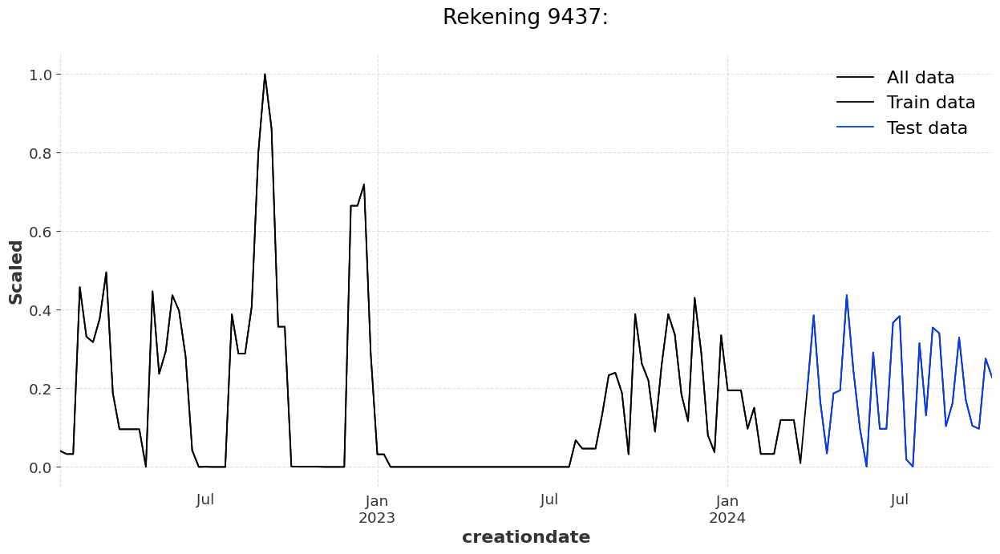

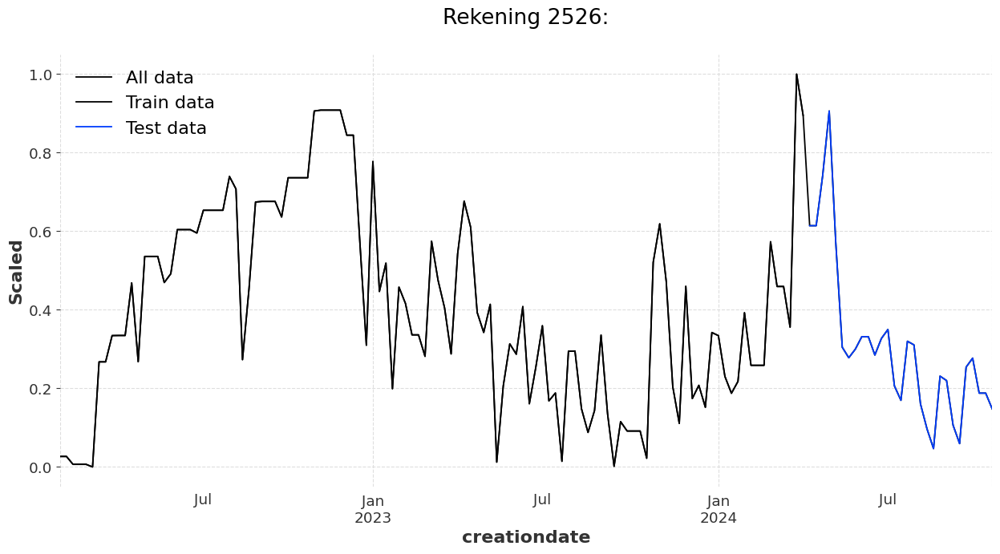

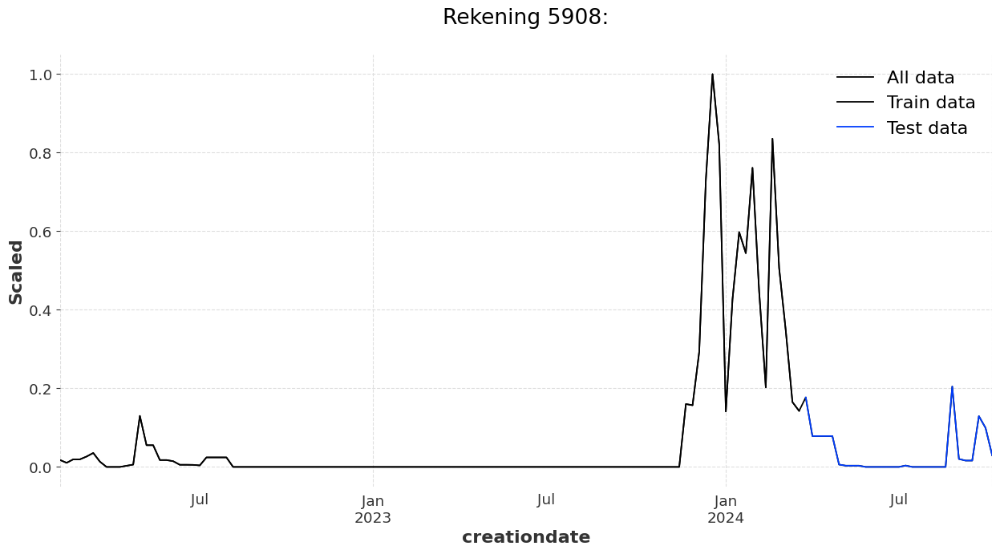

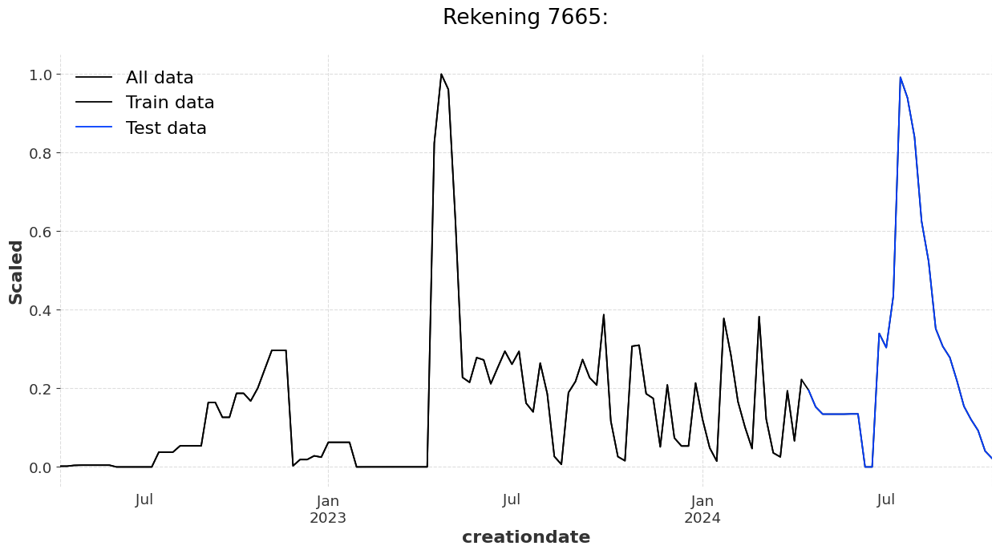

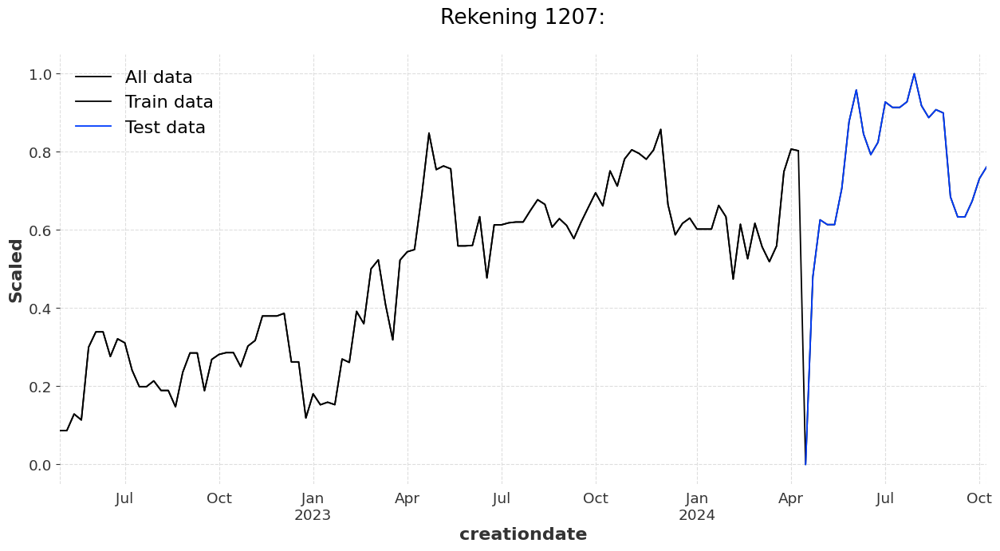

...

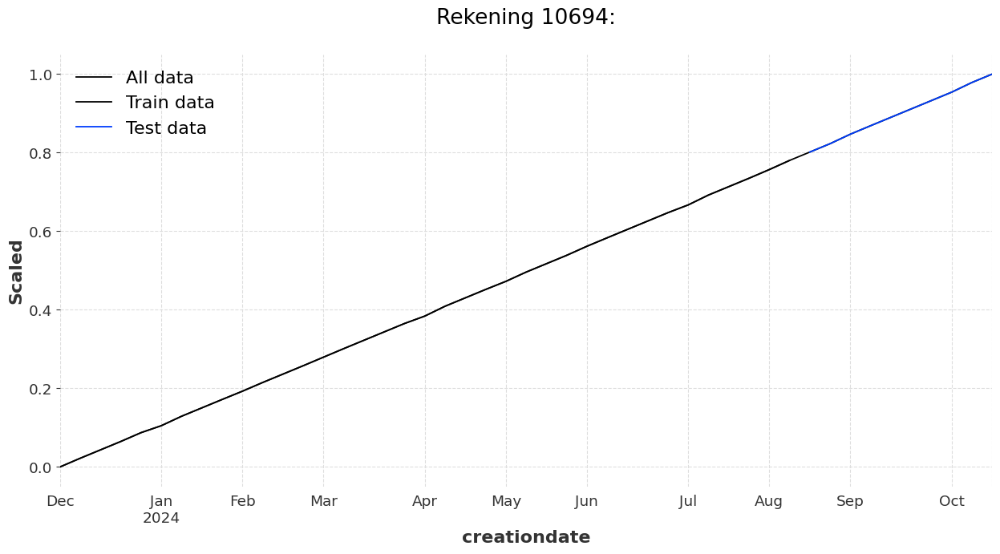

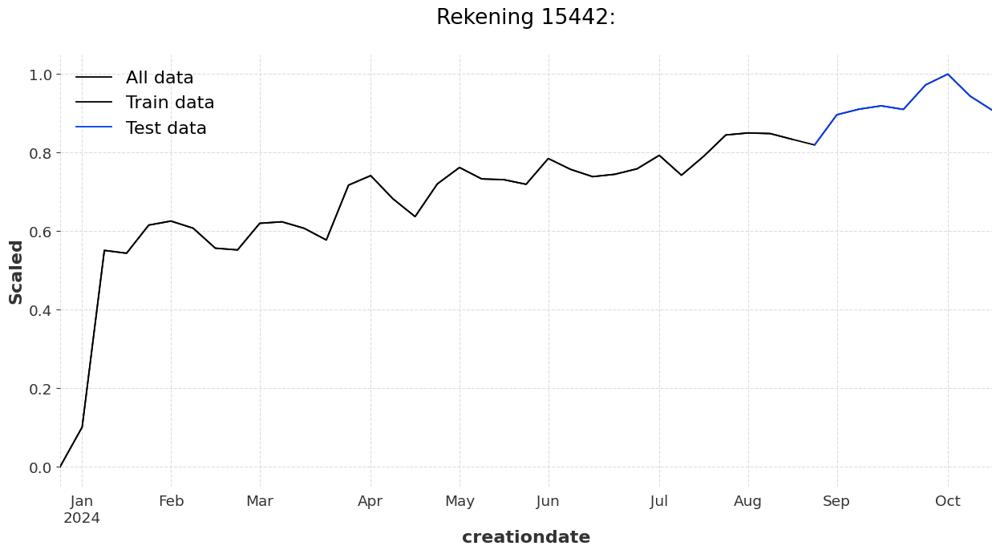

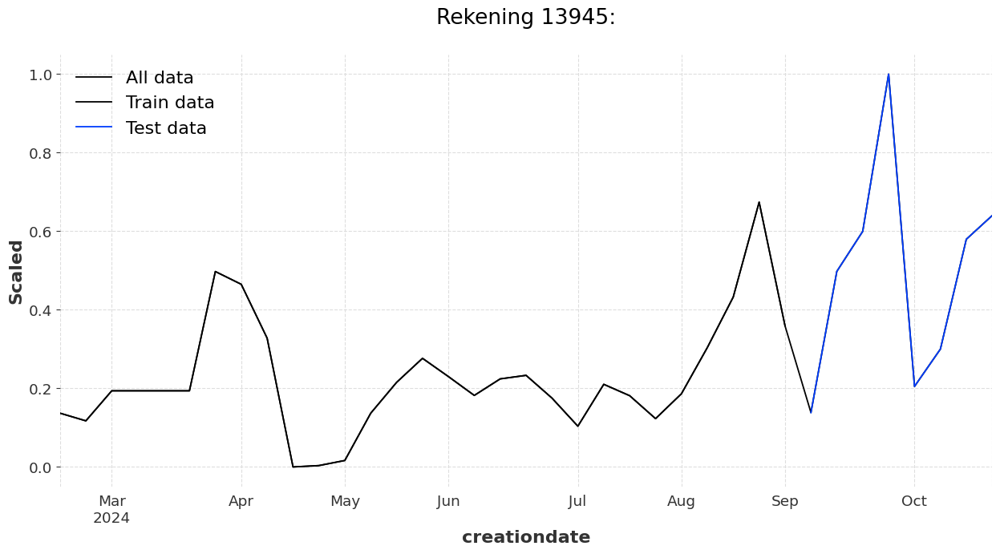

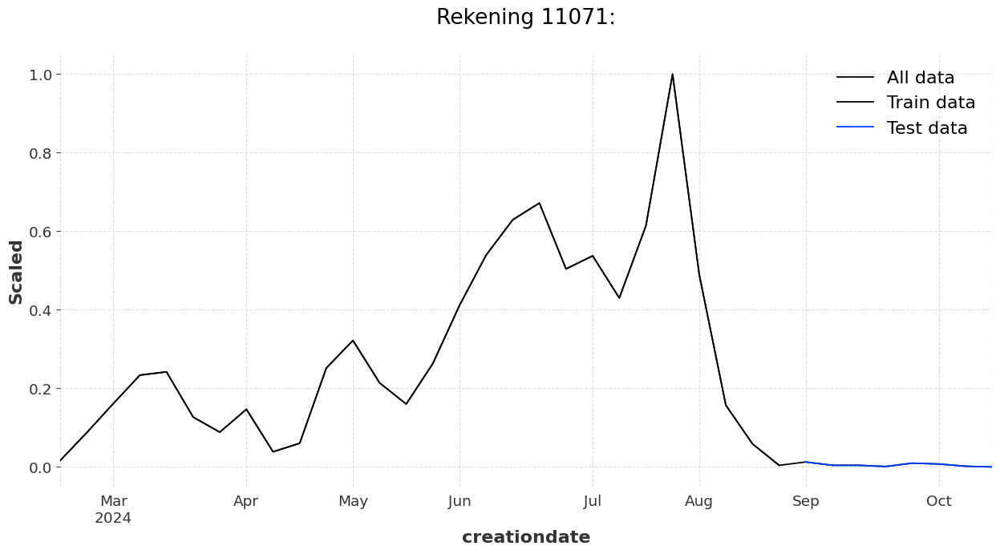

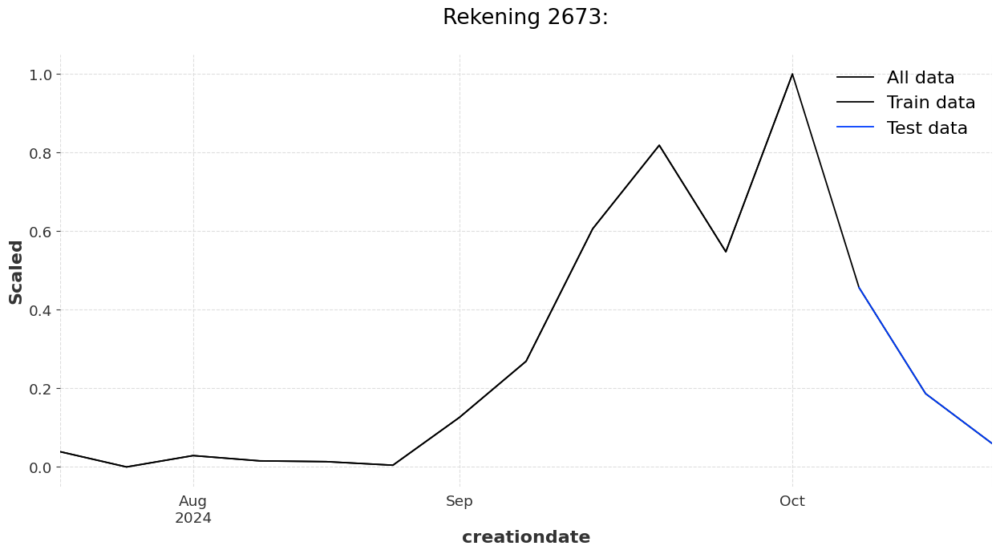

In [211]:
for rek, df in time_series_dict.items():
  ratio = 0.8
  train_size = int(ratio * len(df))
  test_size  = len(df) - train_size

  train = df.iloc[:train_size]
  test  = df.iloc[train_size:]


  fig = plt.subplots(figsize=(15, 7))
  df["y"]   .plot(label='All data',   color='black')
  train["y"].plot(label='Train data', color='C0')
  test["y"] .plot(label='Test data',  color='C1')
  plt.ylabel("Scaled")
  plt.title(f"Rekening {rek}:\n")
  plt.legend()

  plt.show()


In [212]:
def my_get_rmse(pred: pd.Series, true: pd.Series) -> pd.Series:

    y_pred = pred.values.reshape(-1, 1)
    y_true = true.values.reshape(-1, 1)
    y_error = y_true - y_pred
    rmses = np.sqrt(np.mean(y_error**2, axis=1))

    return pd.Series(rmses, index=pred.index)


In [213]:
def my_plot_results(pred_test: pd.Series) -> plt.figure:

    stl_true = sm.tsa.STL(test["balance"]).fit()
    stl_test = sm.tsa.STL(pred_test)  .fit()
    fig, axes = plt.subplots(4, 2, figsize=(15, 12), sharex=True)
    ax,  bx   = axes.transpose()[0], axes.transpose()[1]

    for i in range(4):
        ax[i].set_ylabel(["Original Data", "Trend", "Seasonal\n", "Residual"][i])

    ax[0].set_title("ax[0].set_title(name)")
    test["balance"]      .plot(ax=ax[0], c='black', label='Original Data')
    pred_test        .plot(ax=ax[0], c='C1'   , label='Prediction')

    stl_true.trend   .plot(ax=ax[1], c='black')
    stl_test.trend   .plot(ax=ax[1], c='C1')

    stl_true.seasonal.plot(ax=ax[2], c='black')
    stl_test.seasonal.plot(ax=ax[2], c='C1')

    stl_true.resid   .plot(ax=ax[3], c='black')
    stl_test.resid   .plot(ax=ax[3], c='C1')

    rmse_original = my_get_rmse(pred_test,         test["balance"])
    rmse_trend    = my_get_rmse(stl_test.trend,    stl_true.trend)
    rmse_seasonal = my_get_rmse(stl_test.seasonal, stl_true.seasonal)
    rmse_resid    = my_get_rmse(stl_test.resid,    stl_true.resid)

    bx[0].set_title("bx[0].set_title(name)")
    rmse_original.plot(ax=bx[0], c='C1')
    rmse_trend   .plot(ax=bx[1], c='C1')
    rmse_seasonal.plot(ax=bx[2], c='C1')
    rmse_resid   .plot(ax=bx[3], c='C1')

    ax[0].legend()
    plt.tight_layout()

    return fig, ax, bx


In [227]:
from darts.metrics import smape
from darts import TimeSeries
import joblib

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for ARMA and trend. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


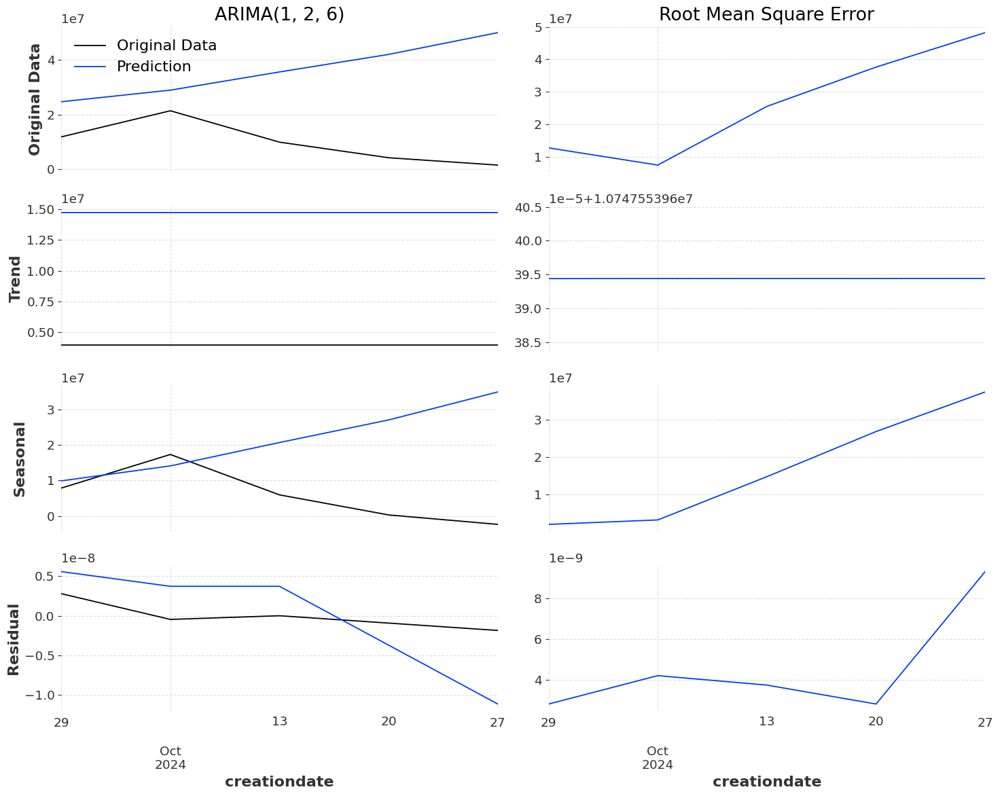

Nilai SMAPE = 11267.95%


In [255]:
p, d, q = 1, 2, 6
for rek, df in time_series_dict.items():
  if rek == 2673:
    ratio = 0.7
    train_size = int(ratio * len(df))
    test_size  = len(df) - train_size

    train = df.iloc[:train_size]
    test  = df.iloc[train_size:]

    if len(train) <= (p + d + q):
      print(f"Insufficient data for Rekening {rek}. Skipping...")
      continue

    arima = sm.tsa.SARIMAX(train["y"].values,
                          order=(p, d, q)
                          ).fit(maxiter=1000)

    pred_val = arima.forecast(test_size)

    pred_test = pd.Series(pred_val * scale[rek] + min_val[rek],
                          index=test.index)

    fig, ax, bx = my_plot_results(pred_test)

    filename = f'arima_model.{rek}'
    joblib.dump(arima, filename)

    ax[0].set_title(f"ARIMA{(p, d, q)}")
    bx[0].set_title("Root Mean Square Error")
    plt.show()
    gt = TimeSeries.from_values(test['balance'])
    pred = TimeSeries.from_values(pred_test)

    skor = smape(gt, pred)
    print(f"Nilai SMAPE = {skor:.2%}")

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'


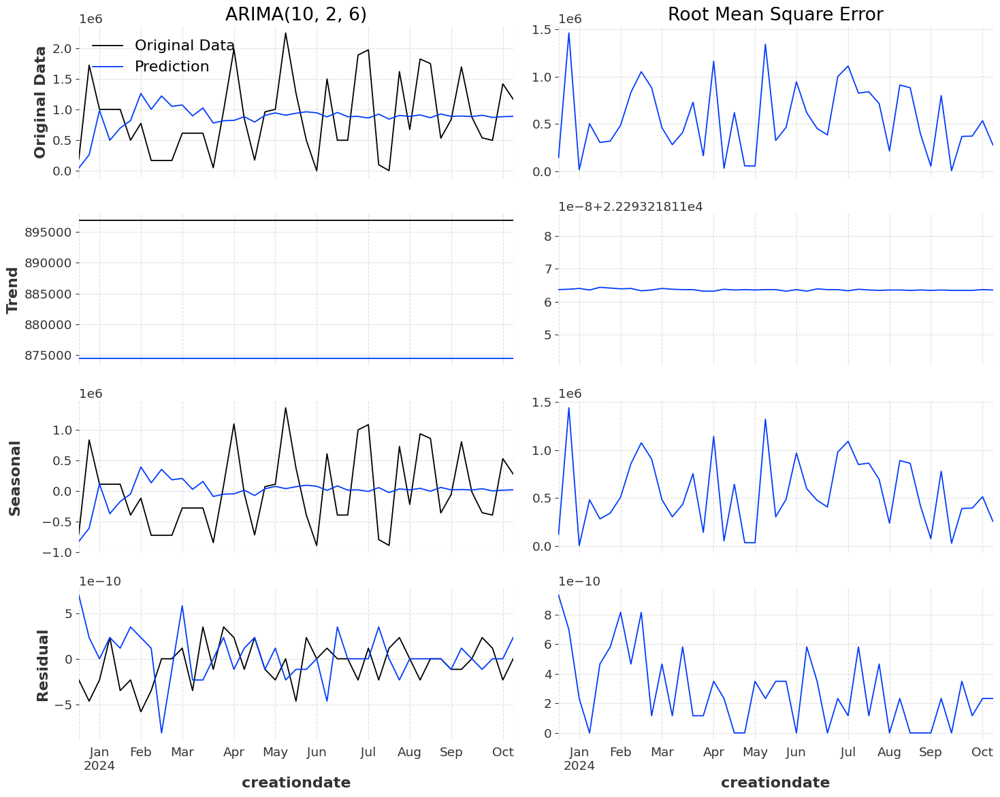

Nilai SMAPE = 7064.51%


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'


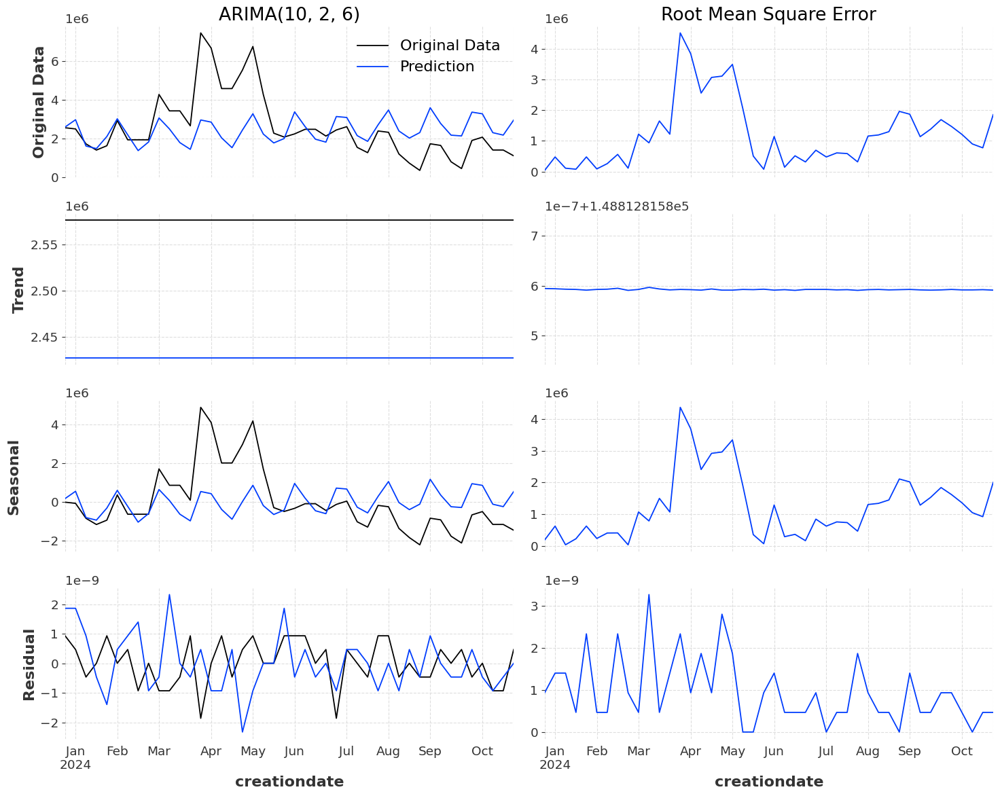

Nilai SMAPE = 4704.16%


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'


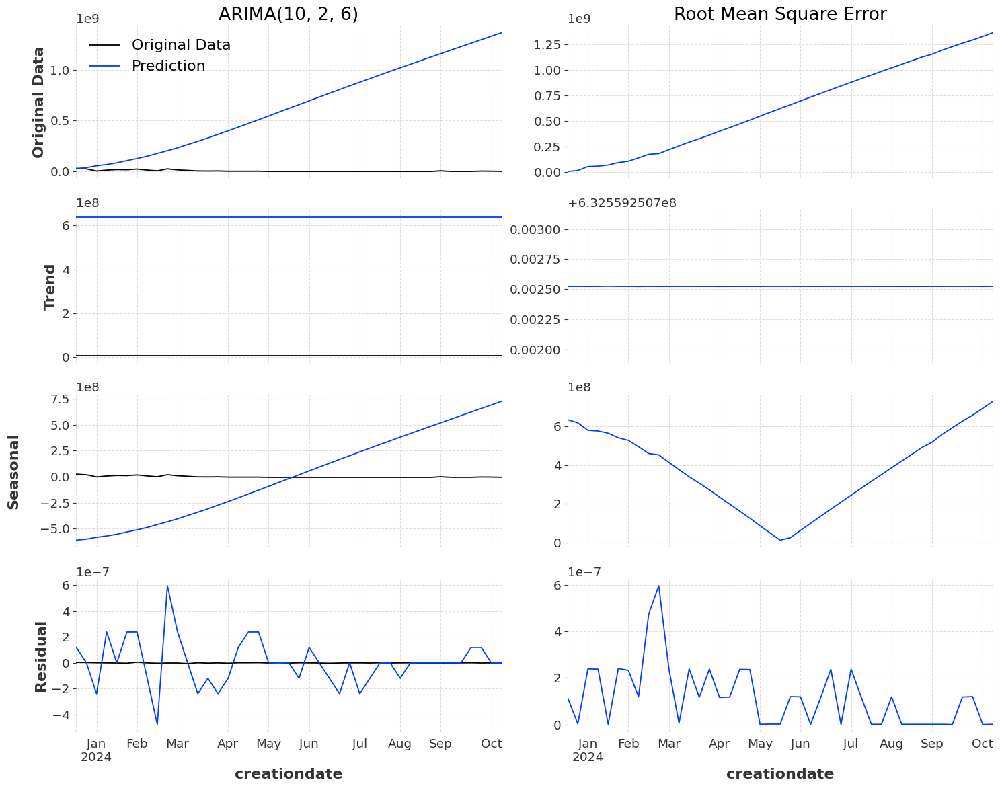

Nilai SMAPE = 18150.86%


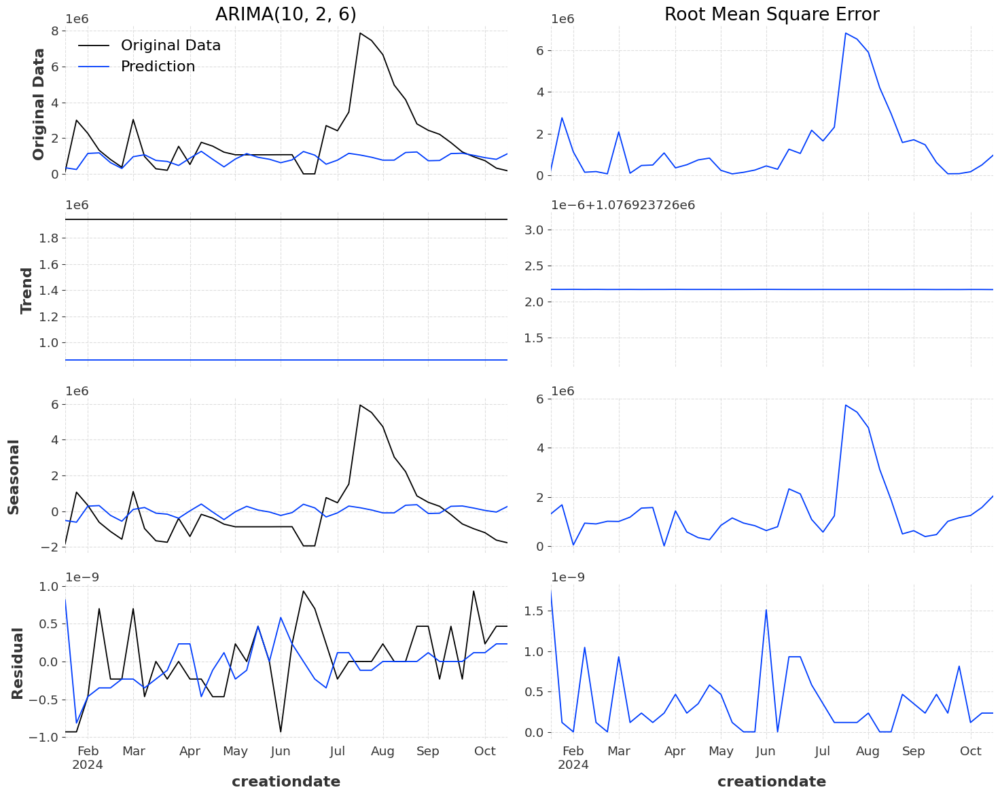

Nilai SMAPE = 8170.83%


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'


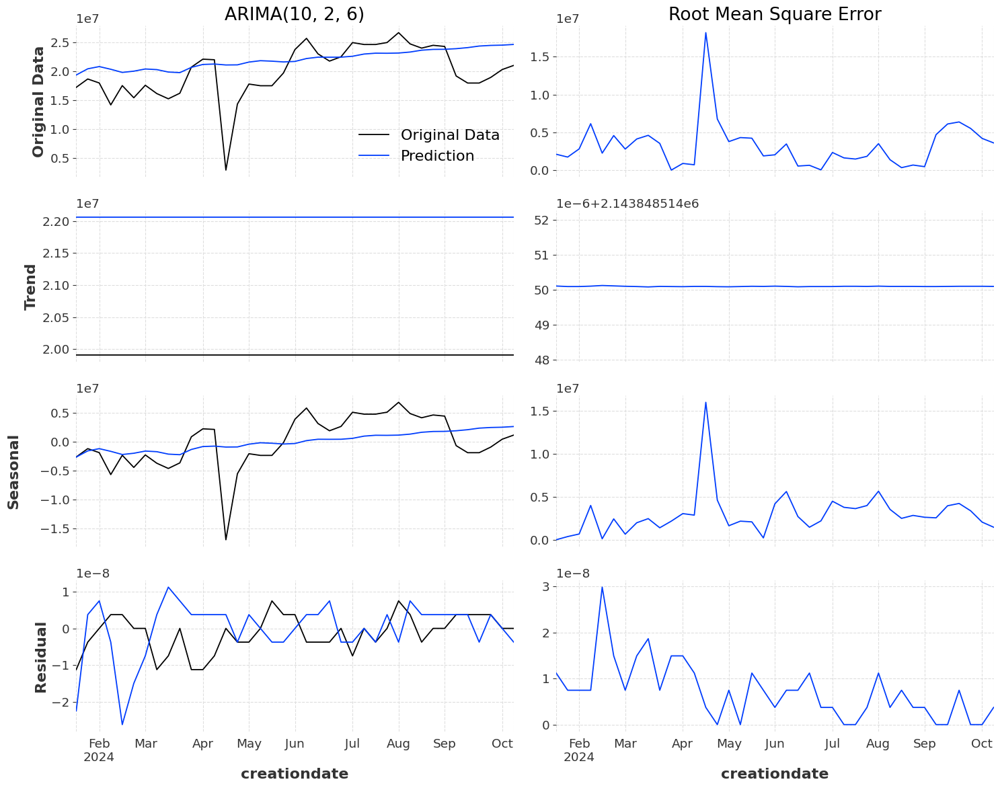

Nilai SMAPE = 1768.29%


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'


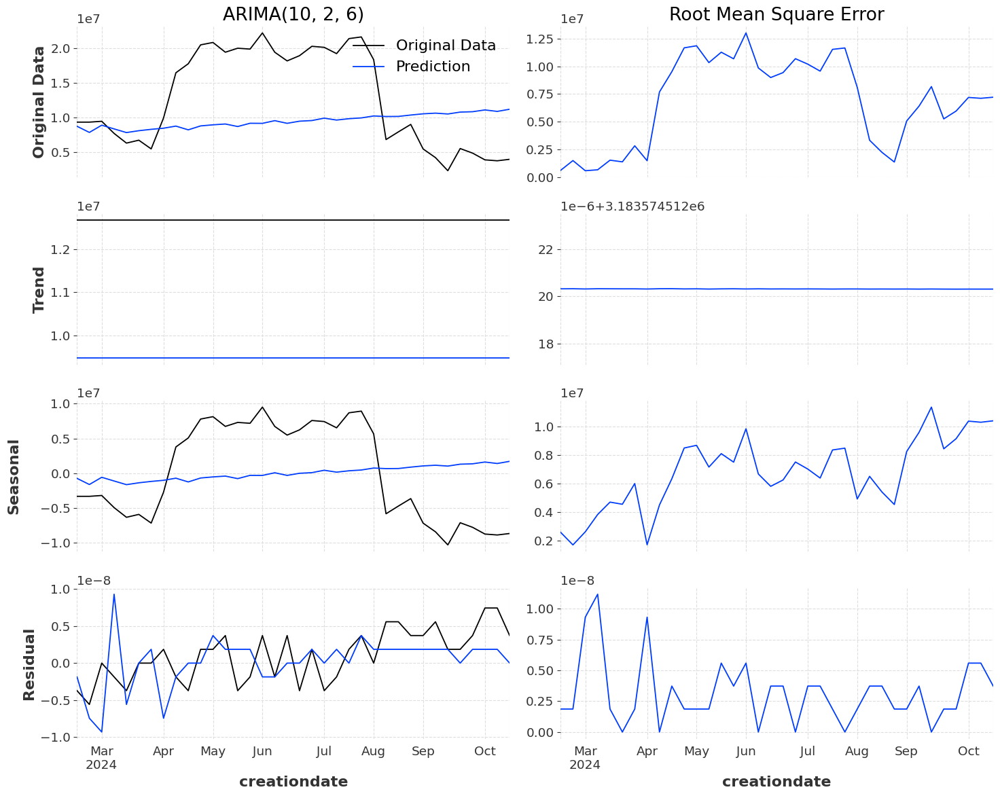

Nilai SMAPE = 5921.34%


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'


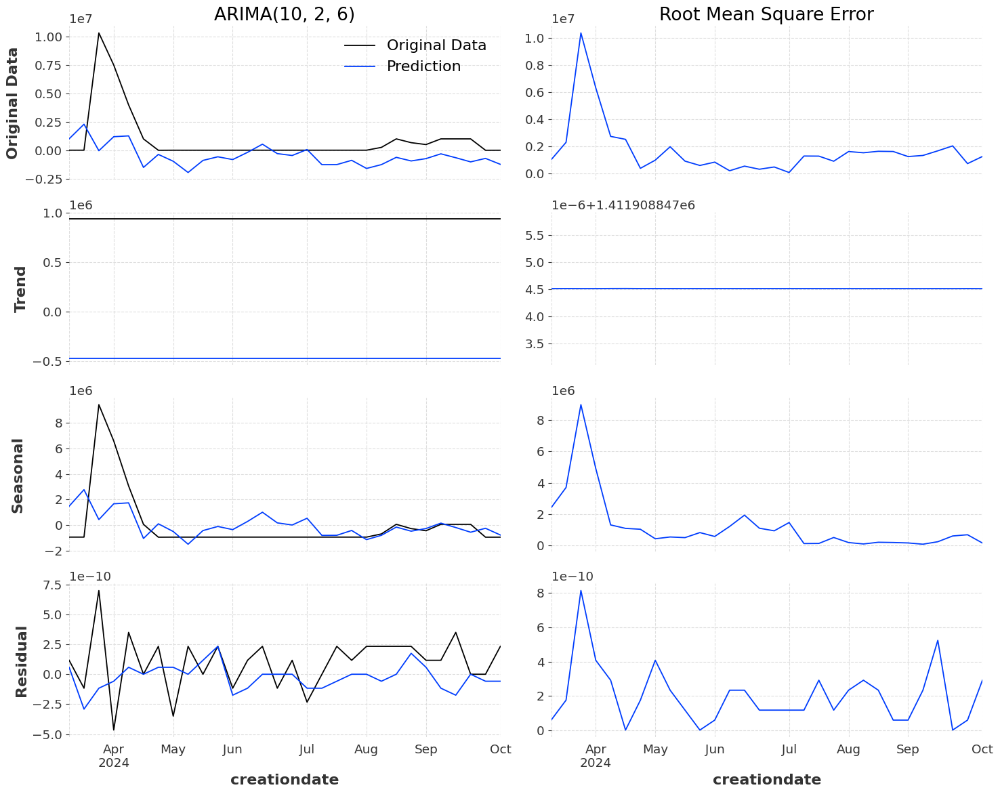

Nilai SMAPE = 19344.45%


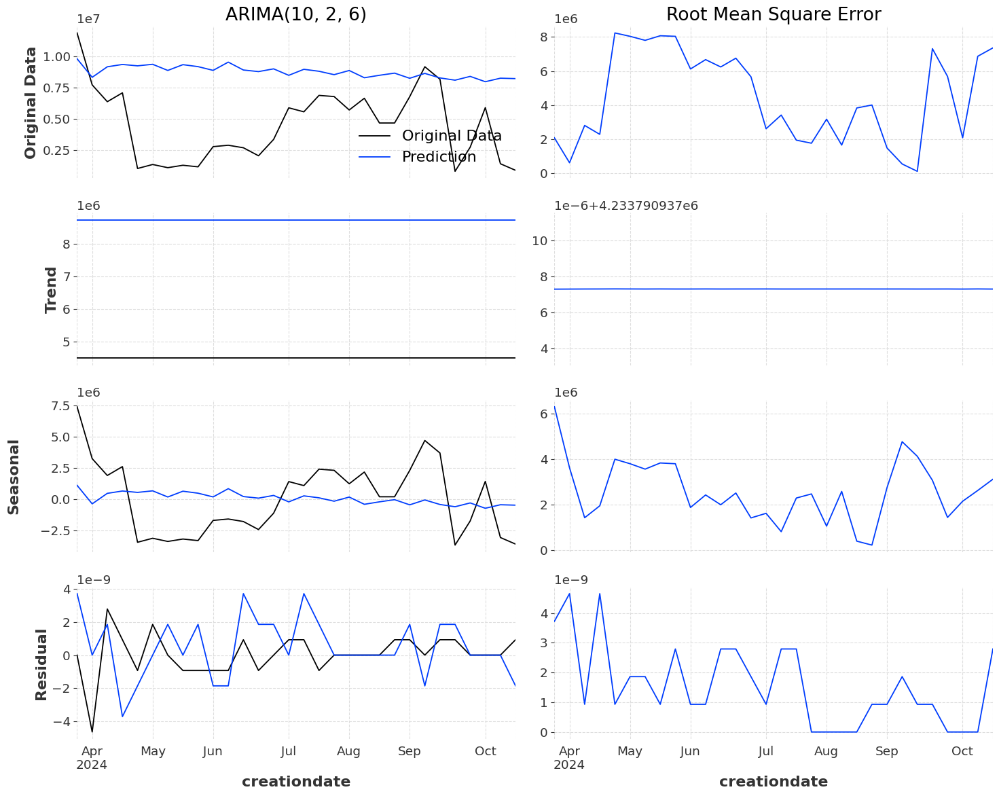

Nilai SMAPE = 7791.07%


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'


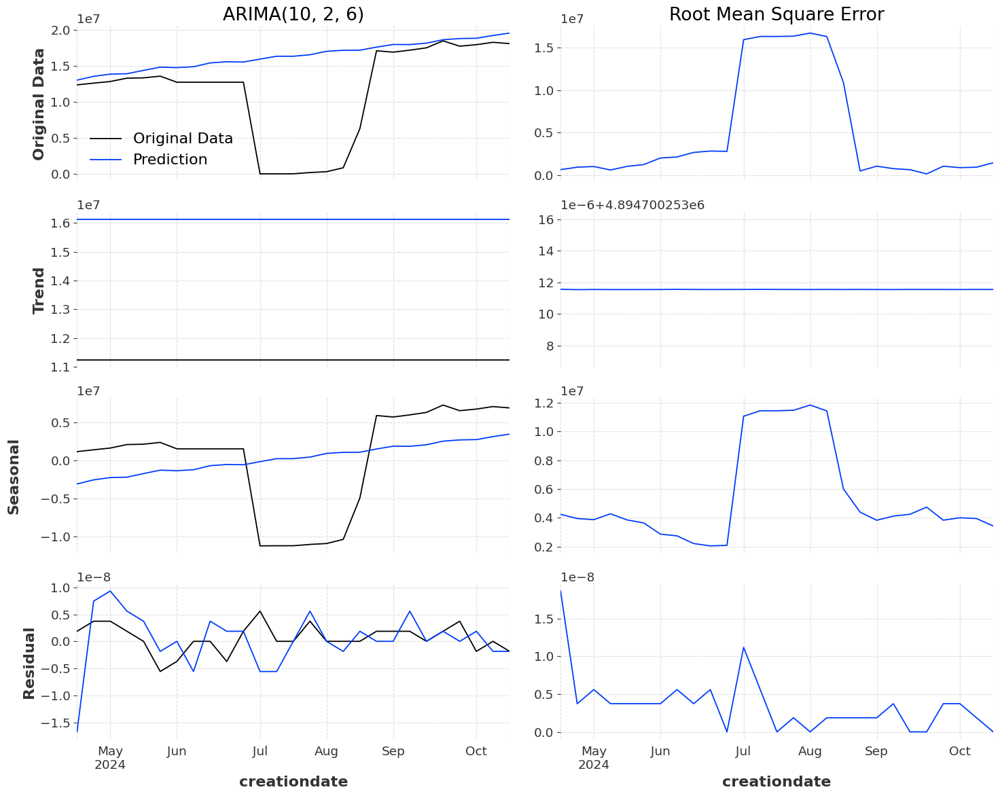

Nilai SMAPE = 5304.16%


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'


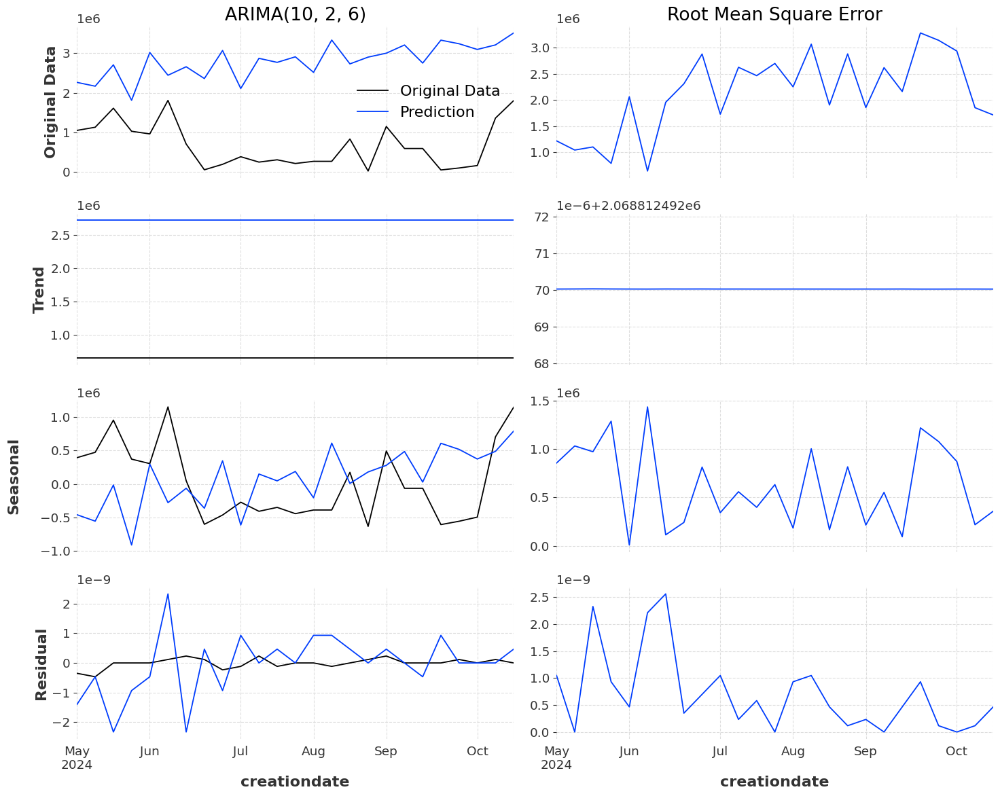

Nilai SMAPE = 12809.88%


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'


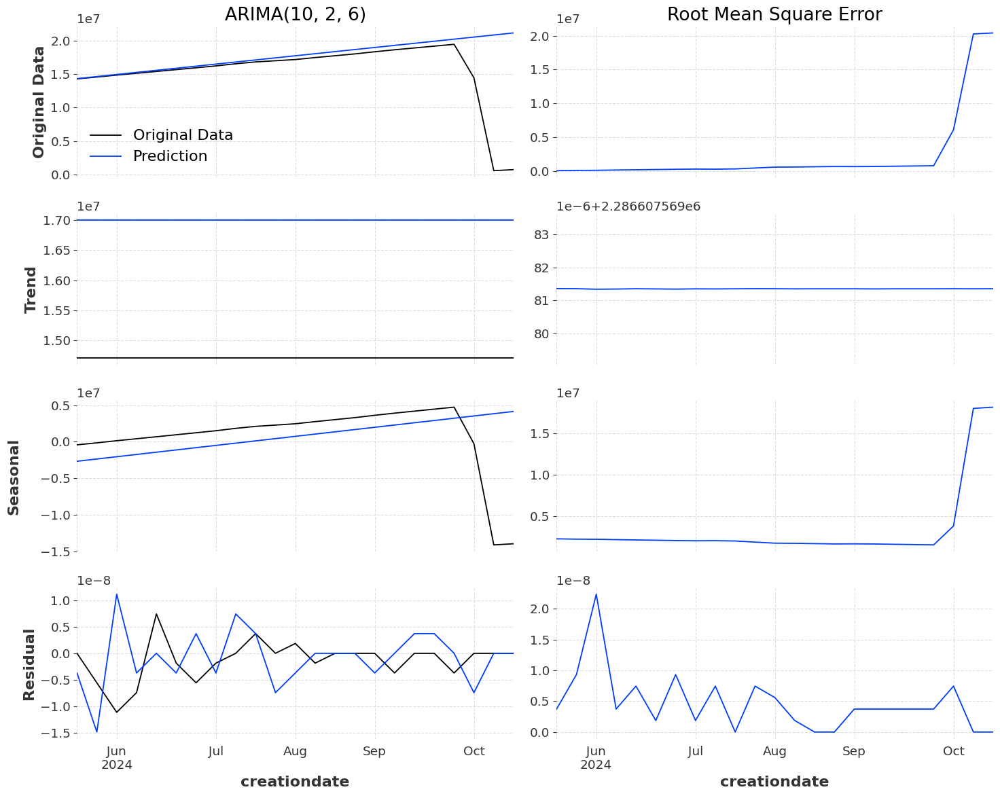

Nilai SMAPE = 1981.26%


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'


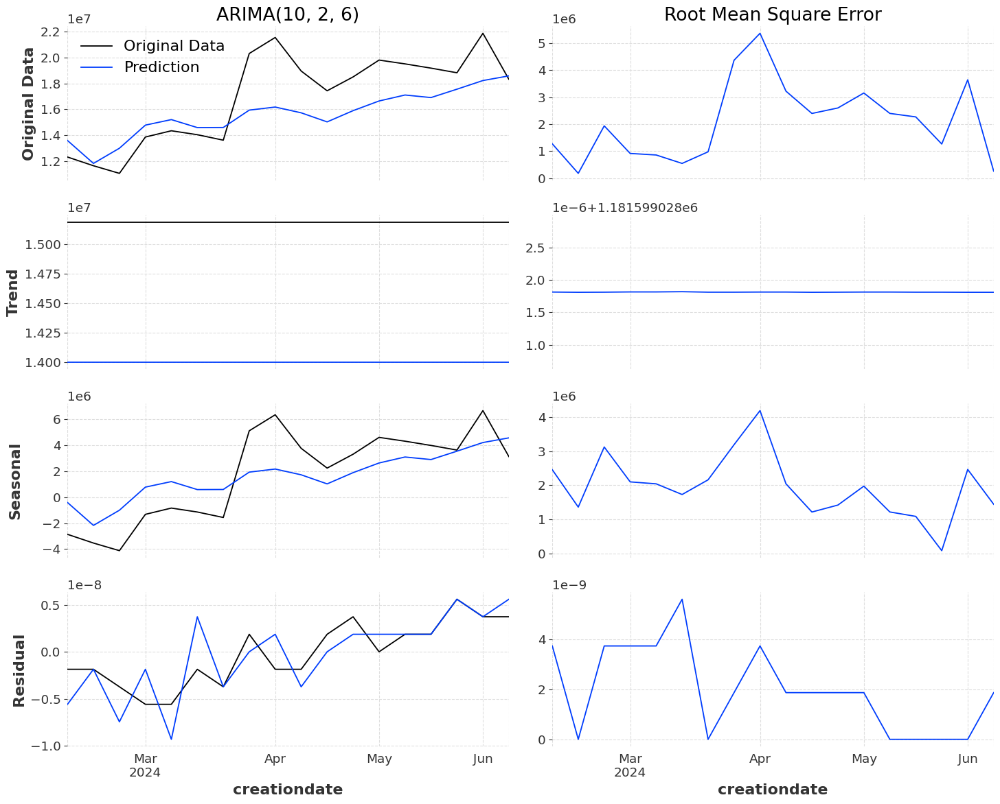

Nilai SMAPE = 1229.12%


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'


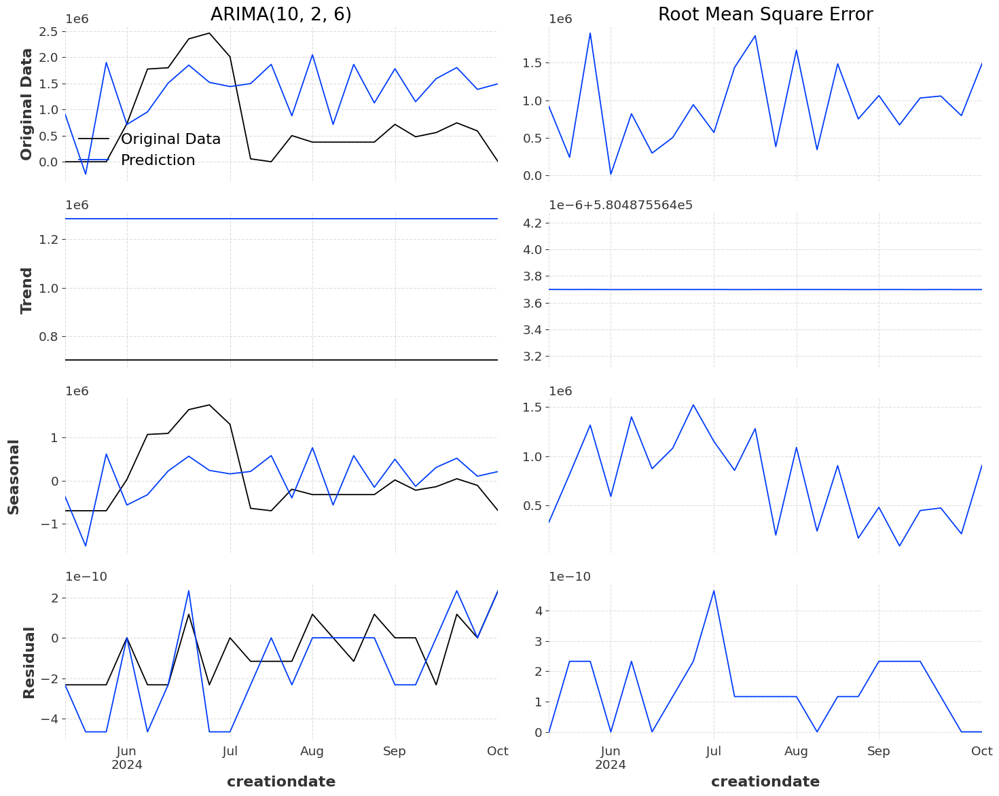

Nilai SMAPE = 10366.49%


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'


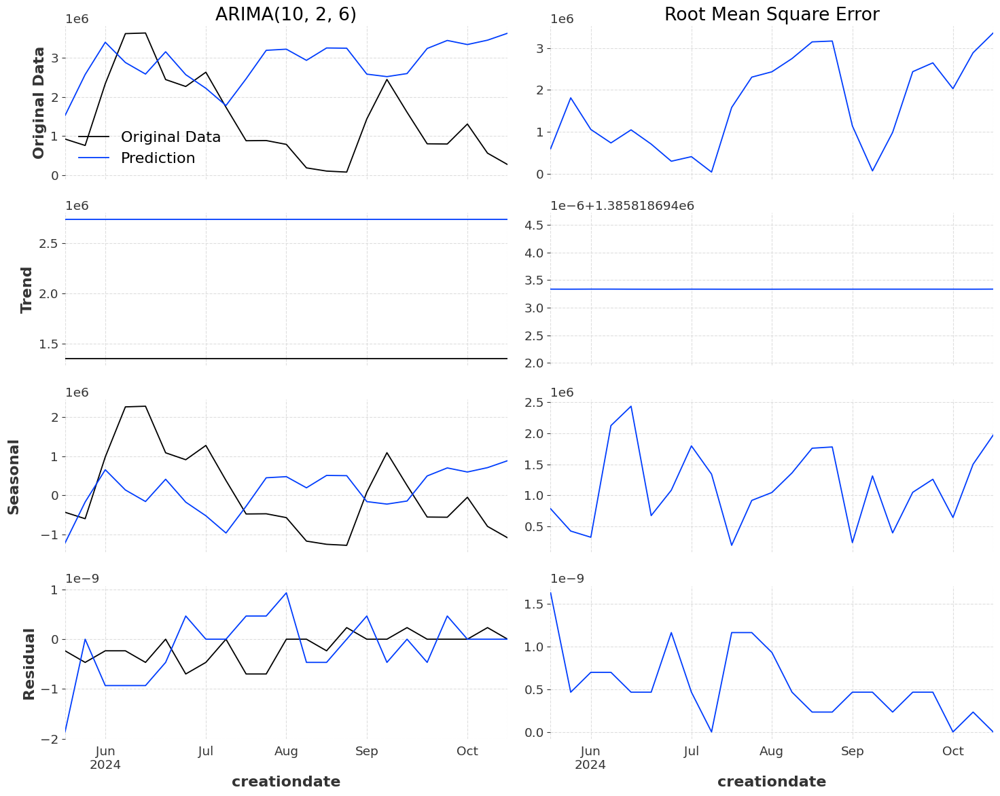

Nilai SMAPE = 8481.24%


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'


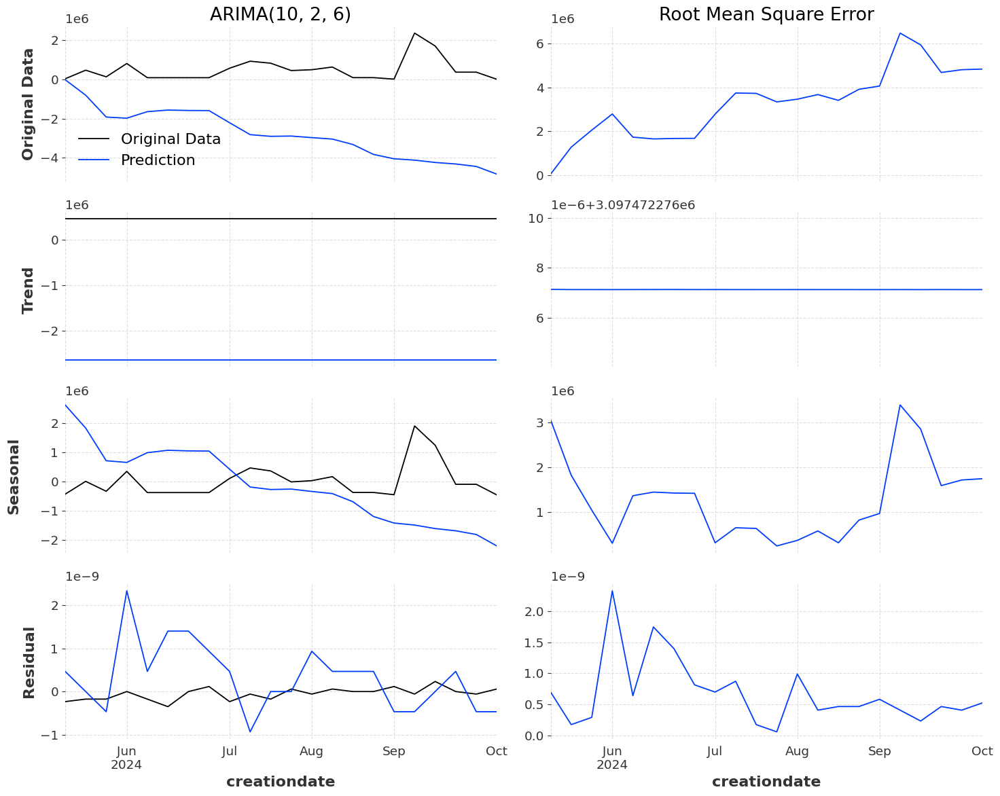

Nilai SMAPE = 20000.00%


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'


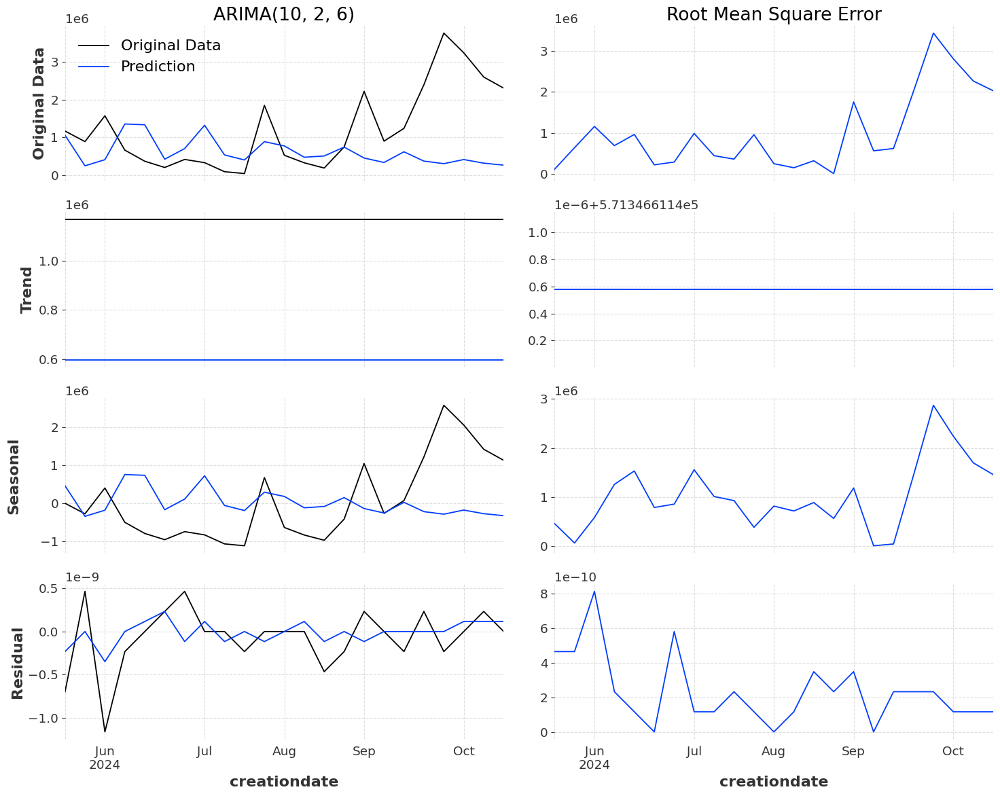

Nilai SMAPE = 9810.08%


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'


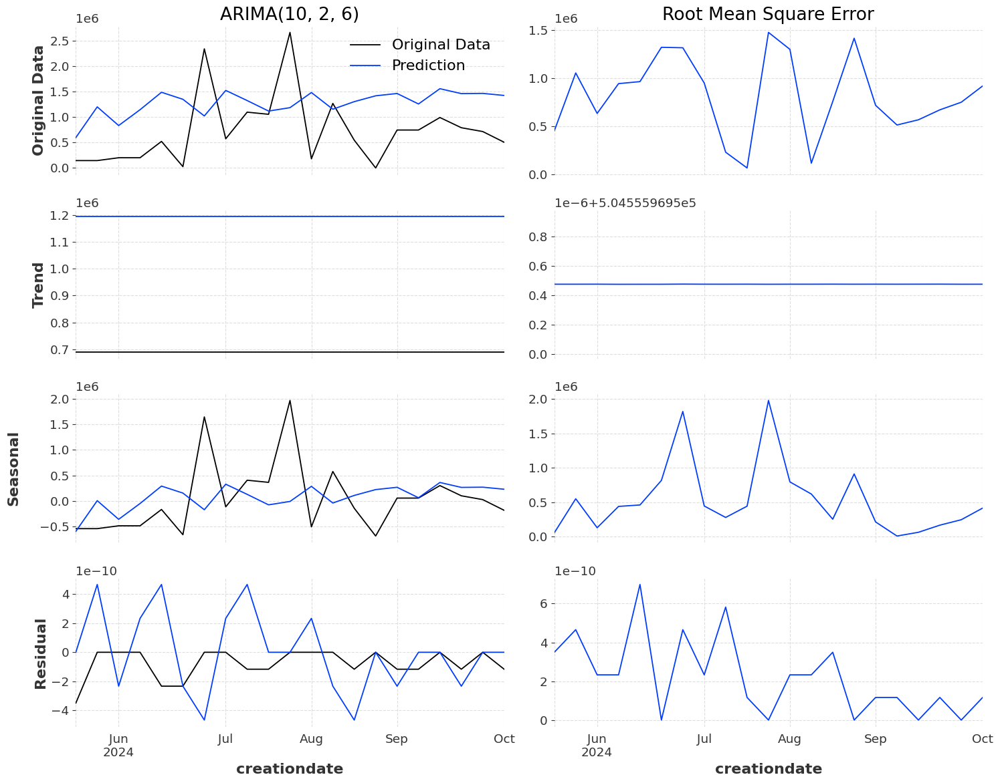

Nilai SMAPE = 9191.14%


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'


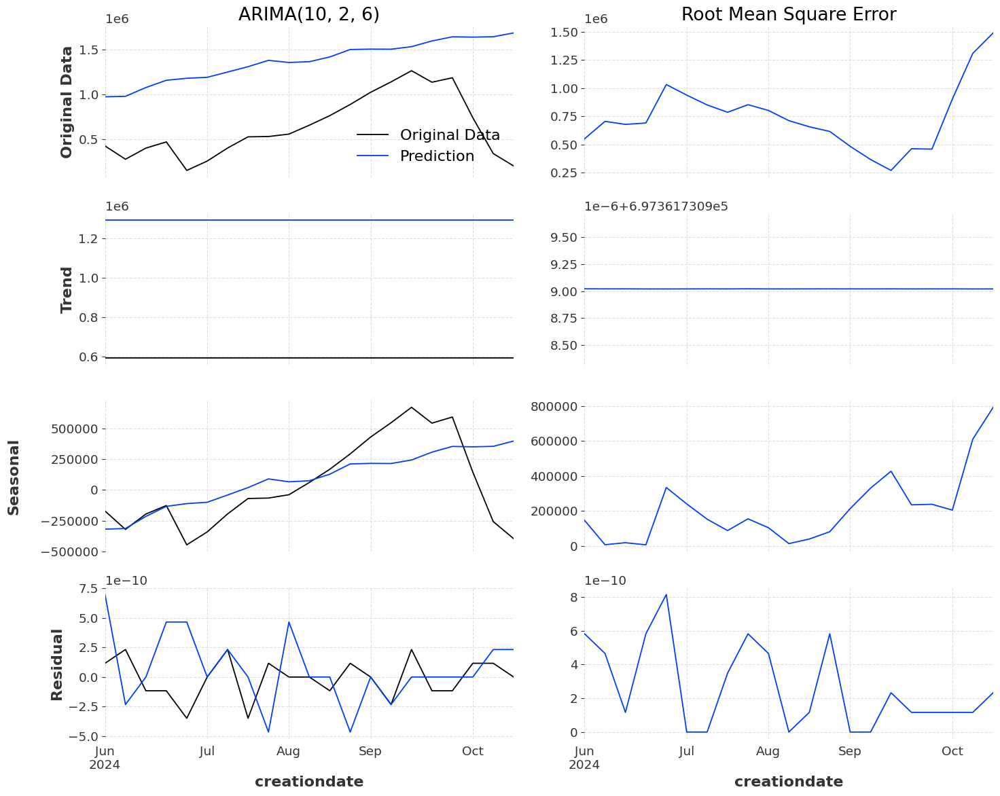

Nilai SMAPE = 8158.48%


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'


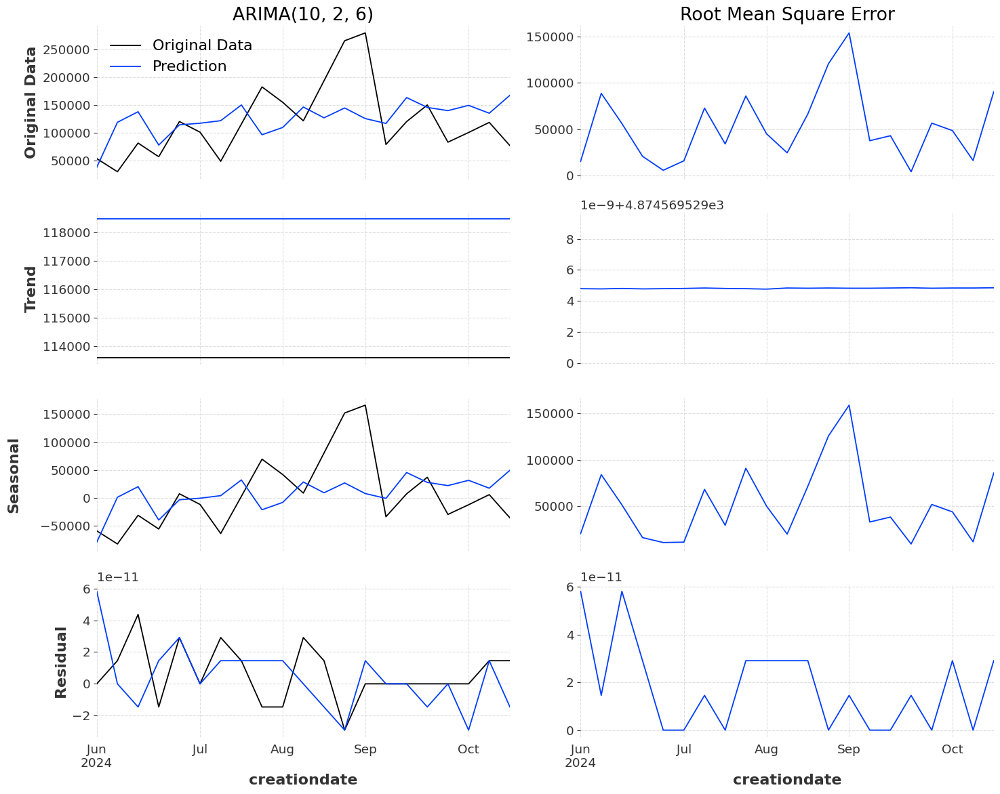

Nilai SMAPE = 4295.71%


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'


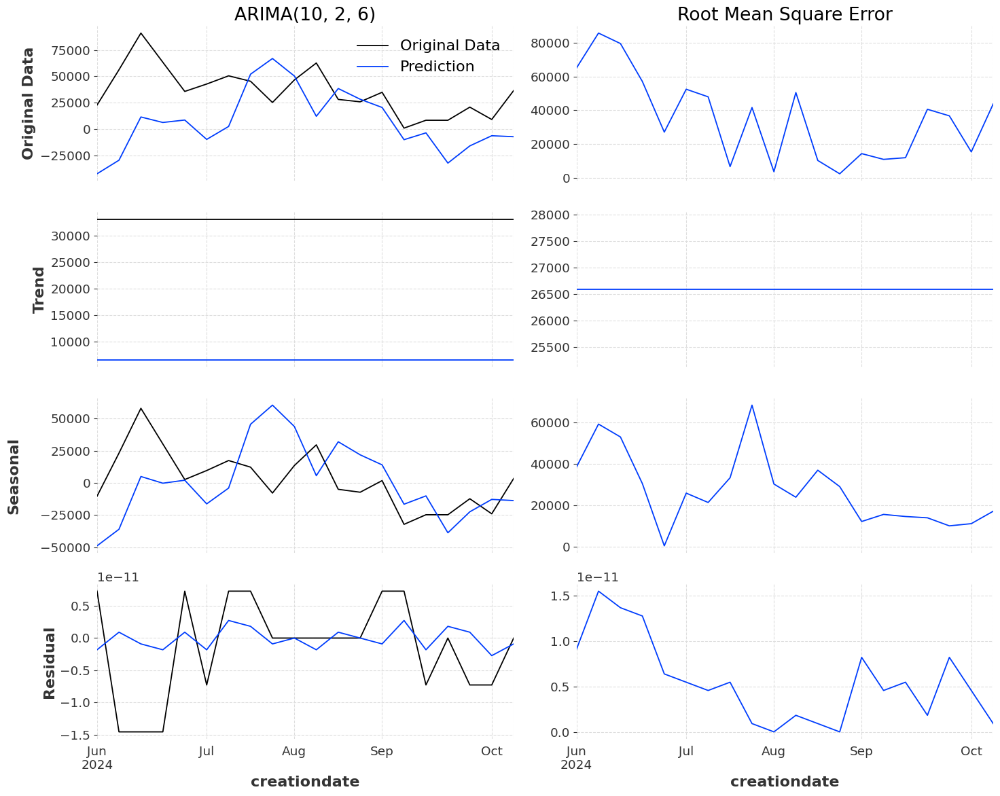

Nilai SMAPE = 13795.29%


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'


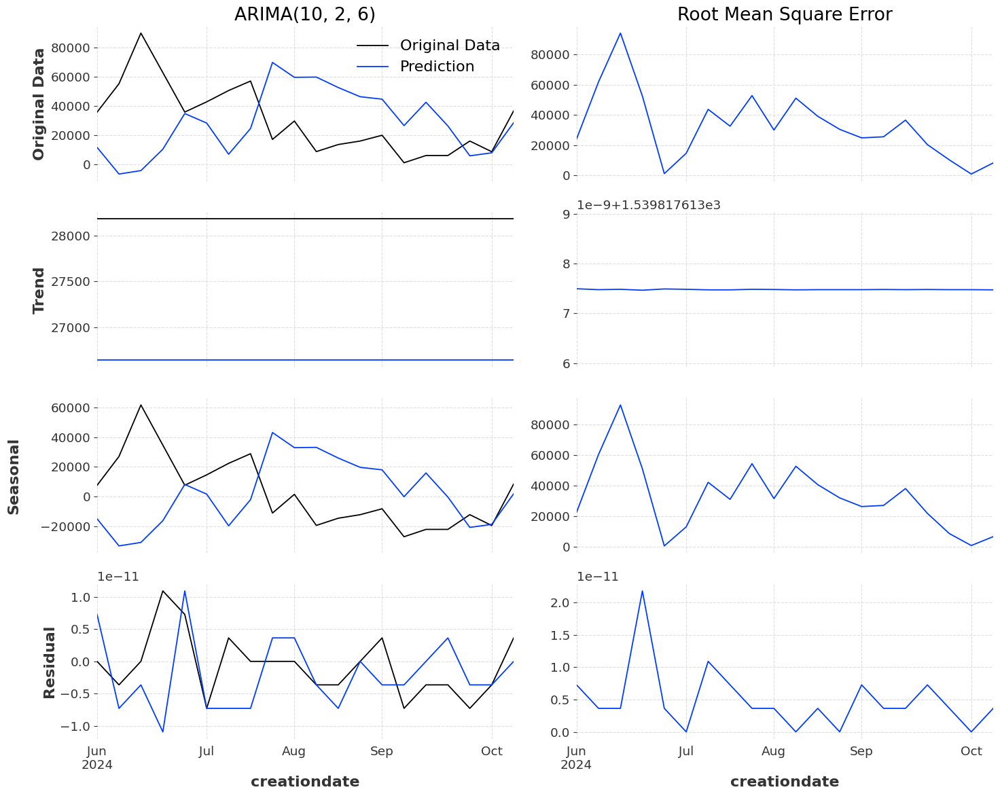

Nilai SMAPE = 10704.55%


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'


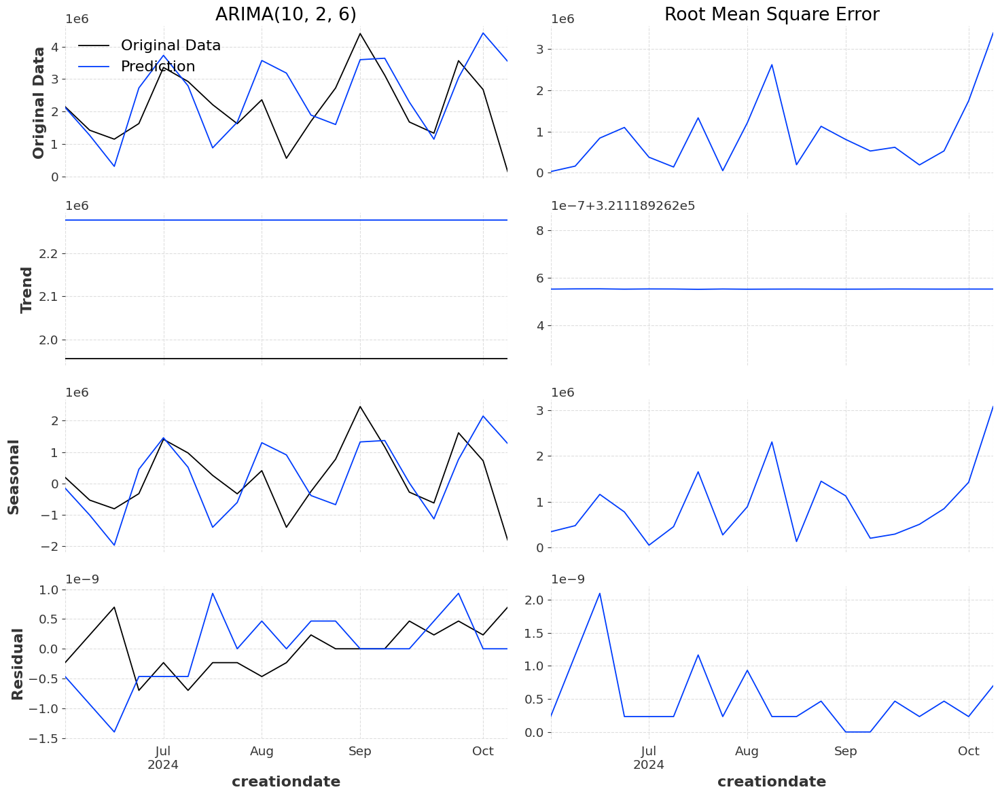

Nilai SMAPE = 4500.27%


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'


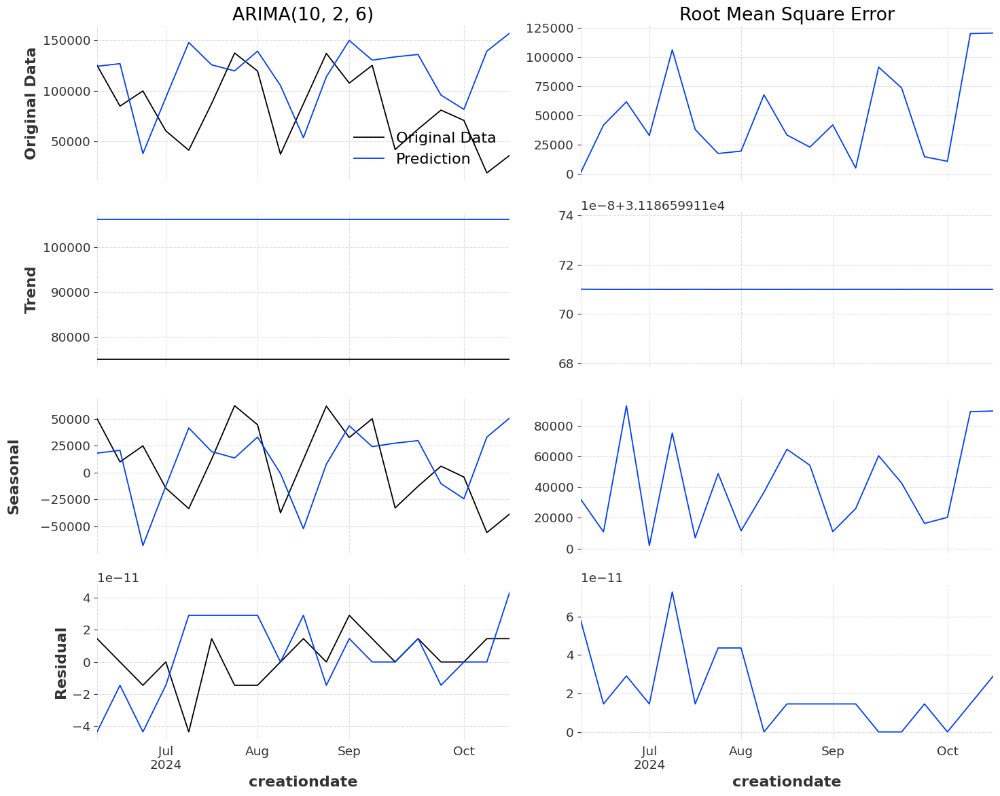

Nilai SMAPE = 5446.21%


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'


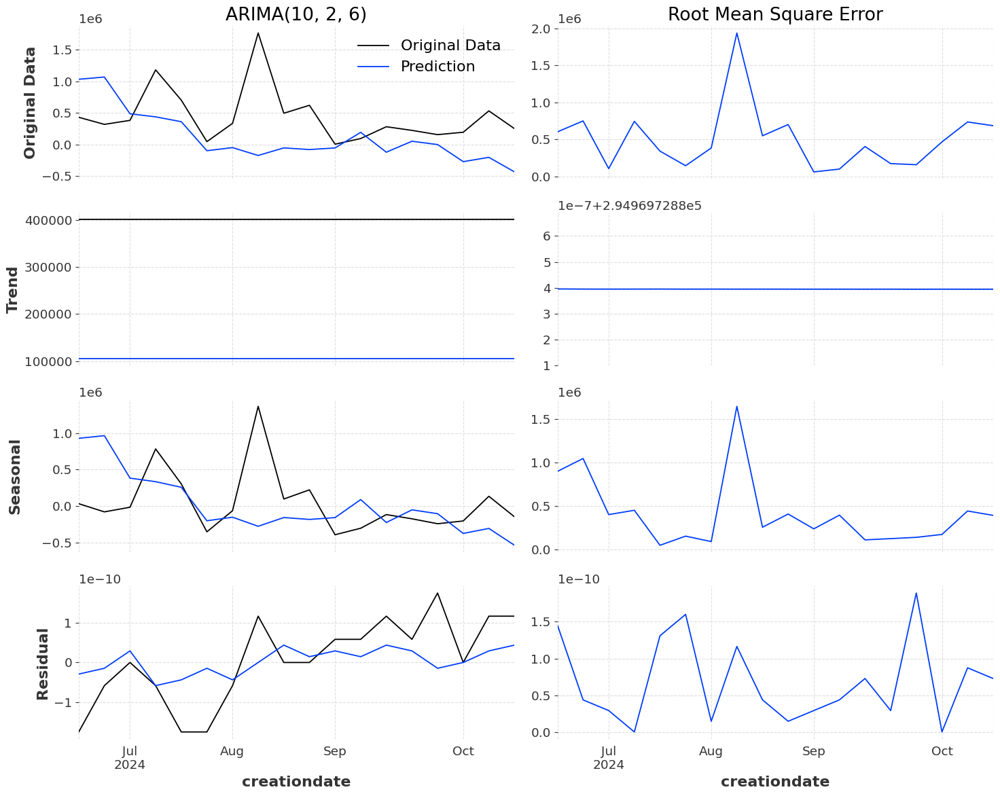

Nilai SMAPE = 15337.14%


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'


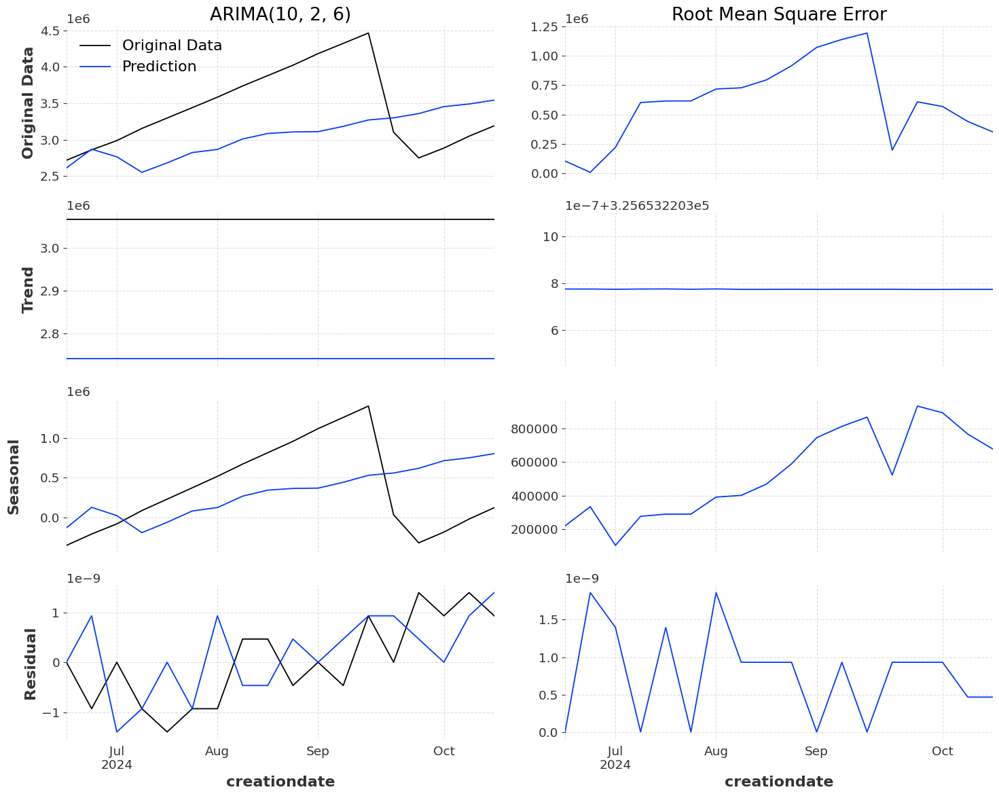

Nilai SMAPE = 1802.15%


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'


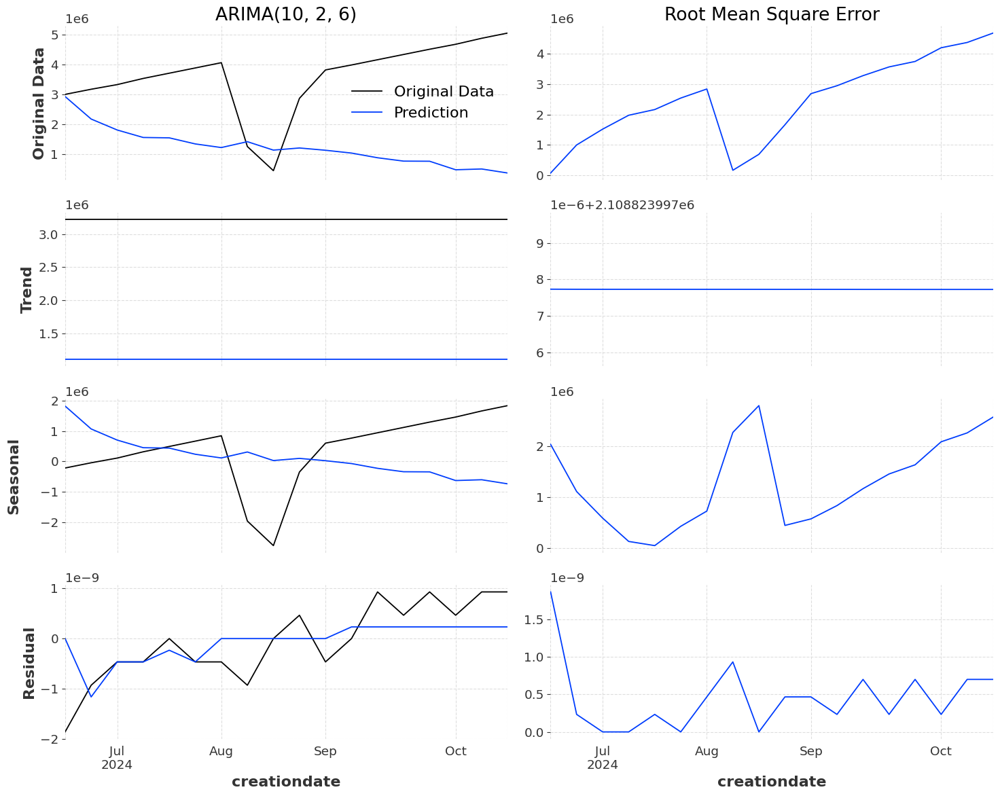

Nilai SMAPE = 9865.83%


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'


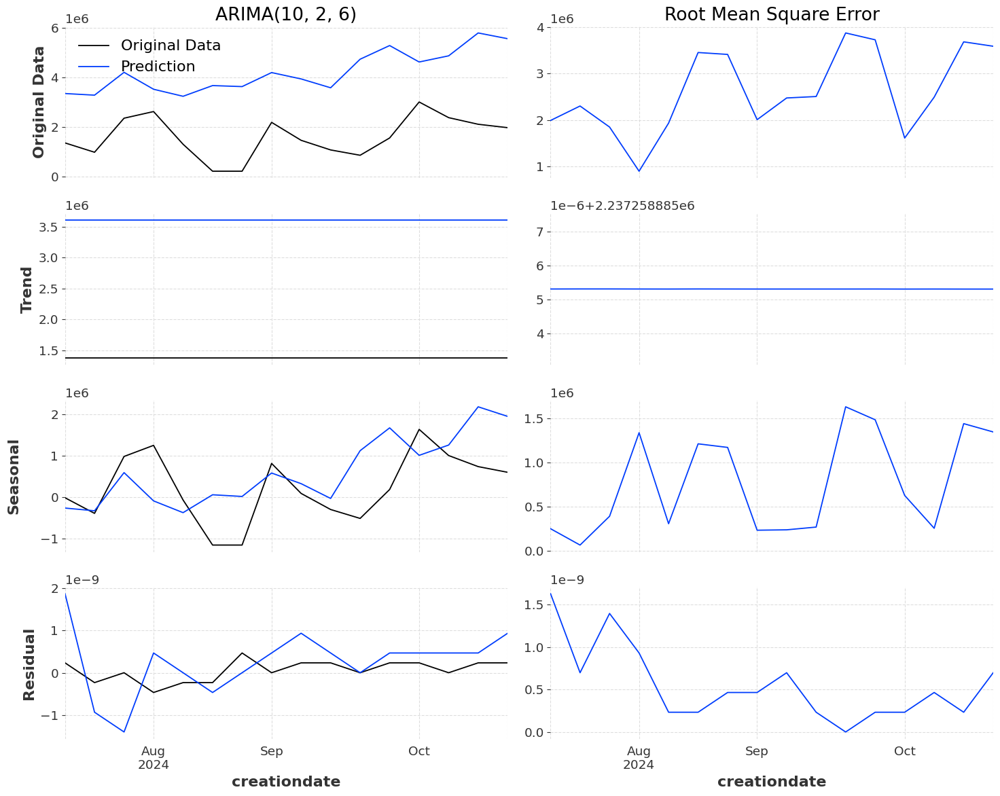

Nilai SMAPE = 9544.48%


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'


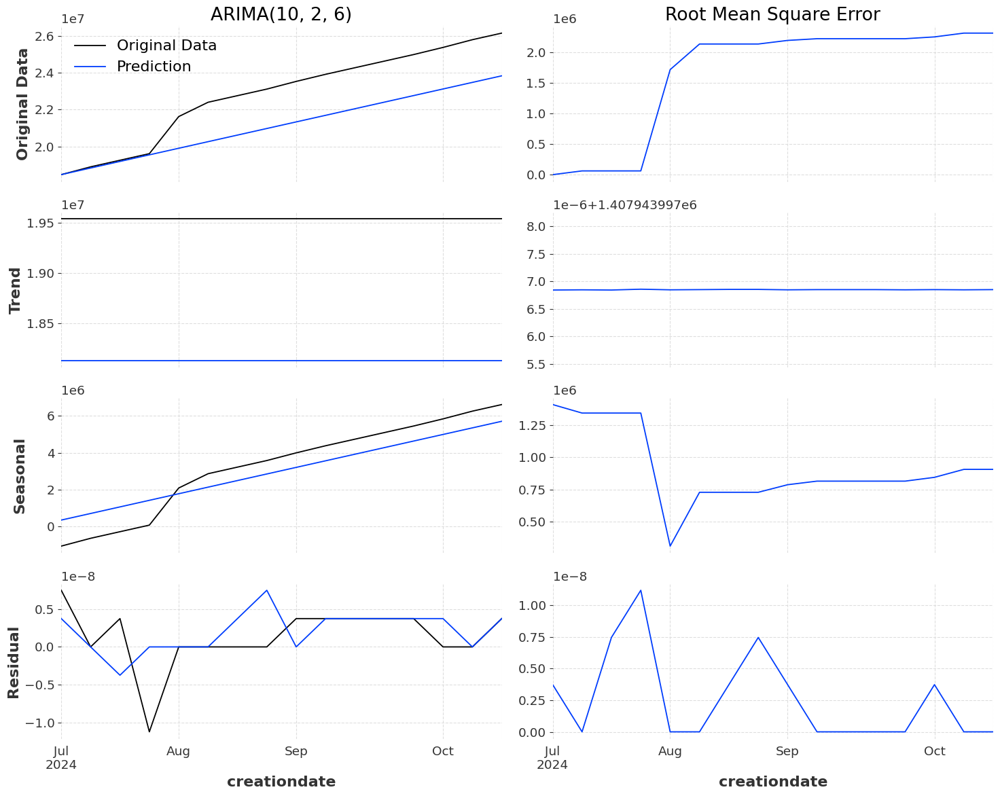

Nilai SMAPE = 716.77%


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'


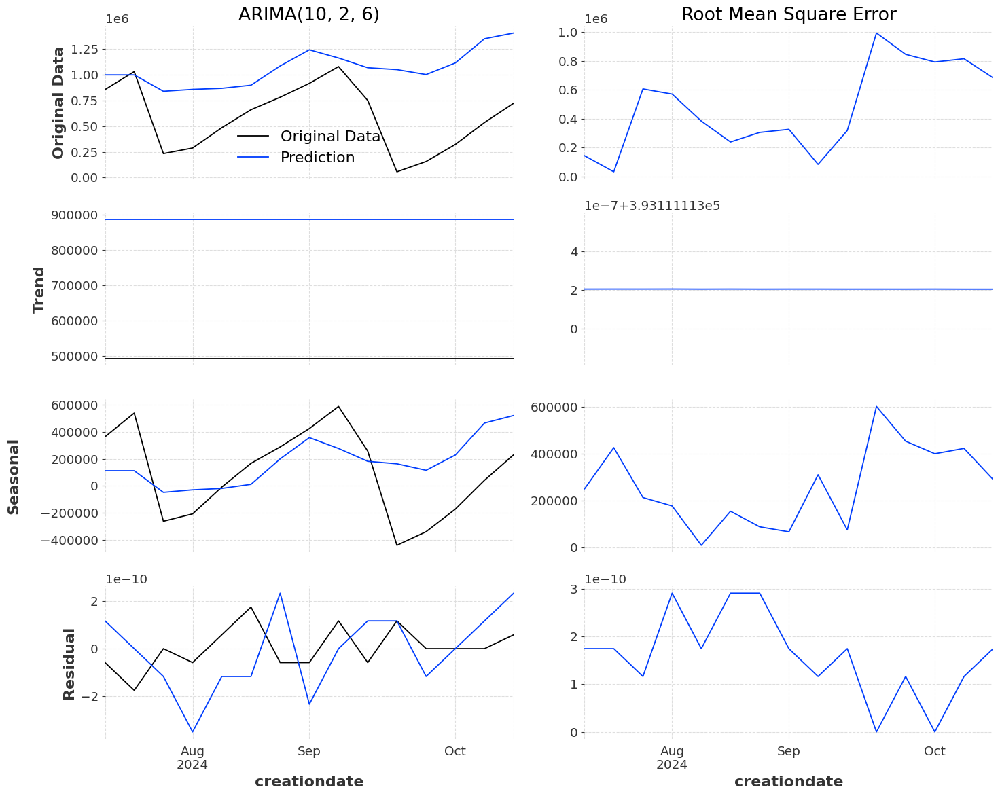

Nilai SMAPE = 6741.86%


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'


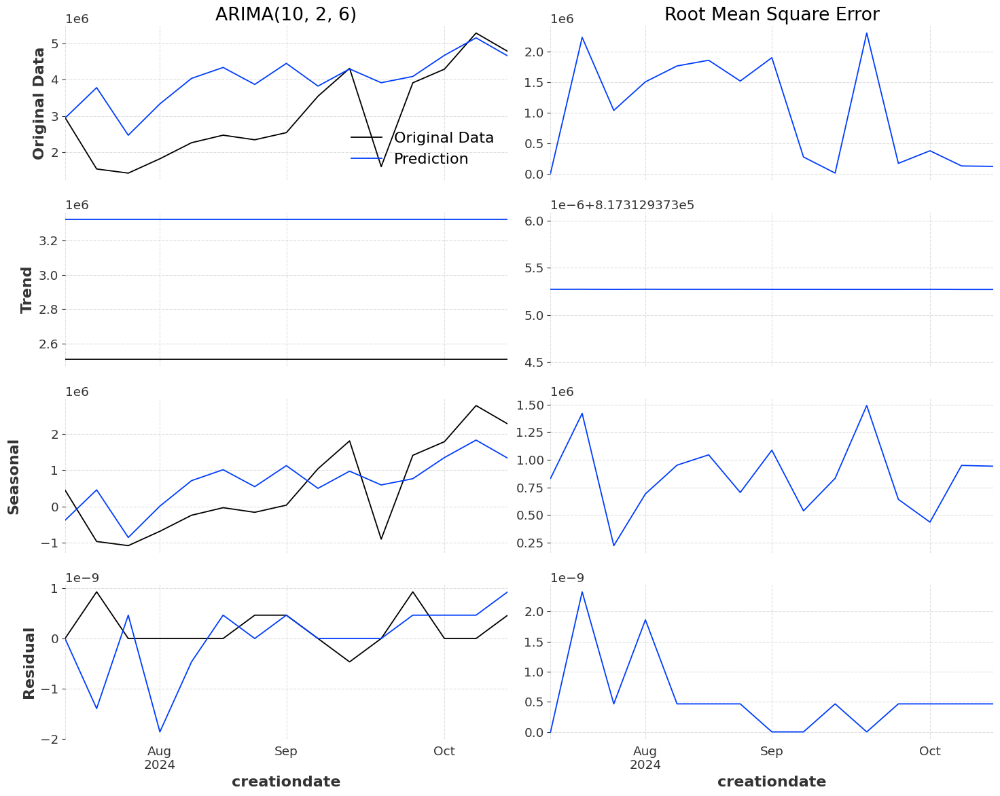

Nilai SMAPE = 3470.21%


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'


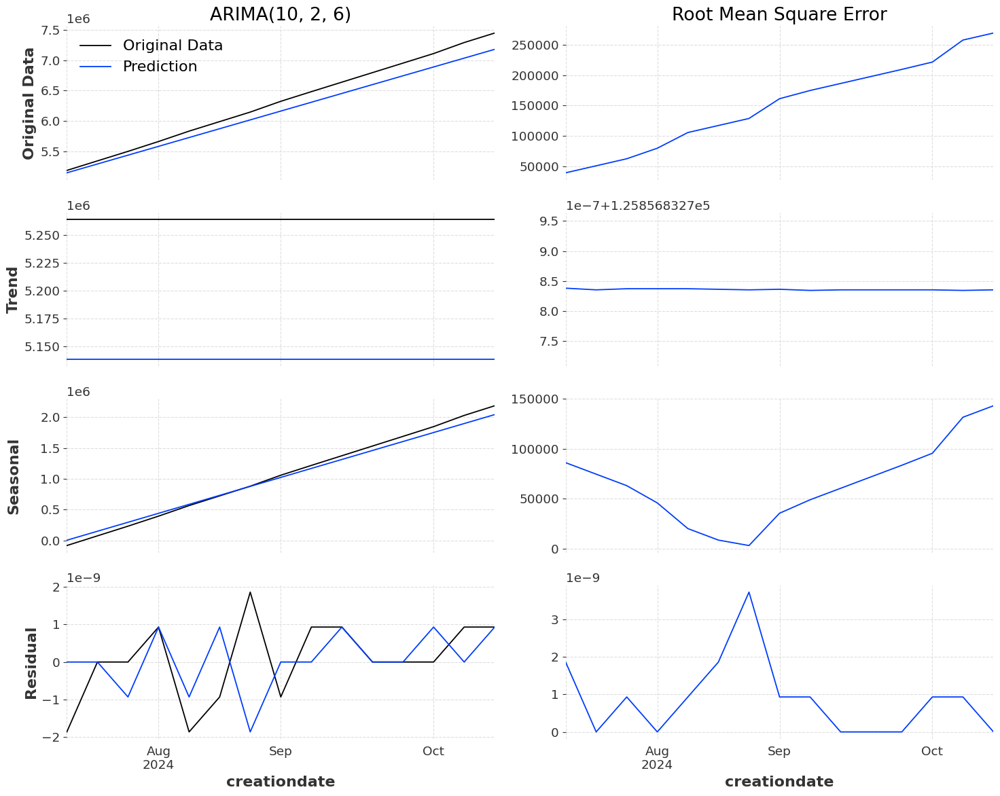

Nilai SMAPE = 232.35%


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'


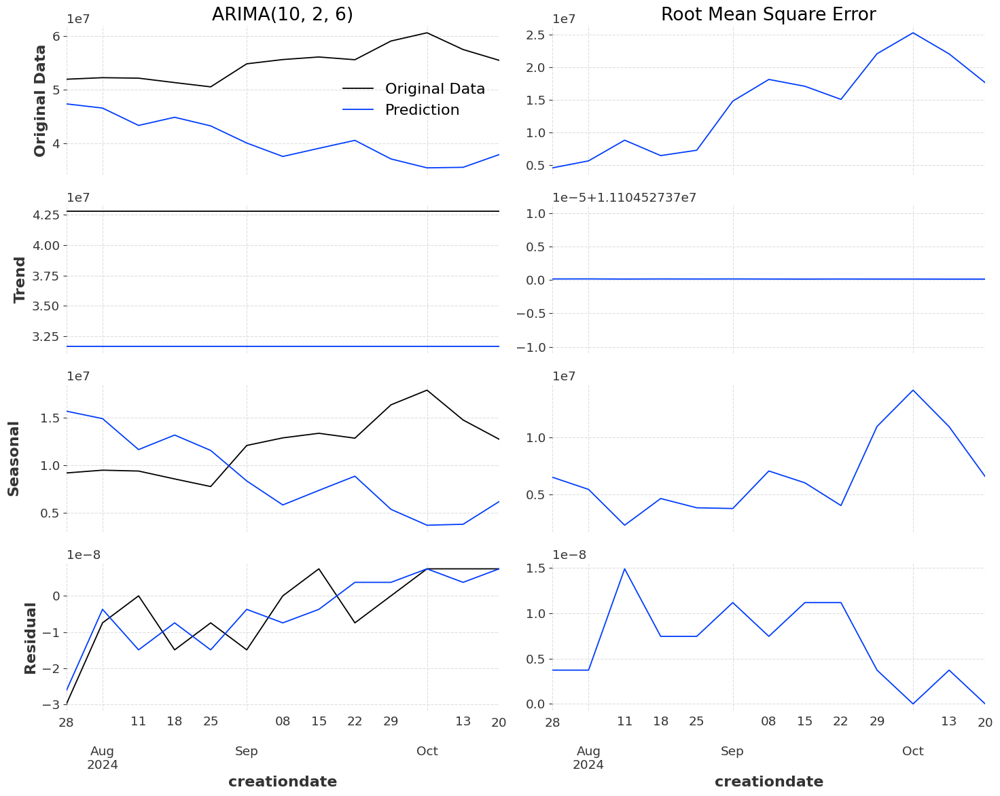

Nilai SMAPE = 2999.13%


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'


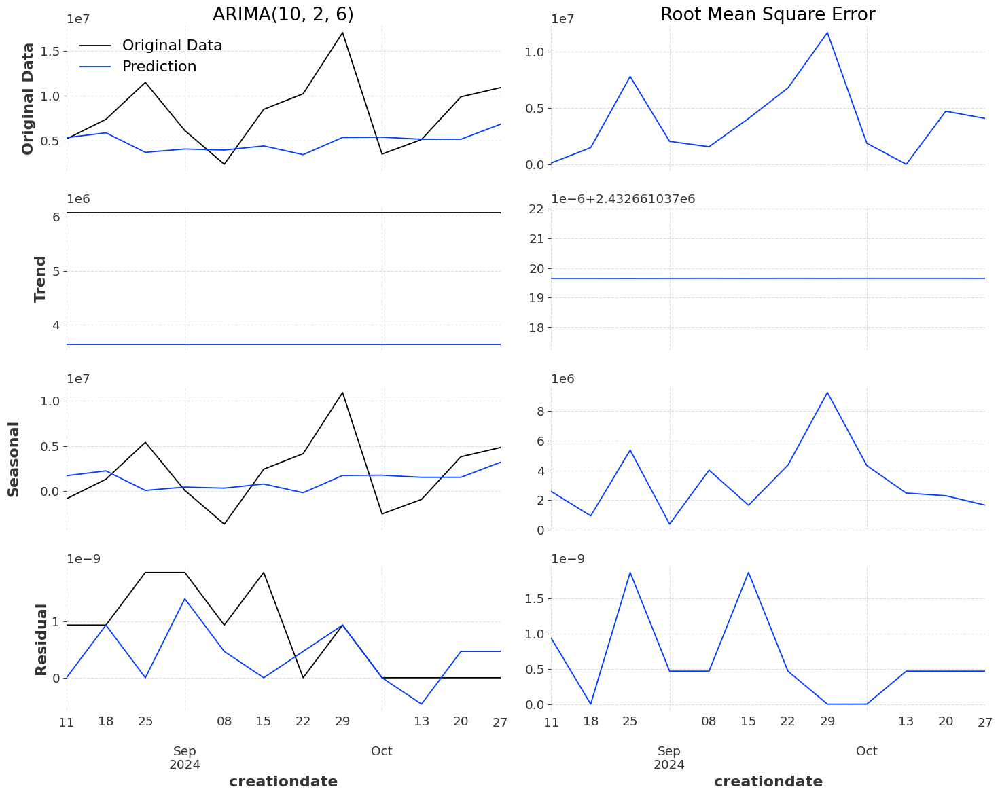

Nilai SMAPE = 5321.85%


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'


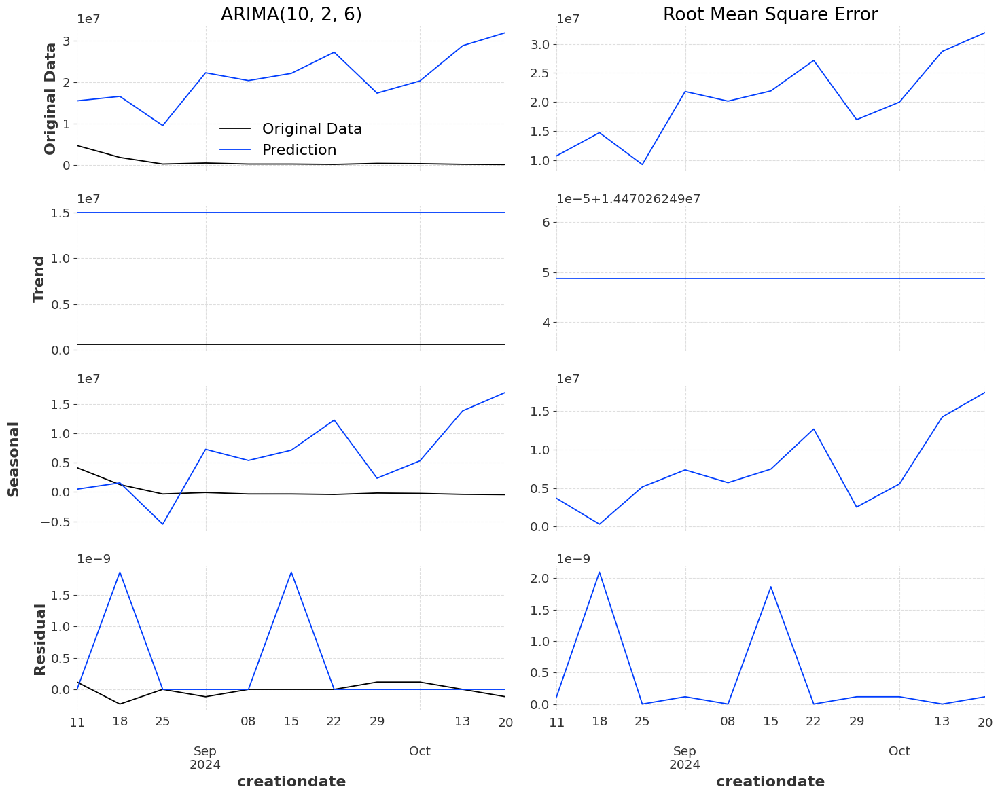

Nilai SMAPE = 18380.81%
Insufficient data for Rekening 2673. Skipping...
Rata-rata SMAPE = 8041.23%


In [265]:
p, d, q = 10, 2, 6
avg_smape = 0
cnt = 0
for rek, df in time_series_dict.items():
  ratio = 0.7
  train_size = int(ratio * len(df))
  test_size  = len(df) - train_size

  train = df.iloc[:train_size]
  test  = df.iloc[train_size:]

  if len(train) <= (p + d + q):
    print(f"Insufficient data for Rekening {rek}. Skipping...")
    continue

  arima = sm.tsa.SARIMAX(train["y"].values,
                        order=(p, d, q)
                        ).fit(maxiter=1000)

  pred_val = arima.forecast(test_size)

  pred_test = pd.Series(pred_val * scale[rek] + min_val[rek],
                        index=test.index)

  fig, ax, bx = my_plot_results(pred_test)

  filename = f'arima_model.{rek}'
  joblib.dump(arima, filename)

  ax[0].set_title(f"ARIMA{(p, d, q)}")
  bx[0].set_title("Root Mean Square Error")
  plt.show()
  gt = TimeSeries.from_values(test['balance'])
  pred = TimeSeries.from_values(pred_test)

  skor = smape(gt, pred)
  print(f"Nilai SMAPE = {skor:.2%}")
  avg_smape += skor
  cnt += 1

print(f"Rata-rata SMAPE = {avg_smape / cnt:.2%}")

In [ ]:
!pip install darts

In [ ]:
df_submission = pd.read_csv("dataTransaksi_PeDaS_2024_Test_Peserta.csv")
df_submission

,trx_code,trx_id,rek_code,rek,creationdate,type,balance
0,233822,371848437,1922,2526,2024-10-21 20:02:14+07:00,NaN,NaN
1,281563,370918907,2346,9437,2024-10-17 08:23:41+07:00,NaN,NaN
2,310541,370287760,2212,5908,2024-10-14 07:44:47+07:00,NaN,NaN
3,37018,370872355,3799,7665,2024-10-16 23:04:24+07:00,NaN,NaN
4,142422,362772092,7868,825,2024-10-01 00:13:21+07:00,NaN,NaN
5,128215,312221200,11465,7639,2024-06-06 18:51:53+07:00,NaN,NaN
6,576302,362740207,2604,13082,2024-10-01 00:11:37+07:00,NaN,NaN
7,316534,371805906,14602,13945,2024-10-21 16:39:36+07:00,NaN,NaN
8,435860,370502689,5614,1207,2024-10-15 09:21:01+07:00,NaN,NaN
9,355943,367221236,10641,8538,2024-10-01 17:24:45+07:00,NaN,NaN


In [ ]:
df_temp = pd.read_csv("dataTransaksi_PeDaS_2024_Train.csv")
df_temp['rek'].unique()

array([ 2526,  9437,  5908,  7665,   825,  7639, 13082, 13945,  1207,
        8538,  6240,  6672,  6228,  9175,  8562, 11071,  2109,   541,
       15414, 15169, 11745, 10694, 11920, 15442, 11284,  2864, 10957,
       15923,  9210,  2673,  7977,  7354,  7638,  1734,  6376])

In [258]:
df_submission['rek'].unique()

array([ 2526,  9437,  5908,  7665,   825,  7639, 13082, 13945,  1207,
        8538,  6240,  6672,  6228,  9175,  8562, 11071,  2109,   541,
       15414, 15169, 11745, 10694, 11920, 15442, 11284,  2864, 10957,
       15923,  9210,  2673,  7977,  7354,  7638,  1734,  6376])

In [259]:
import joblib
import pandas as pd

for i in df_submission['rek'].unique():
  filename = f'arima_model.{i}'
  loaded_model = joblib.load(filename)

  df_submission['creationdate'] = pd.to_datetime(df_submission['creationdate'])
  df_submission = df_submission.set_index('creationdate')

  n_periods = len(df_submission)
  predictions = loaded_model.predict(start=len(train), end=len(train) + n_periods - 1)

  df_submission['balance'] = predictions * scale[i] + min_val[i]
  print(scale[i])

  df_submission = df_submission.reset_index()

  df_submission.to_csv('Mahasigma_submission.csv', index=False)

7476313
5144486
30915696
7935384
13197722
19868740
10369972
17025318
23728694
3626853
3101477
947845
19344992
2299449
8554365
29273419
5258237
5049239
5111412
14990265
331401
7365703
4789460
56122850
4448513
26088589
1264532
22176732
18480761
21025175
2595733
212949
244148
2469145
7108746


In [260]:
df_submission

,creationdate,trx_code,trx_id,rek_code,rek,type,balance
0,2024-10-21 20:02:14+07:00,233822,371848437,1922,2526,NaN,5.154164e+06
1,2024-10-17 08:23:41+07:00,281563,370918907,2346,9437,NaN,4.669130e+06
2,2024-10-14 07:44:47+07:00,310541,370287760,2212,5908,NaN,6.367897e+06
3,2024-10-16 23:04:24+07:00,37018,370872355,3799,7665,NaN,7.079028e+06
4,2024-10-01 00:13:21+07:00,142422,362772092,7868,825,NaN,6.702128e+06
5,2024-06-06 18:51:53+07:00,128215,312221200,11465,7639,NaN,4.370824e+06
6,2024-10-01 00:11:37+07:00,576302,362740207,2604,13082,NaN,4.082631e+06
7,2024-10-21 16:39:36+07:00,316534,371805906,14602,13945,NaN,5.396594e+06
8,2024-10-15 09:21:01+07:00,435860,370502689,5614,1207,NaN,3.138243e+06
9,2024-10-01 17:24:45+07:00,355943,367221236,10641,8538,NaN,4.115680e+05
